### Preprocess Mooring Data 
This notebook is for preprocessing mooring data. This includes correcting velocity for magnetic delcination, despiking data, and renaming variables to be consistent in the data tree 

Useful links for outlier detection methods: 

- https://medium.com/@alex.eslava96/outlier-detection-techniques-for-time-series-9868db2875c2

- https://medium.com/@tubelwj/python-outlier-detection-iqr-method-and-z-score-implementation-8e825edf4b32

- https://towardsdatascience.com/the-ultimate-guide-to-finding-outliers-in-your-time-series-data-part-1-1bf81e09ade4-2/

- https://towardsdatascience.com/how-to-deal-with-time-series-outliers-28b217c7f6c2/



In [1]:
# import packages 
import xarray as xr 
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd 
import glob
from tqdm import tqdm
from scipy import stats 
from scipy.stats import median_abs_deviation
import sys
sys.path.append('/Users/mblan/Documents/research/TNB_tools/TNB_tools')
import magnetic_declination

In [2]:
%matplotlib widget

In [3]:
def summarize_all(dt):
    """Return a DataFrame summarizing the entire DataTree."""
    import pandas as pd
    import numpy as np

    rows = []

    for mooring, mooring_node in dt.children.items():
        for year, year_node in mooring_node.children.items():
            for instrument, instr_node in year_node.children.items():
                for position, pos_node in instr_node.children.items():

                    ds = pos_node.ds

                    if "time" in ds.coords:
                        t = ds["time"].to_numpy()
                        t_start = t[0]
                        t_end = t[-1]
                        dt_med = np.median(np.diff(t)) if len(t) > 1 else np.nan
                    else:
                        t_start = t_end = dt_med = np.nan

                    depth = ds.coords["z"].item() if "z" in ds.coords else np.nan

                    rows.append({
                        "mooring": mooring,
                        "year": year,
                        "instrument": instrument,
                        "position": position,
                        "depth": depth,
                        "variables": list(ds.data_vars),
                        "time_start": t_start,
                        "time_end": t_end,
                        "sampling_period": dt_med,
                        "n_points": ds.sizes.get("time", np.nan),
                    })

    df = pd.DataFrame(rows)
    df = df.sort_values(["mooring", "year", "instrument", "position"])
    return df.reset_index(drop=True)


In [4]:
def plot_timeseries(years,var,mooring,instrument,position,color,label):
    """
    inputs:
    years: years to loop over (array containing years in string format)
    var: variable of interest (string)
    mooring: mooring of interest (string)
    instrument: instrument of interest (string)
    position: position of interest (string)
    color: color to use for line plotting (string)
    """
    for i in range(len(years)):
        var = var
        ds = dt[mooring][years[i]][instrument][position]
        if var in ds.data_vars:
            ds[var].plot(color=color,label=label)

### Load Mooring D data 

In [5]:
# loop through all folders and print paths for netcdf files 
folders = glob.glob("//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D/*")
files = []
for folder in tqdm(folders):
    print(folder)
    files.append(glob.glob(folder+'/*.nc'))

100%|██████████| 10/10 [00:00<00:00, 72.96it/s]

//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2014_2016
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2016_2017
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2017_2019
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2019_2020
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2020_2021
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2021_2022
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2022_2023
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2023_2024
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\D_2024_2025
//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\Info_Data.docx


In [6]:
# remove first entry which is not a folder with data 
mooring_d_files = files[:-1]

In [7]:
mooring_d_files[0]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_rcm7_11199_539m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_rcm7_11566_875m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_sbe16_1433_509m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_sbe16_1437_1069m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_sbe39_1211_966m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_sbe39_1214_739m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2014_2016\\D_2014_seaguard_444_1112m.nc']

In [8]:
D_2014_vel_top = xr.open_dataset(mooring_d_files[0][0])
D_2014_vel_mid = xr.open_dataset(mooring_d_files[0][1])
D_2014_vel_bot = xr.open_dataset(mooring_d_files[0][6])
D_2014_ctd_top = xr.open_dataset(mooring_d_files[0][2])
D_2014_temp_mid1 = xr.open_dataset(mooring_d_files[0][5])
D_2014_temp_mid2 = xr.open_dataset(mooring_d_files[0][4])
D_2014_ctd_bot = xr.open_dataset(mooring_d_files[0][3])

In [9]:
# drop depth from dimension and add lat/lon to coordinates 
D_2014_vel_top = D_2014_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_vel_mid = D_2014_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_vel_bot = D_2014_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_ctd_top = D_2014_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_temp_mid1 = D_2014_temp_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_temp_mid2 = D_2014_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})
D_2014_ctd_bot = D_2014_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13573,'lon':164.551})

In [10]:
mooring_d_files[1]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_RCM_11199_553_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_RCM_11565_885_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_RCM_444_1109_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_SBE16_1433_523_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_SBE37_12516_1060_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_SBE39_1211_888_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2016_2017\\D_2016_SBE39_1214_749m.nc']

In [11]:
D_2016_vel_top = xr.open_dataset(mooring_d_files[1][0])
D_2016_vel_mid = xr.open_dataset(mooring_d_files[1][1])
D_2016_vel_bot = xr.open_dataset(mooring_d_files[1][2])
D_2016_ctd_top = xr.open_dataset(mooring_d_files[1][3])
D_2016_temp_mid1 = xr.open_dataset(mooring_d_files[1][6])
D_2016_temp_mid2 = xr.open_dataset(mooring_d_files[1][5])
D_2016_ctd_bot = xr.open_dataset(mooring_d_files[1][4])

In [12]:
# drop depth from dimension and add lat/lon to coordinates 
D_2016_vel_top = D_2016_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_vel_mid = D_2016_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_vel_bot = D_2016_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_ctd_top = D_2016_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_temp_mid1 = D_2016_temp_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_temp_mid2 = D_2016_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})
D_2016_ctd_bot = D_2016_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13587,'lon':164.5549})

In [13]:
mooring_d_files[2]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_RCM7_11199_576_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_SBE16_1433_556_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_SBE37_15450_1086_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_SBE37_15451_772_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_SBE39_30492_996_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_seaguard_1847_911_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2017_2019\\D_2017_seaguard_444_1135_m.nc']

In [14]:
D_2017_vel_top = xr.open_dataset(mooring_d_files[2][0])
D_2017_vel_mid = xr.open_dataset(mooring_d_files[2][5])
D_2017_vel_bot = xr.open_dataset(mooring_d_files[2][6])
D_2017_ctd_top = xr.open_dataset(mooring_d_files[2][1])
D_2017_ctd_mid1 = xr.open_dataset(mooring_d_files[2][3])
D_2017_temp_mid2 = xr.open_dataset(mooring_d_files[2][4])
D_2017_ctd_bot = xr.open_dataset(mooring_d_files[2][2])

In [15]:
D_2017_vel_top = D_2017_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_vel_mid = D_2017_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_vel_bot = D_2017_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_ctd_top = D_2017_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_ctd_mid1 = D_2017_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_temp_mid2 = D_2017_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})
D_2017_ctd_bot = D_2017_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.13611,'lon':164.58958})

In [16]:
mooring_d_files[3]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_RCM7_11199_594_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_SBE16_1433_574_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_SBE37_10752_766_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_SBE37_15451_1087_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_SBE39_1210_1014_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_seaguard_1847_929_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2019_2020\\D_2019_seaguard_444_1135_m.nc']

In [17]:
D_2019_vel_top = xr.open_dataset(mooring_d_files[3][0])
D_2019_vel_mid = xr.open_dataset(mooring_d_files[3][5])
D_2019_vel_bot = xr.open_dataset(mooring_d_files[3][6])
D_2019_ctd_top = xr.open_dataset(mooring_d_files[3][1])
D_2019_ctd_mid1 = xr.open_dataset(mooring_d_files[3][2])
D_2019_temp_mid2 = xr.open_dataset(mooring_d_files[3][4])
D_2019_ctd_bot = xr.open_dataset(mooring_d_files[3][3])

In [18]:
D_2019_vel_top = D_2019_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_vel_mid = D_2019_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_vel_bot = D_2019_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_ctd_top = D_2019_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_ctd_mid1 = D_2019_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_temp_mid2 = D_2019_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})
D_2019_ctd_bot = D_2019_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.07661,'lon':164.72989})

In [19]:
mooring_d_files[4]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2020_2021\\D_2020_sbe37_10752_612m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2020_2021\\D_2020_sbe37_15451_922m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2020_2021\\D_2020_sbe39_1210_837m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2020_2021\\D_2020_seaguard_1516_975m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2020_2021\\D_2020_seaguard_1847_751m.nc']

In [20]:
D_2020_vel_top = xr.open_dataset(mooring_d_files[4][4])
D_2020_vel_mid = xr.open_dataset(mooring_d_files[4][3])
# D_2020_2021_vel_bot = xr.open_dataset(mooring_d_files[4][3])
D_2020_ctd_top = xr.open_dataset(mooring_d_files[4][0])
D_2020_temp_mid1 = xr.open_dataset(mooring_d_files[4][2])
D_2020_ctd_mid2 = xr.open_dataset(mooring_d_files[4][1])
# D_2020_2021_sbe_bot = xr.open_dataset(mooring_d_files[4][1])

In [21]:
D_2020_vel_top = D_2020_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2020_vel_mid = D_2020_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2020_ctd_top = D_2020_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2020_temp_mid1 = D_2020_temp_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2020_ctd_mid2 = D_2020_ctd_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})

In [22]:
mooring_d_files[5]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_sbe16_1433_543m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_sbe37_10752_759m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_sbe37_15451_1073m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_sbe39_1210_984m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_seaguard_1516_1122m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_seaguard_1847_898m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2021_2022\\D_2021_seaguard_1978_564m.nc']

In [23]:
D_2021_vel_top = xr.open_dataset(mooring_d_files[5][6])
D_2021_vel_mid = xr.open_dataset(mooring_d_files[5][5])
D_2021_vel_bot = xr.open_dataset(mooring_d_files[5][4])
D_2021_ctd_top = xr.open_dataset(mooring_d_files[5][0])
D_2021_ctd_mid1 = xr.open_dataset(mooring_d_files[5][1])
D_2021_temp_mid2 = xr.open_dataset(mooring_d_files[5][3])
D_2021_ctd_bot = xr.open_dataset(mooring_d_files[5][2])

In [24]:
D_2021_vel_top = D_2021_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_vel_mid = D_2021_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_vel_bot = D_2021_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_ctd_top = D_2021_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_ctd_mid1 = D_2021_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_temp_mid2 = D_2021_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})
D_2021_ctd_bot = D_2021_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1237,'lon':164.95062})

In [25]:
mooring_d_files[6]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2022_2023\\D_2022_sbe37_10752_745m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2022_2023\\D_2022_sbe37_15451_526m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2022_2023\\D_2022_sbe39_1210_971.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2022_2023\\D_2022_seaguard_1516_547m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2022_2023\\D_2022_seaguard_1847_882m.nc']

In [26]:
D_2022_vel_top = xr.open_dataset(mooring_d_files[6][3])
D_2022_vel_mid = xr.open_dataset(mooring_d_files[6][4])
# D_2022_2023_vel_bot = xr.open_dataset(mooring_d_files[6][4])
D_2022_ctd_top = xr.open_dataset(mooring_d_files[6][1])
D_2022_ctd_mid1 = xr.open_dataset(mooring_d_files[6][0])
D_2022_temp_mid2 = xr.open_dataset(mooring_d_files[6][2])
# D_2022_2023_sbe_bot = xr.open_dataset(mooring_d_files[6][2])

In [27]:
D_2022_vel_top = D_2022_vel_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1274,'lon':164.9707})
D_2022_vel_mid = D_2022_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1274,'lon':164.9707})
D_2022_ctd_top = D_2022_ctd_top.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1274,'lon':164.9707})
D_2022_ctd_mid1 = D_2022_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1274,'lon':164.9707})
D_2022_temp_mid2 = D_2022_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1274,'lon':164.9707})

In [28]:
mooring_d_files[7]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2023_2024\\D_2023_sbe37_10752_1200m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2023_2024\\D_2023_sbe37_15451_926m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2023_2024\\D_2023_sbe39_1210_1163m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2023_2024\\D_2023_seaguard_1516_927.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2023_2024\\D_2023_seaguard_1847_1201m.nc']

In [29]:
# D_2023_2024_vel_top = xr.open_dataset(mooring_d_files[6][3])
D_2023_vel_mid = xr.open_dataset(mooring_d_files[7][3])
D_2023_vel_bot = xr.open_dataset(mooring_d_files[7][4])
# D_2023_2024_sbe_top = xr.open_dataset(mooring_d_files[6][1])
D_2023_ctd_mid1 = xr.open_dataset(mooring_d_files[7][1])
D_2023_temp_mid2 = xr.open_dataset(mooring_d_files[7][2])
D_2023_ctd_bot = xr.open_dataset(mooring_d_files[7][0])

In [30]:
D_2023_vel_mid = D_2023_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1667,'lon':164.5976})
D_2023_vel_bot = D_2023_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1667,'lon':164.5976})
D_2023_ctd_mid1 = D_2023_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1667,'lon':164.5976})
D_2023_temp_mid2 = D_2023_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1667,'lon':164.5976})
D_2023_ctd_bot = D_2023_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.1667,'lon':164.5976})

In [31]:
mooring_d_files[8]

['//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2024_2025\\D_2024_SBE37_10752_1176_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2024_2025\\D_2024_SBE37_15451_898_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2024_2025\\D_2024_SBE39_1210_1162_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2024_2025\\D_2024_Seaguard_1516_925_m.nc',
 '//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/Mooring_D\\D_2024_2025\\D_2024_Seaguard_1847_1200_m.nc']

In [32]:
# D_2024_2025_vel_top = xr.open_dataset(mooring_d_files[8][3])
D_2024_vel_mid = xr.open_dataset(mooring_d_files[8][3])
D_2024_vel_bot = xr.open_dataset(mooring_d_files[8][4])
# D_2024_2025_sbe_top = xr.open_dataset(mooring_d_files[8][1])
D_2024_ctd_mid1 = xr.open_dataset(mooring_d_files[8][1])
D_2024_temp_mid2 = xr.open_dataset(mooring_d_files[8][2])
D_2024_ctd_bot = xr.open_dataset(mooring_d_files[8][0])

In [33]:
D_2024_vel_mid = D_2024_vel_mid.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.166711,'lon':164.597667})
D_2024_vel_bot = D_2024_vel_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.166711,'lon':164.597667})
D_2024_ctd_mid1 = D_2024_ctd_mid1.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.166711,'lon':164.597667})
D_2024_temp_mid2 = D_2024_temp_mid2.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.166711,'lon':164.597667})
D_2024_ctd_bot = D_2024_ctd_bot.rename({'depth':'z'}).squeeze().assign_coords({'lat':-75.166711,'lon':164.597667})

In [34]:
# loop through and add all dataset to the datatree 
# make list of all datasets to loop through 
D_datasets = [
    D_2014_vel_top,
    D_2014_vel_mid,
    D_2014_vel_bot,
    D_2014_ctd_top,
    D_2014_temp_mid1,
    D_2014_temp_mid2,
    D_2014_ctd_bot,
    D_2016_vel_top,
    D_2016_vel_mid,
    D_2016_vel_bot,
    D_2016_ctd_top,
    D_2016_temp_mid1,
    D_2016_temp_mid2,
    D_2016_ctd_bot,
    D_2017_vel_top,
    D_2017_vel_mid,
    D_2017_vel_bot,
    D_2017_ctd_top,
    D_2017_ctd_mid1,
    D_2017_temp_mid2,
    D_2017_ctd_bot,
    D_2019_vel_top,
    D_2019_vel_mid,
    D_2019_vel_bot,
    D_2019_ctd_top,
    D_2019_ctd_mid1,
    D_2019_temp_mid2,
    D_2019_ctd_bot,
    D_2020_vel_top,
    D_2020_vel_mid,
    D_2020_ctd_top,
    D_2020_temp_mid1,
    D_2020_ctd_mid2,
    D_2021_vel_top,
    D_2021_vel_mid,
    D_2021_vel_bot,
    D_2021_ctd_top,
    D_2021_ctd_mid1,
    D_2021_temp_mid2,
    D_2021_ctd_bot,
    D_2022_vel_top,
    D_2022_vel_mid,
    D_2022_ctd_top,
    D_2022_ctd_mid1,
    D_2022_temp_mid2,
    D_2023_vel_mid,
    D_2023_vel_bot,
    D_2023_ctd_mid1,
    D_2023_temp_mid2,
    D_2023_ctd_bot,
    D_2024_vel_mid,
    D_2024_vel_bot,
    D_2024_ctd_mid1,
    D_2024_temp_mid2,
    D_2024_ctd_bot
]

In [35]:
# loop through and add all dataset to the datatree 
# make list of all datasets to loop through 
dataset_names = [
    'D_2014_vel_top',
    'D_2014_vel_mid',
    'D_2014_vel_bot',
    'D_2014_ctd_top',
    'D_2014_temp_mid1',
    'D_2014_temp_mid2',
    'D_2014_ctd_bot',
    'D_2016_vel_top',
    'D_2016_vel_mid',
    'D_2016_vel_bot',
    'D_2016_ctd_top',
    'D_2016_temp_mid1',
    'D_2016_temp_mid2',
    'D_2016_ctd_bot',
    'D_2017_vel_top',
    'D_2017_vel_mid',
    'D_2017_vel_bot',
    'D_2017_ctd_top',
    'D_2017_ctd_mid1',
    'D_2017_temp_mid2',
    'D_2017_ctd_bot',
    'D_2019_vel_top',
    'D_2019_vel_mid',
    'D_2019_vel_bot',
    'D_2019_ctd_top',
    'D_2019_ctd_mid1',
    'D_2019_temp_mid2',
    'D_2019_ctd_bot',
    'D_2020_vel_top',
    'D_2020_vel_mid',
    'D_2020_ctd_top',
    'D_2020_temp_mid1',
    'D_2020_ctd_mid2',
    'D_2021_vel_top',
    'D_2021_vel_mid',
    'D_2021_vel_bot',
    'D_2021_ctd_top',
    'D_2021_ctd_mid1',
    'D_2021_temp_mid2',
    'D_2021_ctd_bot',
    'D_2022_vel_top',
    'D_2022_vel_mid',
    'D_2022_ctd_top',
    'D_2022_ctd_mid1',
    'D_2022_temp_mid2',
    'D_2023_vel_mid',
    'D_2023_vel_bot',
    'D_2023_ctd_mid1',
    'D_2023_temp_mid2',
    'D_2023_ctd_bot',
    'D_2024_vel_mid',
    'D_2024_vel_bot',
    'D_2024_ctd_mid1',
    'D_2024_temp_mid2',
    'D_2024_ctd_bot'
]

In [36]:
# investigate renaming variables 

D_2014_ctd_bot

<xarray.Dataset> Size: 2MB
Dimensions:  (time: 35528)
Coordinates:
  * time     (time) datetime64[ns] 284kB 2014-01-22T13:30:00 ... 2016-02-01T1...
    z        int64 8B -1069
    lat      float64 8B -75.14
    lon      float64 8B 164.6
Data variables:
    T_0      (time) float64 284kB ...
    S_0      (time) float64 284kB ...
    S_1      (time) float64 284kB ...
    S_2      (time) float64 284kB ...
    T_2      (time) float64 284kB ...
Attributes: (12/14)
    cruise_deployment:               PNRA - XXVII Expedition - 2013/14
    cruise_recovery:                 PNRA - XXVII Expedition - 2015/16
    water_depth_meters:              -1117
    instr_depth_meters:              -1069
    instr_type:                      SEACAT SBE16 
    instr_sn:                        1437
    ...                              ...
    samp_int_minutes:                30
    start_time:                      22/01/2014  13:30:00
    stop_time:                       01/02/2016  17:00:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

### Using previous datatree 

In [37]:
# load datatree 
dt = xr.open_datatree('TNB_mooring_datatree_12112025.nc')

In [38]:
df = summarize_all(dt)

In [39]:
df.query("mooring == 'LDEO'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
214,LDEO,2017,vel,bot,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 08:15:00,0 days 00:15:00,38094.0
215,LDEO,2017,vel,mid,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 08:15:00,0 days 00:15:00,38098.0
216,LDEO,2017,vel,top,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 10:45:00,0 days 00:15:00,38108.0


### Preliminary Analysis: Make Plots of Each Variable

#### Data tables to get quick look at data 

In [40]:
df.query("mooring == 'D' & position == 'top' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
10,D,1998,ctd,top,-566,"[S_0, T_0, S_1]",1997-12-10 15:00:00,1999-01-14 12:30:00,0 days 00:30:00,19196.0
15,D,1999,ctd,top,-546,"[S_0, T_0, S_1]",1999-01-17 22:30:00,2000-01-16 14:30:00,0 days 00:30:00,17457.0
22,D,2000,ctd,top,-526,"[S_0, T_0, S_1, S_2]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
54,D,2010,ctd,top,-463,"[S_0, T_0, T_1, S_1, S_2]",2010-02-06 02:55:00,2012-01-23 14:25:00,0 days 00:30:00,34392.0
61,D,2012,ctd,top,-509,"[T_0, S_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 15:00:00,0 days 00:30:00,34066.0
66,D,2014,ctd,top,-509,"[S_0, T_0, S_2, S_1, T_2]",2014-01-22 00:00:00,2016-01-31 10:00:00,0 days 00:30:00,35493.0
73,D,2016,ctd,top,-523,"[Theta_0, S_0, Conductivity]",2016-02-06 22:05:00,2016-09-14 21:45:00,0 days 00:05:00,63645.0
81,D,2017,ctd,top,-556,"[T_0, S_0, Conductivity, S_2, T_2]",2017-02-11 07:00:00,2019-02-18 23:00:00,0 days 00:30:00,35409.0
88,D,2019,ctd,top,-574,"[T_0, S_0, Theta_0, Turbidity, S_2, T_2]",2019-02-19 17:45:00,2020-01-30 01:45:00,0 days 00:30:00,16529.0
94,D,2020,ctd,top,-612.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 14:22:00,2021-01-07 22:22:00,0 days 00:30:00,16385.0


In [41]:
df.query("mooring == 'D' & position == 'mid2'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
53,D,2010,ctd,mid2,-950,[T_0],2010-02-06 02:23:00,2012-01-23 15:18:00,0 days 00:05:00,206364.0
60,D,2012,ctd,mid2,-966,[T_0],2012-02-01 22:30:00,2014-01-11 15:00:00,0 days 00:10:00,102196.0
68,D,2014,temp,mid2,-966,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
75,D,2016,temp,mid2,-888,"[T_0, T_2]",2016-02-06 22:10:00,2017-01-08 21:10:00,0 days 00:10:00,48523.0
82,D,2017,temp,mid2,-996,"[T_0, T_2]",2017-02-11 07:15:20,2019-02-18 23:15:20,0 days 00:30:00,35409.0
89,D,2019,temp,mid2,-1014,"[T_0, T_2]",2019-02-19 19:00:00,2020-01-30 02:30:00,0 days 00:30:00,16528.0
93,D,2020,ctd,mid2,-922,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 13:29:00,2021-01-07 21:29:00,0 days 00:30:00,16385.0
101,D,2021,temp,mid2,-984.5,"[T_0, T_2]",2021-01-15 22:24:00,2022-01-24 21:54:00,0 days 00:30:00,17952.0
107,D,2022,temp,mid2,-971.5,"[T_0, T_2]",2022-02-01 04:40:00,2023-01-25 07:10:00,0 days 00:30:00,17190.0
112,D,2023,temp,mid2,-1163.5,"[T_0, T_2]",2023-02-03 05:30:00,2024-01-24 19:30:00,0 days 00:30:00,17069.0


In [42]:
df.query("mooring == 'D' & position == 'mid1'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
0,D,1995,ctd,mid1,-756,"[S_0, T_0, S_1]",1995-02-17 17:00:00,1996-01-14 06:30:00,0 days 00:30:00,15868.0
2,D,1995,vel,mid1,-756,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1995-02-17 17:00:00,1996-01-14 07:00:00,0 days 00:30:00,15869.0
4,D,1996,ctd,mid1,-836,"[S_0, T_0, S_1, S_2]",1996-02-02 01:00:00,1997-12-08 02:00:00,0 days 00:30:00,32403.0
6,D,1996,vel,mid1,-835,"[U_0, V_0, T_0, AWT_0, U_1, V_1, T_1, AWT_1, M...",1996-02-02 01:00:00,1997-07-04 05:00:00,0 days 00:30:00,24873.0
11,D,1998,vel,mid1,-766,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1997-12-10 15:00:00,1999-01-14 12:30:00,0 days 00:30:00,19196.0
17,D,1999,vel,mid1,-746,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1999-01-17 22:30:00,2000-01-16 14:30:00,0 days 00:30:00,17457.0
20,D,2000,ctd,mid1,-823,"[S_0, T_0, S_1, S_2]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
24,D,2000,vel,mid1,-724,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
27,D,2001,ctd,mid1,-820,"[S_0, T_0, S_1, S_2]",2001-01-18 06:00:00,2002-01-31 07:30:00,0 days 00:30:00,18148.0
29,D,2001,vel,mid1,-722,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",2001-01-18 06:00:00,2002-01-31 07:30:00,0 days 00:30:00,18148.0


In [43]:
df.query("mooring == 'D' & position == 'bot'& instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
48,D,2008,ctd,bot,-1062,"[T_0, S_0, Turb_0, Tpot_0, T_1, S_1, Turb_1, T...",2008-01-31 02:50:54,2010-02-03 10:20:54,0 days 00:30:00,35248.0
51,D,2010,ctd,bot,-1036,"[T_0, S_0, S_1, T_1, S_2]",2010-02-06 02:34:00,2012-01-23 15:04:00,0 days 00:30:00,34394.0
58,D,2012,ctd,bot,-1069,"[S_0, T_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 14:30:00,0 days 00:30:00,34065.0
65,D,2014,ctd,bot,-1069,"[T_0, S_0, S_1, S_2, T_2]",2014-01-22 13:30:00,2016-02-01 17:00:00,0 days 00:30:00,35528.0
72,D,2016,ctd,bot,-1060,"[Theta_0, S_0, Conductivity]",2016-02-06 22:02:00,2016-05-28 07:47:00,0 days 00:05:00,32086.0
79,D,2017,ctd,bot,-1086,"[T_0, S_0, Conductivity, Theta_0, Oxygen, Dept...",2017-02-11 07:35:00,2017-09-17 03:05:00,0 days 00:30:00,10456.0
86,D,2019,ctd,bot,-1130,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 16:00:00,2020-01-30 01:00:00,0 days 00:30:00,16531.0
98,D,2021,ctd,bot,-1073.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 21:59:00,2022-01-24 21:29:00,0 days 00:30:00,17952.0
110,D,2023,ctd,bot,-1200.5,"[T_0, S_0, S_2, T_2]",2023-02-03 08:45:00,2024-01-24 22:45:00,0 days 00:30:00,17069.0
115,D,2024,ctd,bot,-1176,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 10:07:56,2025-02-08 05:07:56,0 days 00:30:00,18231.0


In [44]:
df.query("mooring == 'D' & instrument == 'vel'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
2,D,1995,vel,mid1,-756,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1995-02-17 17:00:00,1996-01-14 07:00:00,0 days 00:30:00,15869.0
3,D,1995,vel,shal,-59,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1995-02-17 17:00:00,1996-01-14 07:00:00,0 days 00:30:00,15869.0
6,D,1996,vel,mid1,-835,"[U_0, V_0, T_0, AWT_0, U_1, V_1, T_1, AWT_1, M...",1996-02-02 01:00:00,1997-07-04 05:00:00,0 days 00:30:00,24873.0
7,D,1996,vel,shal,-141,"[U_0, V_0, T_0, Mod_0, Dir_0]",1996-02-02 01:00:00,1997-11-03 05:00:00,0 days 00:30:00,30729.0
8,D,1996,vel,top,-586,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1996-02-02 01:00:00,1997-12-08 02:00:00,0 days 00:30:00,32403.0
...,...,...,...,...,...,...,...,...,...,...
109,D,2022,vel,top,-547.1,"[U_0, V_0, Mod_0, Dir_0, TiltX, TiltY, Heading...",2022-02-01 04:50:00,2023-01-25 07:20:00,0 days 00:30:00,17190.0
113,D,2023,vel,bot,-1201.5,"[U_0, V_0, Mod_0, Dir_0, T_0, TiltX, TiltY, He...",2023-02-03 05:30:00,2024-01-24 19:30:00,0 days 00:30:00,17069.0
114,D,2023,vel,mid,-927.5,"[U_0, V_0, Mod_0, Dir_0, TiltX, TiltY, Heading...",2023-02-03 05:30:00,2024-01-24 19:30:00,0 days 00:30:00,17069.0
118,D,2024,vel,bot,1200,"[U_0, V_0, Mod_0, Dir_0, Pitch, Roll, Temperat...",2024-01-25 10:00:00,2025-02-08 05:00:00,0 days 00:30:00,18231.0


#### Salinity 

In [144]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()

In [145]:
years

array(['1998', '1999', '2000', '2010', '2012', '2014', '2016', '2017',
       '2019', '2020', '2021', '2022'], dtype=object)

In [146]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['depth'].unique()

array([-566, -546, -526, -463, -509, '-523', '-556', '-574', '-612.8',
       '-543.6', '-526.1'], dtype=object)

Text(0.5, 0.98, 'Salinity at Mooring D Top Sensor')

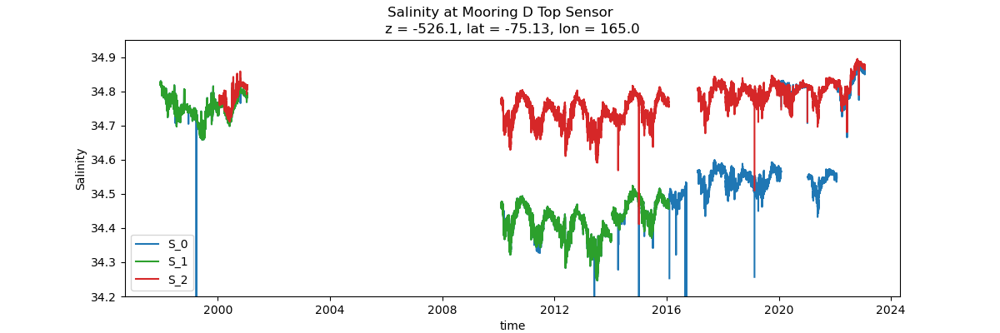

In [147]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='top',color='tab:blue',label='S_0')
plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='top',color='tab:green',label='S_1')
plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='top',color='tab:red',label='S_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(34.2,34.95)
plt.ylabel('Salinity')
plt.suptitle('Salinity at Mooring D Top Sensor')

In [148]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()

array(['1995', '1996', '2000', '2001', '2003', '2004', '2005', '2006',
       '2010', '2012', '2017', '2019', '2021', '2022', '2023', '2024'],
      dtype=object)

In [149]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['depth'].unique()

array([-756, -836, -823, -820, -818, -973, -694, -739, '-772', '-790',
       '-759.8', '-745.8', '-926.5', '-898'], dtype=object)

In [150]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['year'].unique()

array(['2010', '2012', '2020'], dtype=object)

In [151]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['depth'].unique()

array([-950, -966, '-922'], dtype=object)

Text(0.5, 0.98, 'Salinity at Mooring D Mid1 Sensor')

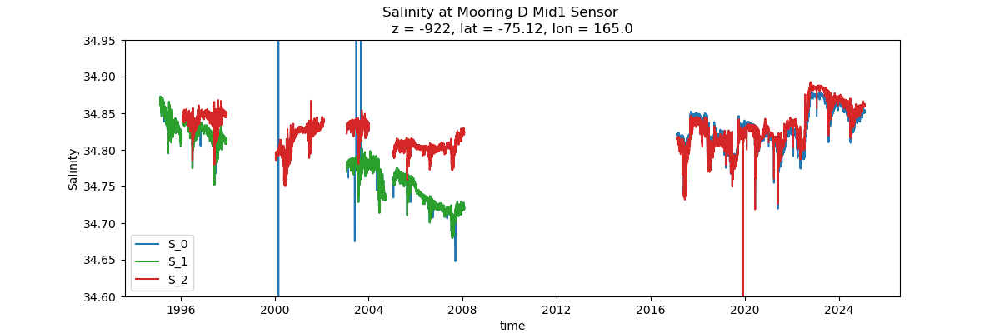

In [152]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='mid1',color='tab:blue',label='S_0')
plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='mid1',color='tab:green',label='S_1')
plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='mid1',color='tab:red',label='S_2')

# year 2020 has ctd at mid 2 at ~922 meters, plotting here to complete the time series 
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['year'].unique()
plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='mid2',color='tab:blue',label='S_0')
plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='mid2',color='tab:green',label='S_1')
plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='mid2',color='tab:red',label='S_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(34.6,34.95)
plt.ylabel('Salinity')
plt.suptitle('Salinity at Mooring D Mid1 Sensor')

In [153]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['year'].unique()

array(['2008', '2010', '2012', '2014', '2016', '2017', '2019', '2021',
       '2023', '2024'], dtype=object)

In [154]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['depth'].unique()

array([-1062, -1036, -1069, '-1060', '-1086', '-1130', '-1073.5',
       '-1200.5', '-1176'], dtype=object)

Text(0.5, 0.98, 'Salinity at Mooring D Bot Sensor')

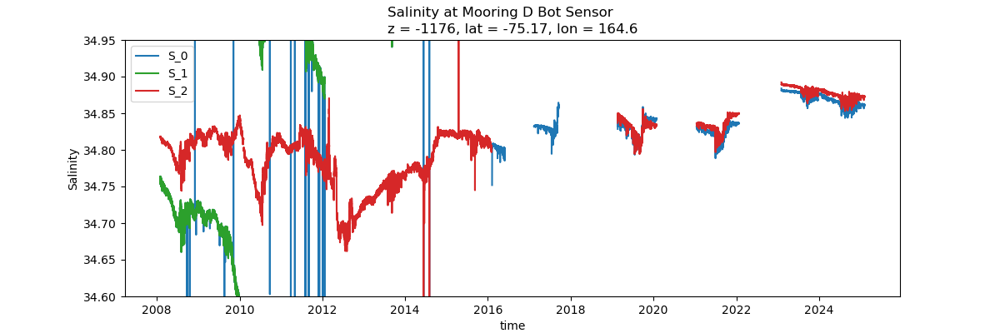

In [155]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='bot',color='tab:blue',label='S_0')
plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='bot',color='tab:green',label='S_1')
plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='bot',color='tab:red',label='S_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(34.6,34.95)
plt.ylabel('Salinity')
plt.suptitle('Salinity at Mooring D Bot Sensor')

##### Comments 

Level 0 and 2 are available. I should ues level 2 when availabe as this is corrected for CTD cast at mooring depoloyment and recovery. Level 2 is not despiked and there are definitely some suspect spikes that should likely be removed. Need to despike level 2 data and rename to sal (this will be final product that I use for analysis). Note that there is a lot of missing data at bottom sensor 


#### Temperature

In [137]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()

array(['1998', '1999', '2000', '2010', '2012', '2014', '2016', '2017',
       '2019', '2020', '2021', '2022'], dtype=object)

In [138]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['depth'].unique()

array([-566, -546, -526, -463, -509, '-523', '-556', '-574', '-612.8',
       '-543.6', '-526.1'], dtype=object)

Text(0.5, 0.98, 'Temp at Mooring D Top Sensor')

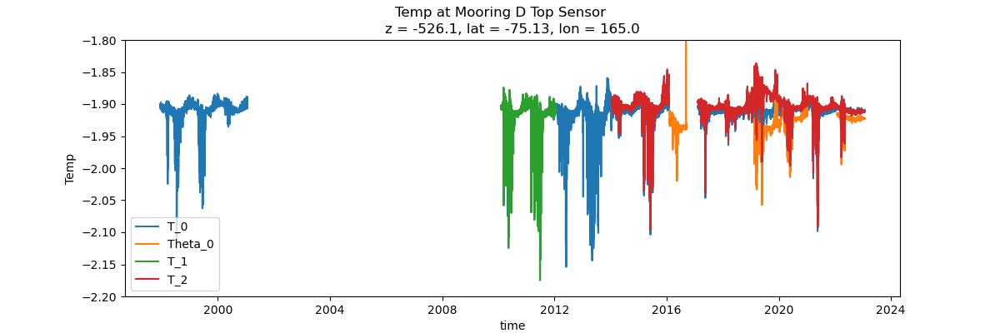

In [139]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='top',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='top',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='ctd',position='top',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='top',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2.2,-1.8)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D Top Sensor')

Text(0.5, 0.98, 'Temp at Mooring D mid1 Sensor')

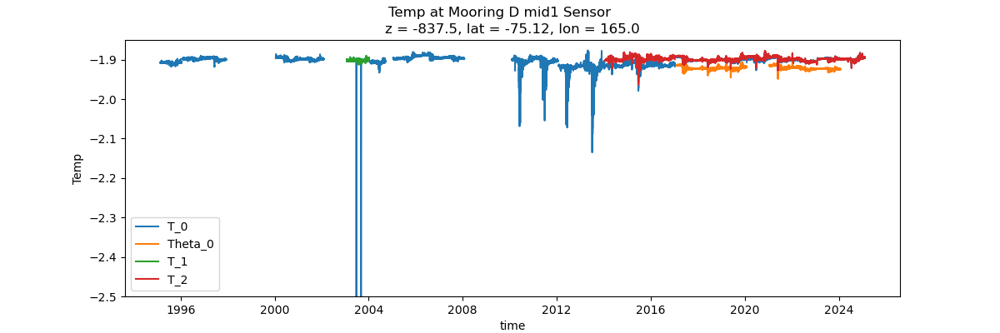

In [140]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='mid1',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='mid1',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='ctd',position='mid1',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='mid1',color='tab:red',label='T_2')

# account for temp collected by thermistors, not ctds 
years = df.query("mooring == 'D' & instrument == 'temp' & position == 'mid1'")['year'].unique()
plot_timeseries(years=years,var='T_0',mooring='D',instrument='temp',position='mid1',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='temp',position='mid1',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='temp',position='mid1',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='temp',position='mid1',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2.5,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D mid1 Sensor')

C:\Users\mblan\AppData\Local\Temp\ipykernel_19364\3811694169.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12,4))


Text(0.5, 0.98, 'Temp at Mooring D mid2 Sensor')

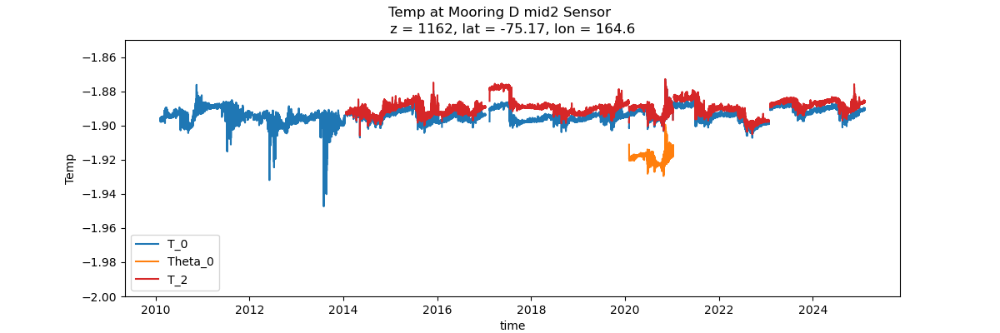

In [141]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='mid2',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='mid2',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='ctd',position='mid2',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='mid2',color='tab:red',label='T_2')

# account for temp collected by thermistors, not ctds 
years = df.query("mooring == 'D' & instrument == 'temp' & position == 'mid2'")['year'].unique()
plot_timeseries(years=years,var='T_0',mooring='D',instrument='temp',position='mid2',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='temp',position='mid2',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='temp',position='mid2',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='temp',position='mid2',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D mid2 Sensor')

Text(0.5, 0.98, 'Temp at Mooring D bot Sensor')

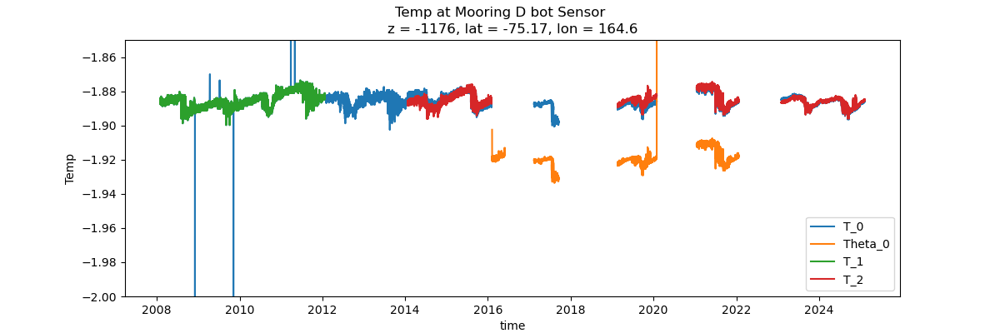

In [142]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['year'].unique()
fig = plt.figure(figsize=(12,4))
plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='bot',color='tab:blue',label='T_0')
plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='bot',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='T_1',mooring='D',instrument='ctd',position='bot',color='tab:green',label='T_1')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='bot',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D bot Sensor')

#### Velocity: zonal, meridional, speed 

Text(0.5, 0.98, 'Zonal Velocity at Mooring D Top Sensor')

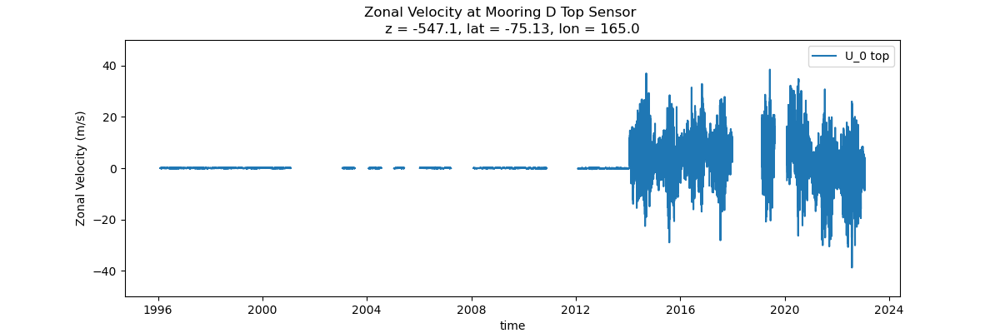

In [246]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='U_0 top')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Zonal Velocity (m/s)')
plt.suptitle('Zonal Velocity at Mooring D Top Sensor')

Text(0.5, 0.98, 'Zonal Velocity at Mooring D mid Sensor')

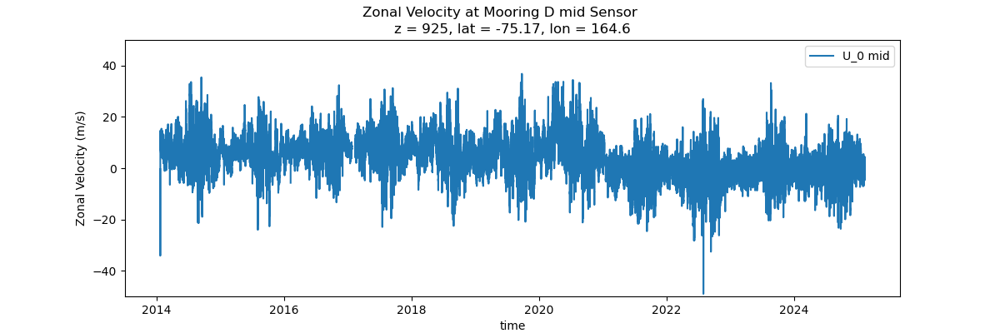

In [247]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='mid',color='tab:blue',label='U_0 mid')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Zonal Velocity (m/s)')
plt.suptitle('Zonal Velocity at Mooring D mid Sensor')

Text(0.5, 0.98, 'Zonal Velocity at Mooring D bot Sensor')

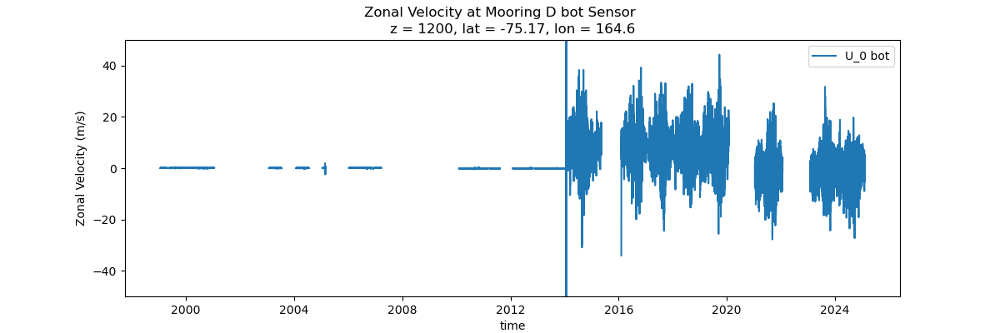

In [248]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='bot',color='tab:blue',label='U_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Zonal Velocity (m/s)')
plt.suptitle('Zonal Velocity at Mooring D bot Sensor')

Text(0.5, 0.98, 'Zonal Velocity at Mooring D')

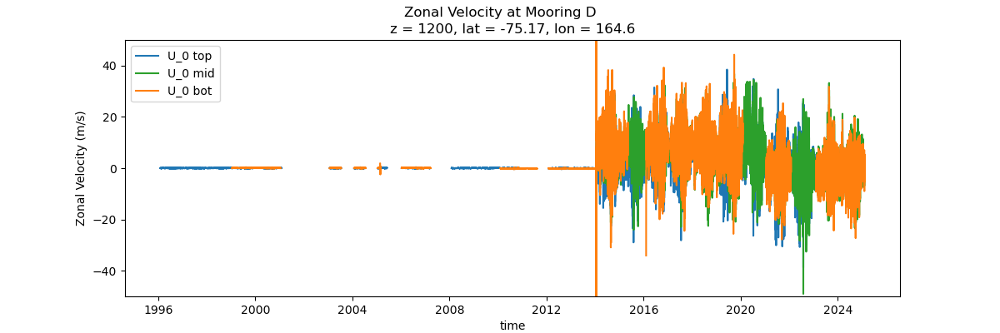

In [249]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='U_0 top')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='mid',color='tab:green',label='U_0 mid')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='U_0',mooring='D',instrument='vel',position='bot',color='tab:orange',label='U_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Zonal Velocity (m/s)')
plt.suptitle('Zonal Velocity at Mooring D')

Text(0.5, 0.98, 'Meridional Velocity at Mooring D Top Sensor')

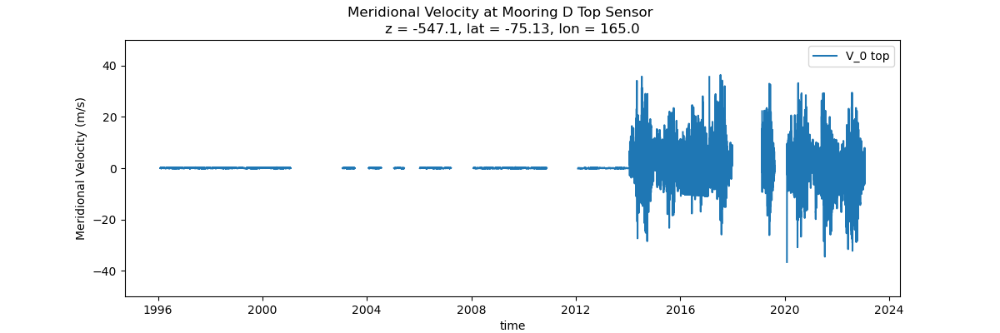

In [250]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='V_0 top')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Meridional Velocity (m/s)')
plt.suptitle('Meridional Velocity at Mooring D Top Sensor')

Text(0.5, 0.98, 'Meridional Velocity at Mooring D mid Sensor')

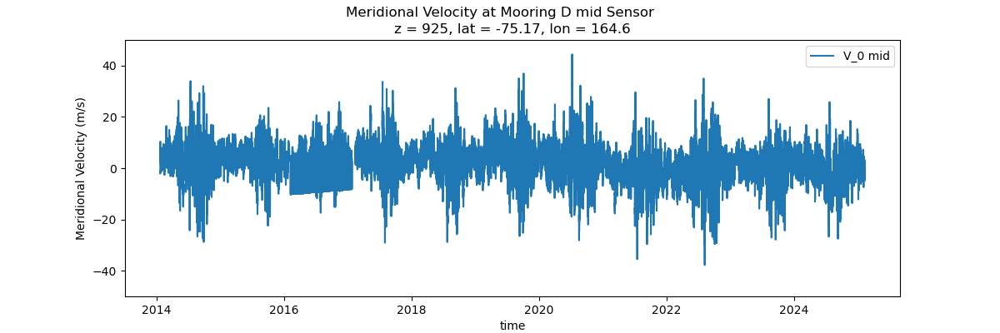

In [251]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='mid',color='tab:blue',label='V_0 mid')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Meridional Velocity (m/s)')
plt.suptitle('Meridional Velocity at Mooring D mid Sensor')

Text(0.5, 0.98, 'Meridional Velocity at Mooring D bot Sensor')

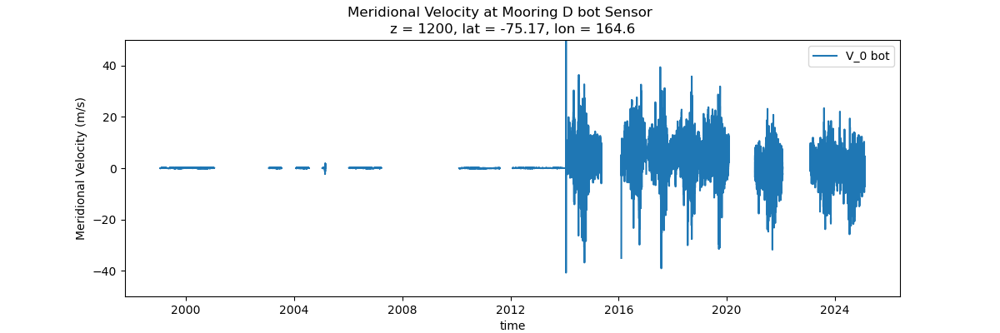

In [252]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='bot',color='tab:blue',label='V_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Meridional Velocity (m/s)')
plt.suptitle('Meridional Velocity at Mooring D bot Sensor')

Text(0.5, 0.98, 'Meridional Velocity at Mooring D')

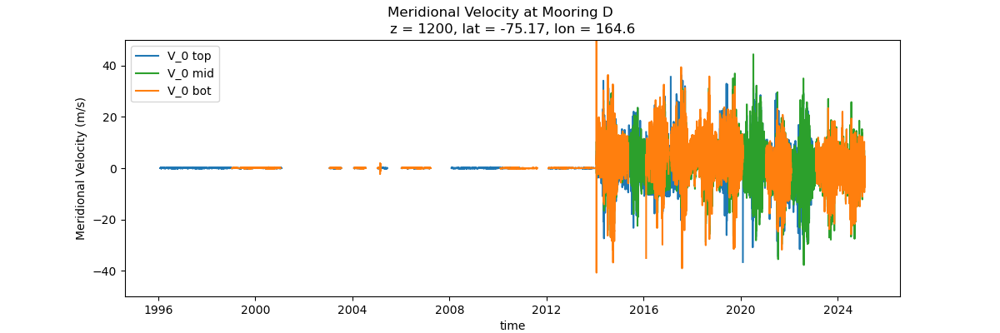

In [253]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='V_0 top')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='mid',color='tab:green',label='V_0 mid')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='V_0',mooring='D',instrument='vel',position='bot',color='tab:orange',label='V_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(-50,50)
plt.ylabel('Meridional Velocity (m/s)')
plt.suptitle('Meridional Velocity at Mooring D')

Text(0.5, 0.98, 'Speed at Mooring D Top Sensor')

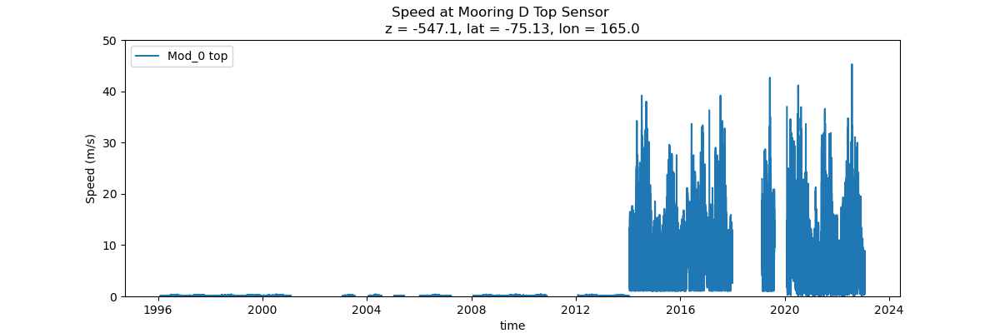

In [254]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='Mod_0 top')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(0,50)
plt.ylabel('Speed (m/s)')
plt.suptitle('Speed at Mooring D Top Sensor')

Text(0.5, 0.98, 'Speed at Mooring D mid Sensor')

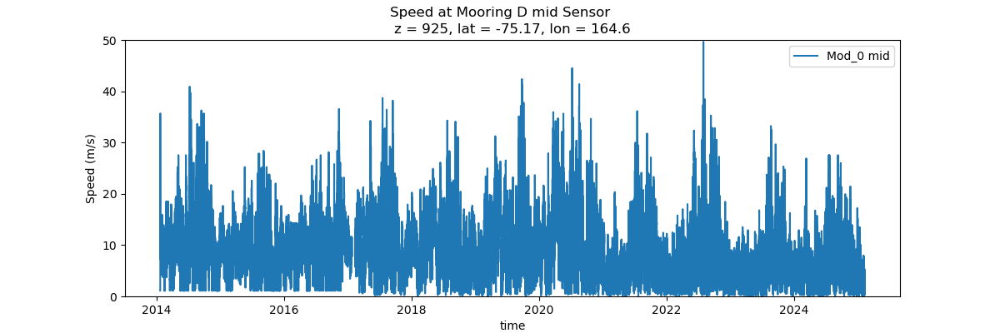

In [255]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='mid',color='tab:blue',label='Mod_0 mid')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(0,50)
plt.ylabel('Speed (m/s)')
plt.suptitle('Speed at Mooring D mid Sensor')

Text(0.5, 0.98, 'Speed at Mooring D bot Sensor')

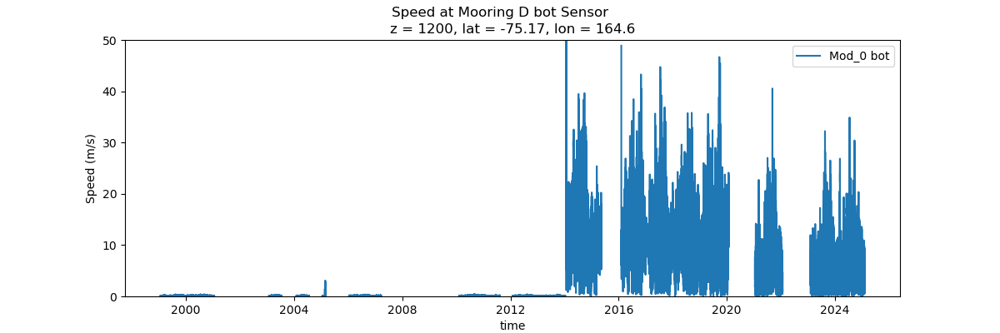

In [256]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='bot',color='tab:blue',label='Mod_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(0,50)
plt.ylabel('Speed (m/s)')
plt.suptitle('Speed at Mooring D bot Sensor')

Text(0.5, 0.98, 'Speed at Mooring D')

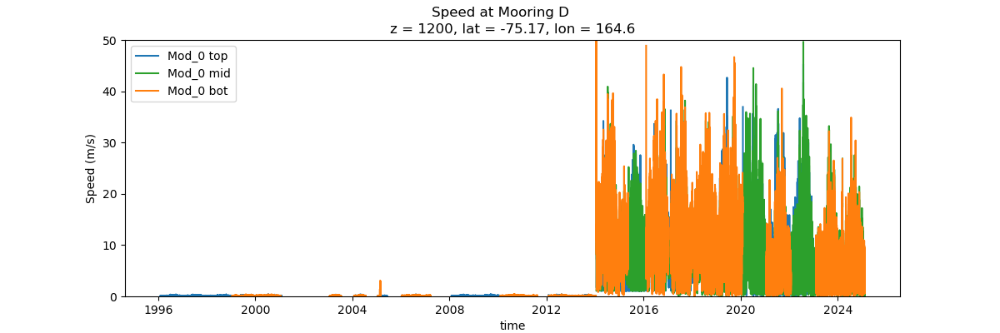

In [257]:
fig = plt.figure(figsize=(12,4))
years = df.query("mooring == 'D' & instrument == 'vel' & position == 'top'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='top',color='tab:blue',label='Mod_0 top')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'mid'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='mid',color='tab:green',label='Mod_0 mid')

years = df.query("mooring == 'D' & instrument == 'vel' & position == 'bot'")['year'].unique()
plot_timeseries(years=years,var='Mod_0',mooring='D',instrument='vel',position='bot',color='tab:orange',label='Mod_0 bot')
# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())
# set limits on plot 
plt.ylim(0,50)
plt.ylabel('Speed (m/s)')
plt.suptitle('Speed at Mooring D')

### Despike Data

Going through each salinity time series to despike. Will despike using a modified z-score and will pick the threshold after visual inspection. 

In [40]:
# make function for modified z-score 
def modified_zscore(data):
    """
    """

    # calculate median 
    median = np.nanmedian(data)
    MAD = median_abs_deviation(data, nan_policy='omit')
    modified_zscore = 0.6745* (data-median)/MAD

    return modified_zscore

def despike_by_zscore(data, zscore, threshold):
    """  
    """

    indx = np.where(np.abs(zscore) > threshold)
    despiked = data.copy()
    despiked[indx] = np.nan
    return despiked

In [41]:
def get_outliers(data, threshold):
    """
    Returns an xarray Dataset containing:
      - outlier_mask (True where flagged)
      - zscore
      - outlier_values
    """
    z = modified_zscore(data)
    mask = np.abs(z) > threshold

    return xr.Dataset({
        "outlier_mask": mask,
        "zscore": z.where(mask),
        "outlier_values": data.where(mask)
    })


In [42]:
def seasonal_despike(da, threshold=3, season_def=None):
    """
    Performs seasonal modified z-score despiking on an xarray DataArray.

    Returns:
        despiked : DataArray (same shape as input, outliers replaced with NaN)
        flagged_times : list of np.datetime64 timestamps flagged as outliers
    """

    if season_def is None:
        season_def = {
            "DJF": [12,1,2],
            "MAM": [3,4,5],
            "JJA": [6,7,8],
            "SON": [9,10,11],
        }

    despiked = da.copy()
    flagged_times = []

    for season, months in season_def.items():

        # subset of data in this season (drop=False keeps full alignment)
        subset = da.where(da.time.dt.month.isin(months), drop=False)

        # compute modified z-score
        median = np.nanmedian(subset)
        MAD = median_abs_deviation(subset, nan_policy='omit')

        # if MAD = 0 → no variability → skip season safely
        if MAD == 0 or np.isnan(MAD):
            continue

        z = 0.6745 * (subset - median) / MAD

        # outlier mask
        mask = np.abs(z) > threshold

        # store timestamps of outliers
        flagged = subset.time.where(mask).dropna("time")
        flagged_times.extend(flagged.values)

        # apply despiking
        despiked = despiked.where(~mask)

    return despiked, flagged_times


In [43]:
def get_despiked_data_from_datatree(year,instrument,position,var):
    """ 
    """

    data = dt['D'][year][instrument][position][var]
    mod_zscore = modified_zscore(data)
    data_despiked_2 = despike_by_zscore(data,mod_zscore,2)
    data_despiked_3 = despike_by_zscore(data,mod_zscore,3)
    data_despiked_4 = despike_by_zscore(data,mod_zscore,4)
    data_despiked_5 = despike_by_zscore(data,mod_zscore,5)
    data_despiked_seasonal, flagged_times_seasonal = seasonal_despike(data,threshold=4,season_def=None)

    return data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal

In [44]:
def get_despiked_data(data):
    """ 
    """

    # data = dt['D'][year][instrument][position][var]
    mod_zscore = modified_zscore(data)
    data_despiked_2 = despike_by_zscore(data,mod_zscore,2)
    data_despiked_3 = despike_by_zscore(data,mod_zscore,3)
    data_despiked_4 = despike_by_zscore(data,mod_zscore,4)
    data_despiked_5 = despike_by_zscore(data,mod_zscore,5)
    data_despiked_seasonal, flagged_times_seasonal = seasonal_despike(data,threshold=4,season_def=None)

    return data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal

In [45]:
def plot_despiked_data():
    fig = plt.figure(figsize=(12,20),constrained_layout=True)

    ax0 = fig.add_subplot(5,1,1)
    plt.plot(data.time,data,label='Originial Data')
    plt.plot(data_despiked_2.time,data_despiked_2,label='Despiked, threshold=2',color='tab:green')
    plt.legend()

    ax1 = fig.add_subplot(5,1,2)
    plt.plot(data.time,data,label='Originial Data')
    plt.plot(data_despiked_3.time,data_despiked_3,label='Despiked, threshold=3',color='tab:purple')
    plt.legend()

    ax2 = fig.add_subplot(5,1,3)
    plt.plot(data.time,data,label='Originial Data')
    plt.plot(data_despiked_4.time,data_despiked_4,label='Despiked, threshold=4',color='tab:orange')
    plt.legend()

    ax3 = fig.add_subplot(5,1,4)
    plt.plot(data.time,data,label='Originial Data')
    plt.plot(data_despiked_5.time,data_despiked_5,label='Despiked, threshold=5',color='tab:red')
    plt.legend()

    ax4 = fig.add_subplot(5,1,5)
    plt.plot(data.time,data,label='Originial Data')
    plt.plot(data_despiked_seasonal.time,data_despiked_seasonal,label='Despiked Seasonally, threshold=4',color='tab:brown')
    plt.legend()

    return ax0,ax1,ax2,ax3,ax4

In [46]:
df.query("mooring == 'D' & position == 'top' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
10,D,1998,ctd,top,-566,"[S_0, T_0, S_1]",1997-12-10 15:00:00,1999-01-14 12:30:00,0 days 00:30:00,19196.0
15,D,1999,ctd,top,-546,"[S_0, T_0, S_1]",1999-01-17 22:30:00,2000-01-16 14:30:00,0 days 00:30:00,17457.0
22,D,2000,ctd,top,-526,"[S_0, T_0, S_1, S_2]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
54,D,2010,ctd,top,-463,"[S_0, T_0, T_1, S_1, S_2]",2010-02-06 02:55:00,2012-01-23 14:25:00,0 days 00:30:00,34392.0
61,D,2012,ctd,top,-509,"[T_0, S_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 15:00:00,0 days 00:30:00,34066.0
66,D,2014,ctd,top,-509,"[S_0, T_0, S_2, S_1, T_2]",2014-01-22 00:00:00,2016-01-31 10:00:00,0 days 00:30:00,35493.0
73,D,2016,ctd,top,-523,"[Theta_0, S_0, Conductivity]",2016-02-06 22:05:00,2016-09-14 21:45:00,0 days 00:05:00,63645.0
81,D,2017,ctd,top,-556,"[T_0, S_0, Conductivity, S_2, T_2]",2017-02-11 07:00:00,2019-02-18 23:00:00,0 days 00:30:00,35409.0
88,D,2019,ctd,top,-574,"[T_0, S_0, Theta_0, Turbidity, S_2, T_2]",2019-02-19 17:45:00,2020-01-30 01:45:00,0 days 00:30:00,16529.0
94,D,2020,ctd,top,-612.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 14:22:00,2021-01-07 22:22:00,0 days 00:30:00,16385.0


#### Despike Mooring D Salinity Top Sensor 

##### 2014

In [47]:
# get despiked data at various zscore thresholds 
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data=D_2014_ctd_top.S_2)

In [48]:
# get time stamps of outliers 
outliers_2 = get_outliers(data=data,threshold=2)
outliers_3 = get_outliers(data=data,threshold=3)
outliers_4 = get_outliers(data=data,threshold=4)
outliers_5 = get_outliers(data=data,threshold=5)

flagged_times_2 = outliers_2.outlier_values.dropna(dim="time").time.values
flagged_times_3 = outliers_3.outlier_values.dropna(dim="time").time.values
flagged_times_4 = outliers_4.outlier_values.dropna(dim="time").time.values
flagged_times_5 = outliers_5.outlier_values.dropna(dim="time").time.values

In [49]:
flagged_times_seasonal

[np.datetime64('2015-01-05T19:30:00.000000000'),
 np.datetime64('2015-01-05T20:00:00.000000000'),
 np.datetime64('2014-04-10T01:30:00.000000000'),
 np.datetime64('2014-04-15T01:00:00.000000000')]

Text(0.5, 0.98, 'Mooring D Top S_2 2014')

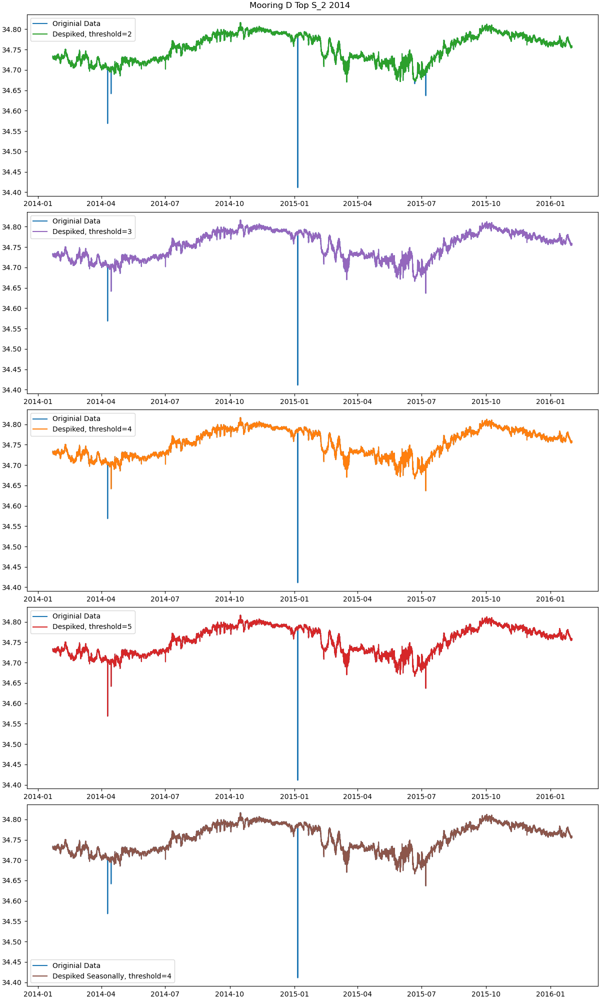

In [50]:
# plot the various despike data 
plot_despiked_data()
plt.suptitle('Mooring D Top S_2 2014')

In [51]:
data_despiked_seasonal

<xarray.DataArray 'S_2' (time: 35493)> Size: 284kB
array([34.73380023, 34.73060047, 34.7320007 , ..., 34.75919953,
       34.75559977, 34.7565    ], shape=(35493,))
Coordinates:
  * time     (time) datetime64[ns] 284kB 2014-01-22 ... 2016-01-31T10:00:00
    z        int64 8B -509
    lat      float64 8B -75.14
    lon      float64 8B 164.6

In [52]:
D_2014_ctd_top['sal'] = ('time',data_despiked_seasonal.data)

In [53]:
# will use the seaonsal despike for sal data 
# dt['D']['2014']['ctd']['top']['sal'] = data_despiked_seasonal

In [54]:
# dt['D']['2014']['ctd']['top']

##### 2016

In [92]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2016_ctd_top.S_0)

C:\Users\mblan\AppData\Local\Temp\ipykernel_29020\2970984262.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12,20),constrained_layout=True)


Text(0.5, 0.98, 'Mooring D Top S_0 2016')

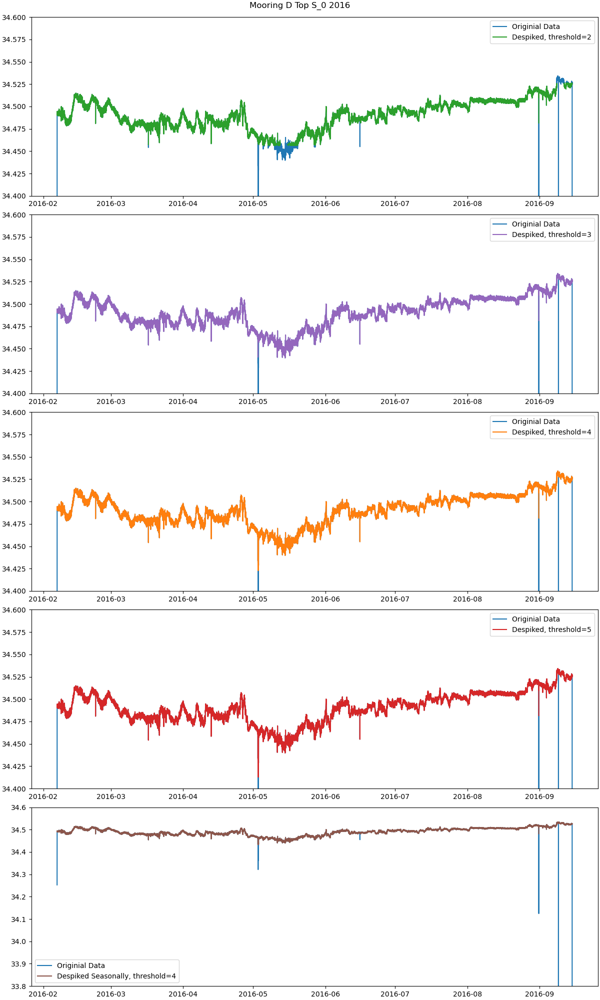

In [93]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
ax0.set_ylim(34.4,34.6)
ax1.set_ylim(34.4,34.6)
ax2.set_ylim(34.4,34.6)
ax3.set_ylim(34.4,34.6)
ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_0 2016')

No S_2 data for 2016 so skipping this one - in orginal plot it is clear that S_0 data is lower than S_2 and likely needs to be corrected somehow 

##### 2017

In [55]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2017_ctd_top.S_2)

Text(0.5, 0.98, 'Mooring D Top S_2 2017')

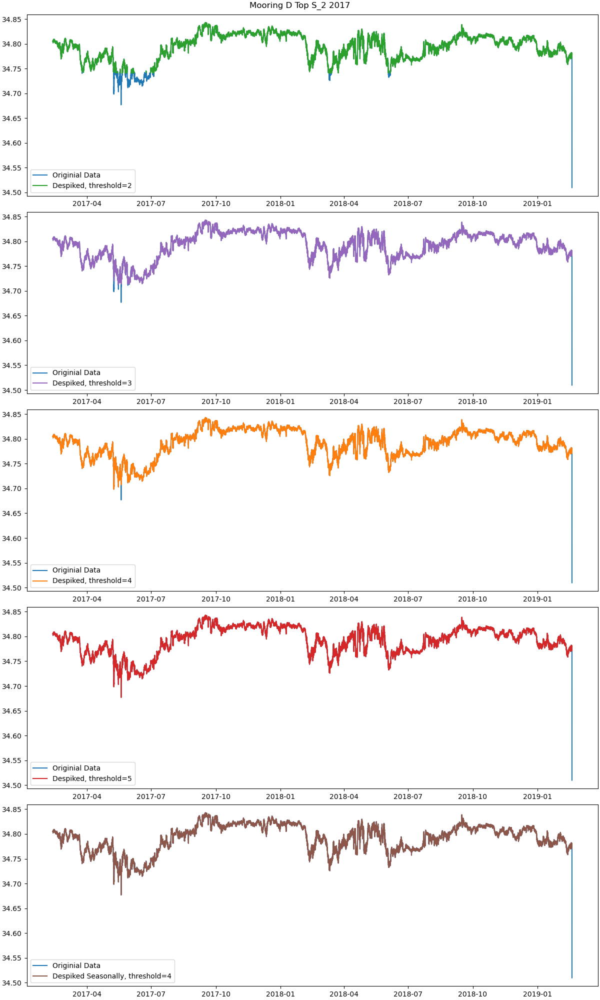

In [56]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_2 2017')

In [57]:
flagged_times_seasonal

[np.datetime64('2019-02-18T23:00:00.000000000')]

In [58]:
D_2017_ctd_top['sal'] = ('time',data_despiked_seasonal.data)

In [59]:
# will despike using seasonal despiking method 
# dt['D']['2017']['ctd']['top']['sal'] = data_despiked_seasonal

##### 2019

In [60]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2019_ctd_top.S_2)

Text(0.5, 0.98, 'Mooring D Top S_2 2019')

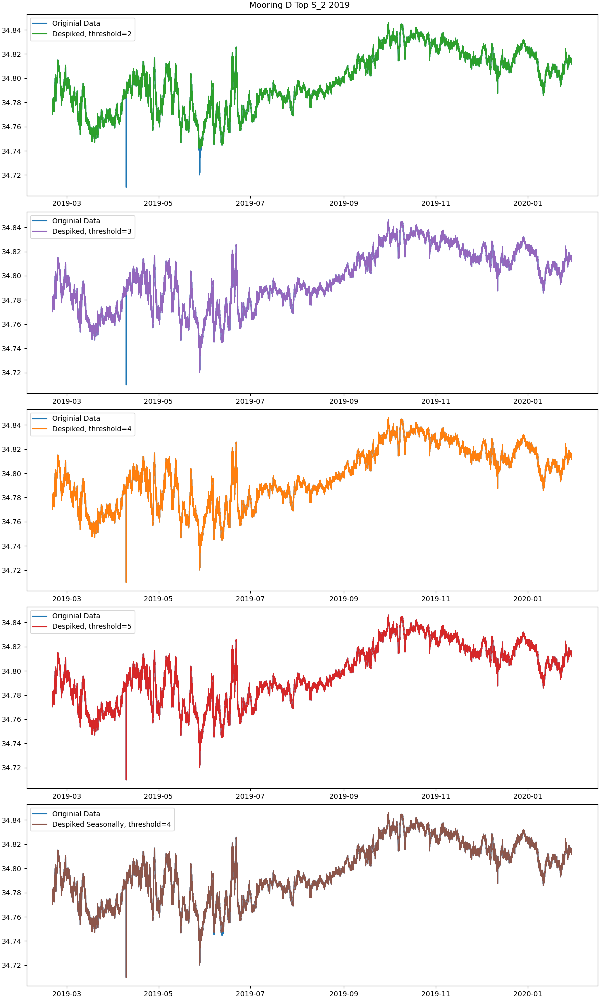

In [61]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_2 2019')

In [62]:
D_2019_ctd_top['sal'] = ('time',data_despiked_3.data)

In [63]:
# despike using threshold of 3 
# dt['D']['2019']['ctd']['top']['sal'] = data_despiked_3

##### 2020

In [64]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2020_ctd_top.S_2)

Text(0.5, 0.98, 'Mooring D Top S_2 2020')

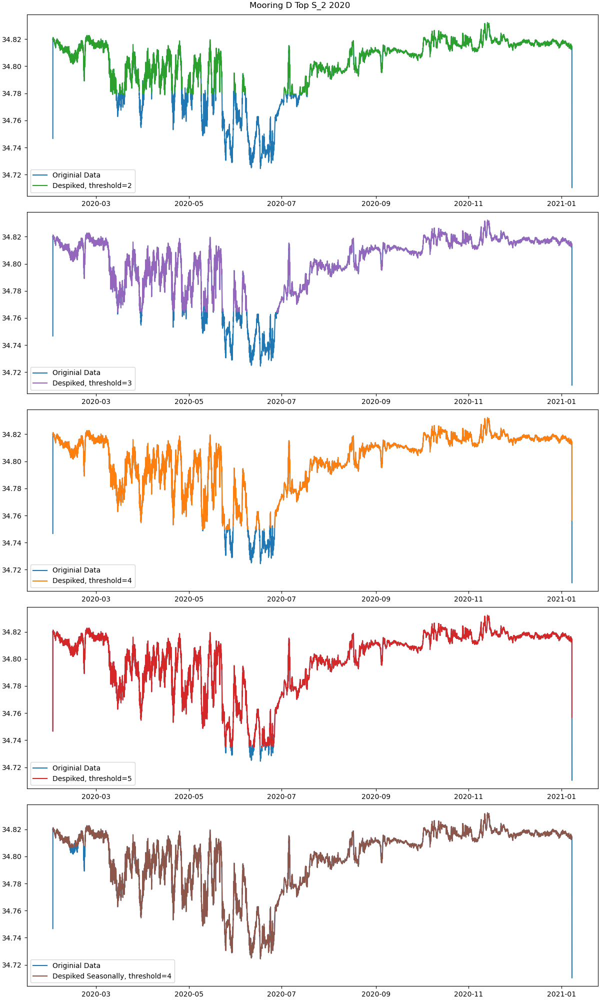

In [65]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_2 2020')

In [66]:
sal = D_2020_ctd_top.sel(time=slice('2020-02-01T16','2021-01-07T20')).S_2

In [67]:
D_2020_ctd_top = D_2020_ctd_top.sel(time=slice('2020-02-01T16','2021-01-07T20'))
D_2020_ctd_top['sal'] = ('time',sal.data) 

In [68]:
# really just need to cut of ends of 2020 data, the rest of the data looks like it could be real 
# ds = dt['D']['2020']['ctd']['top'].sel(time=slice('2020-02-01T16','2021-01-07T20'))
# dt['D']['2020']['ctd']['top']['sal'] = ds['S_2'] 

##### 2021

In [69]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2021_ctd_top.S_2)

Text(0.5, 0.98, 'Mooring D Top S_2 2021')

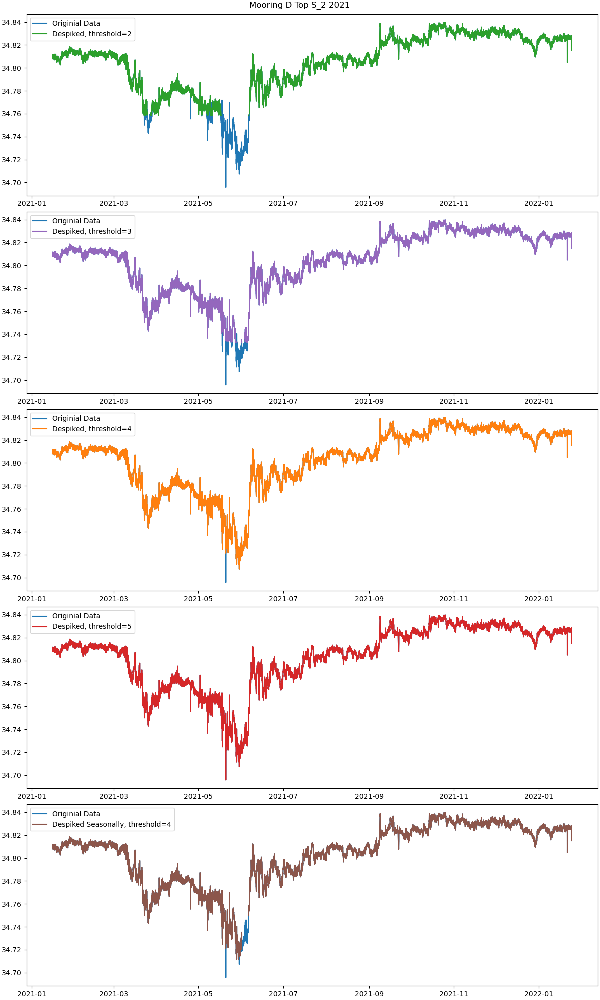

In [70]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_2 2021')

In [71]:
D_2021_ctd_top['sal'] = ('time',D_2021_ctd_top.S_2.data)

In [72]:
# data looks fine and does not need to be despiked 
# dt['D']['2021']['ctd']['top']['sal'] = dt['D']['2021']['ctd']['top']['S_2'] 

##### 2022

In [73]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2022_ctd_top.S_2)

Text(0.5, 0.98, 'Mooring D Top S_2 2022')

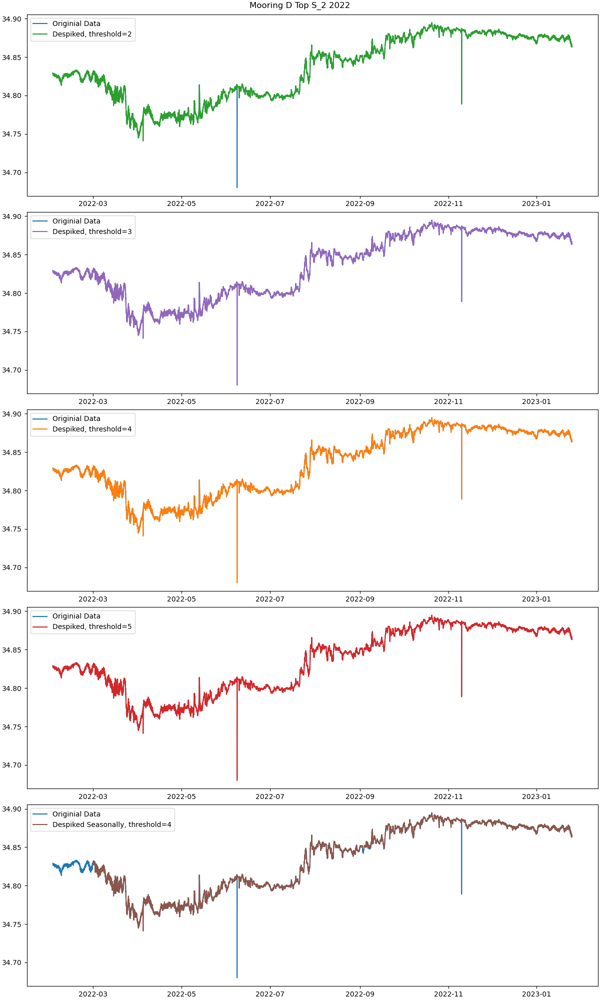

In [74]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top S_2 2022')

In [75]:
# get spikes around 2022-06 and 2022-11
time0 = np.datetime64('2022-11-10T03:40:00.000000000')
time1 = np.datetime64('2022-06-08T06:40:00.000000000')


In [76]:
D_2022_ctd_top['sal'] = ('time',D_2022_ctd_top.S_2.data)

In [77]:
D_2022_ctd_top['sal'].loc[dict(time=time0)] = np.nan
D_2022_ctd_top['sal'].loc[dict(time=time1)] = np.nan

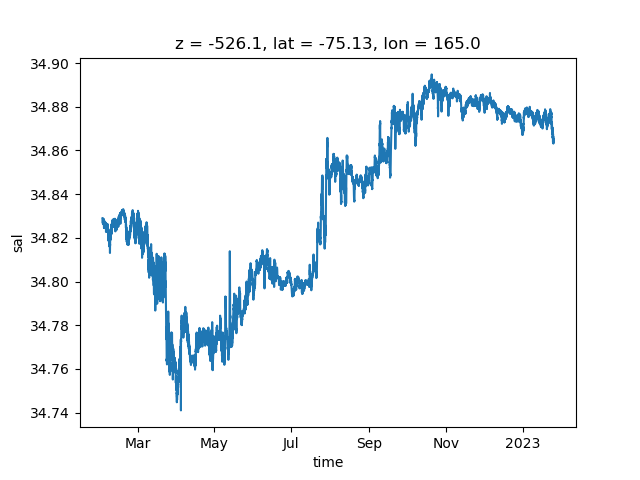

In [78]:
fig = plt.figure()
D_2022_ctd_top.sal.plot()

In [79]:
# leaving salinity as it for now, might want to remove spike around 2022-06 and 2022-22 later 
# dt['D']['2022']['ctd']['top']['sal'] = dt['D']['2022']['ctd']['top']['S_2'].copy()

In [80]:
# da = dt['D']['2022']['ctd']['top']['sal']
# da.loc[dict(time=time0)] = np.nan
# da.loc[dict(time=time1)] = np.nan

In [81]:
# make plot of S2 and sal (i.e before and after despiking)
# years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()
# fig = plt.figure(figsize=(12,4))
# # plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='top',color='tab:blue',label='S_0')
# # plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='top',color='tab:green',label='S_1')
# plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='top',color='tab:red',label='S_2')
# # plot_timeseries(years=years,var='sal',mooring='D',instrument='ctd',position='top',color='tab:blue',label='sal')

# # get handles and labels for legend 
# handles, labels = plt.gca().get_legend_handles_labels()
# # only picks unique labels / handles 
# unique = dict(zip(labels, handles))
# # makes legend with unique keys only 
# plt.legend(unique.values(), unique.keys())

# # set limits on plot 
# plt.ylim(34.2,34.95)
# plt.ylabel('Salinity')
# plt.suptitle('Salinity at Mooring D Top Sensor')

#### Despike Mooring D Salinity Mid1 Sensor 

In [82]:
df.query("mooring == 'D' & position == 'mid1'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
0,D,1995,ctd,mid1,-756,"[S_0, T_0, S_1]",1995-02-17 17:00:00,1996-01-14 06:30:00,0 days 00:30:00,15868.0
2,D,1995,vel,mid1,-756,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1995-02-17 17:00:00,1996-01-14 07:00:00,0 days 00:30:00,15869.0
4,D,1996,ctd,mid1,-836,"[S_0, T_0, S_1, S_2]",1996-02-02 01:00:00,1997-12-08 02:00:00,0 days 00:30:00,32403.0
6,D,1996,vel,mid1,-835,"[U_0, V_0, T_0, AWT_0, U_1, V_1, T_1, AWT_1, M...",1996-02-02 01:00:00,1997-07-04 05:00:00,0 days 00:30:00,24873.0
11,D,1998,vel,mid1,-766,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1997-12-10 15:00:00,1999-01-14 12:30:00,0 days 00:30:00,19196.0
17,D,1999,vel,mid1,-746,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",1999-01-17 22:30:00,2000-01-16 14:30:00,0 days 00:30:00,17457.0
20,D,2000,ctd,mid1,-823,"[S_0, T_0, S_1, S_2]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
24,D,2000,vel,mid1,-724,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
27,D,2001,ctd,mid1,-820,"[S_0, T_0, S_1, S_2]",2001-01-18 06:00:00,2002-01-31 07:30:00,0 days 00:30:00,18148.0
29,D,2001,vel,mid1,-722,"[U_0, V_0, T_0, AWT_0, Mod_0, Dir_0]",2001-01-18 06:00:00,2002-01-31 07:30:00,0 days 00:30:00,18148.0


##### 2017

In [83]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2017_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2017')

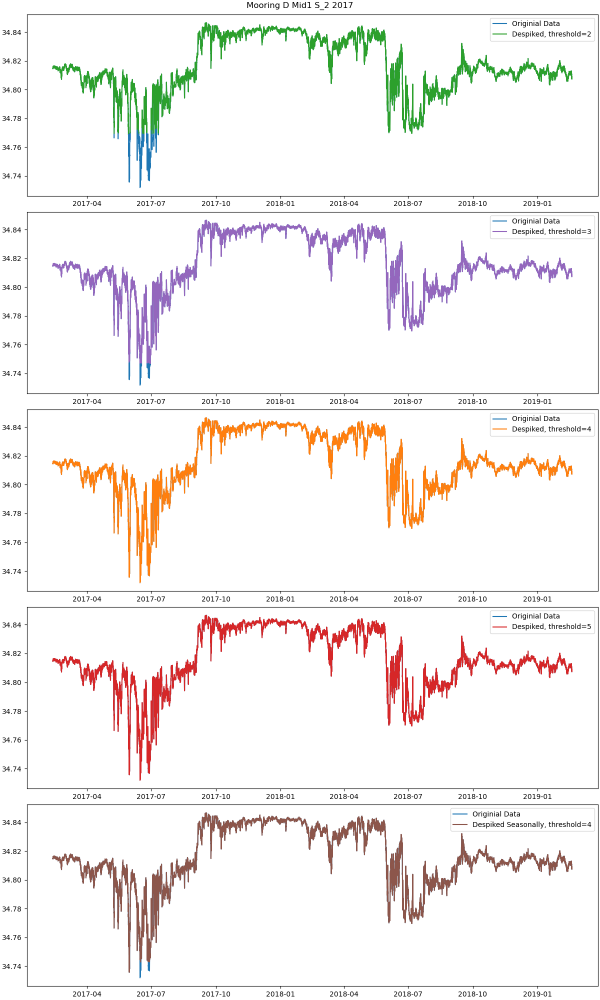

In [84]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2017')

In [85]:
D_2017_ctd_mid1['sal'] = ('time',D_2017_ctd_mid1.S_2.data)

In [86]:
# nothing to despike 
# dt['D']['2017']['ctd']['mid1']['sal'] = dt['D']['2017']['ctd']['mid1']['S_2'].copy()

##### 2019

In [87]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2019_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2019')

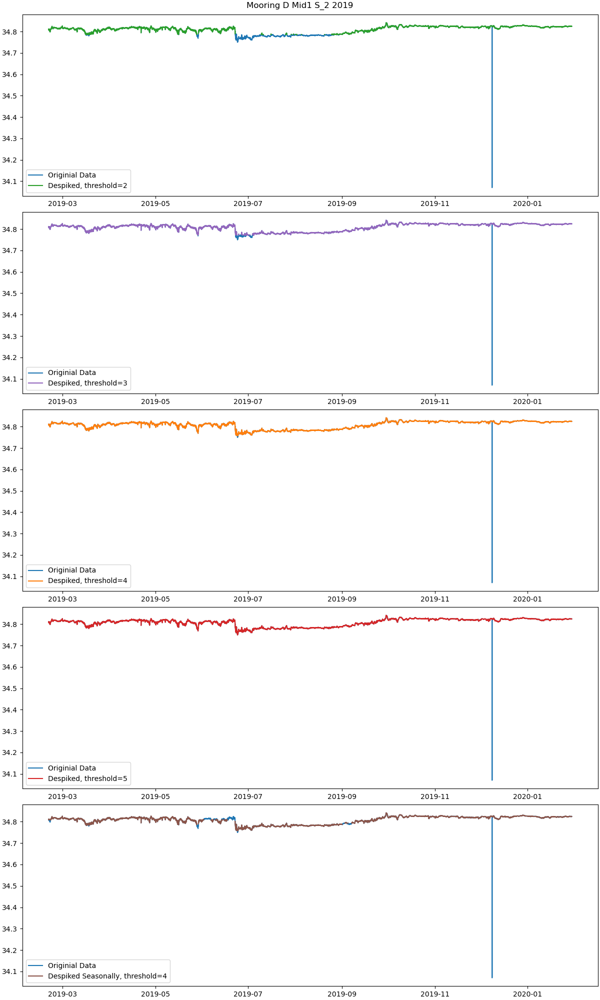

In [88]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2019')

In [89]:
D_2019_ctd_mid1['sal'] = ('time', data_despiked_5.data)

In [90]:
# despiking using modified z score with threshold of 5 
# dt['D']['2019']['ctd']['mid1']['sal'] = data_despiked_5

In [91]:
D_2019_ctd_mid1

<xarray.Dataset> Size: 1MB
Dimensions:   (time: 16531)
Coordinates:
  * time      (time) datetime64[ns] 132kB 2019-02-19T18:00:00 ... 2020-01-30T...
    z         <U4 16B '-790'
    lat       float64 8B -75.08
    lon       float64 8B 164.7
Data variables:
    T_0       (time) float64 132kB ...
    S_0       (time) float64 132kB ...
    Theta_0   (time) float64 132kB ...
    Depth     (time) float64 132kB ...
    Pressure  (time) float64 132kB ...
    S_2       (time) float64 132kB 34.81 34.81 34.81 34.81 ... 34.82 34.82 nan
    T_2       (time) float64 132kB ...
    sal       (time) float64 132kB 34.81 34.81 34.81 34.81 ... 34.82 34.82 nan
Attributes: (12/14)
    cruise_deployment:               PNRA - XXXIV Expedition - 2018/19   
    cruise_recovery:                 PNRA - XXXV Expedition - 2019/20
    water_depth_meters:              -1164
    instr_depth_meters:              -790
    instr_type:                      SBE37
    instr_sn:                        10752
    ...                              ...
    samp_int_minutes:                30
    start_time:                      19/02/2019 18:00:00
    stop_time:                       30/01/2020 03:00:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

##### 2021

In [92]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2021_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2021')

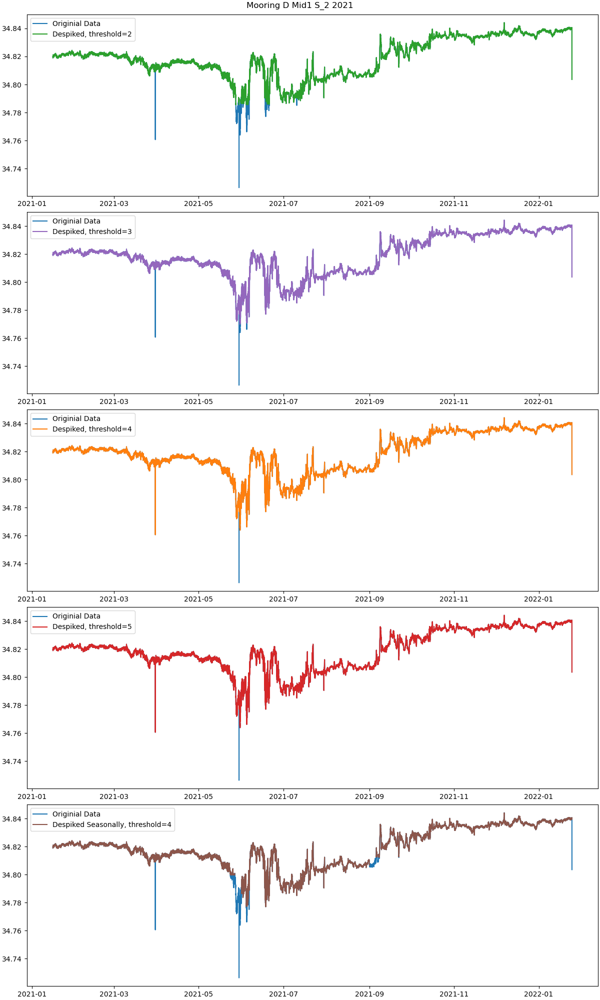

In [93]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2021')

In [94]:
outliers_2 = get_outliers(data=data,threshold=2)
outliers_3 = get_outliers(data=data,threshold=3)
outliers_4 = get_outliers(data=data,threshold=4)
outliers_5 = get_outliers(data=data,threshold=5)

flagged_times_2 = outliers_2.outlier_values.dropna(dim="time").time.values
flagged_times_3 = outliers_3.outlier_values.dropna(dim="time").time.values
flagged_times_4 = outliers_4.outlier_values.dropna(dim="time").time.values
flagged_times_5 = outliers_5.outlier_values.dropna(dim="time").time.values

In [95]:
flagged_times_5[0]

np.datetime64('2021-05-30T01:40:00.000000000')

In [96]:
time0 = np.datetime64('2022-01-24T22:10:00.000000000')
time1 = np.datetime64('2021-03-30T18:40:00.000000000')
time2 = flagged_times_5[0]


In [97]:
D_2021_ctd_mid1['sal'] = ('time',D_2021_ctd_mid1.S_2.data)

In [98]:
D_2021_ctd_mid1['sal'].loc[dict(time=time0)] = np.nan
D_2021_ctd_mid1['sal'].loc[dict(time=time1)] = np.nan
D_2021_ctd_mid1['sal'].loc[dict(time=time2)] = np.nan

In [99]:
# dt['D']['2021']['ctd']['mid1']['sal'] = dt['D']['2021']['ctd']['mid1']['S_2'].copy()

In [100]:
# da = dt['D']['2021']['ctd']['mid1']['sal']
# da.loc[dict(time=time0)] = np.nan
# da.loc[dict(time=time1)] = np.nan
# da.loc[dict(time=time2)] = np.nan

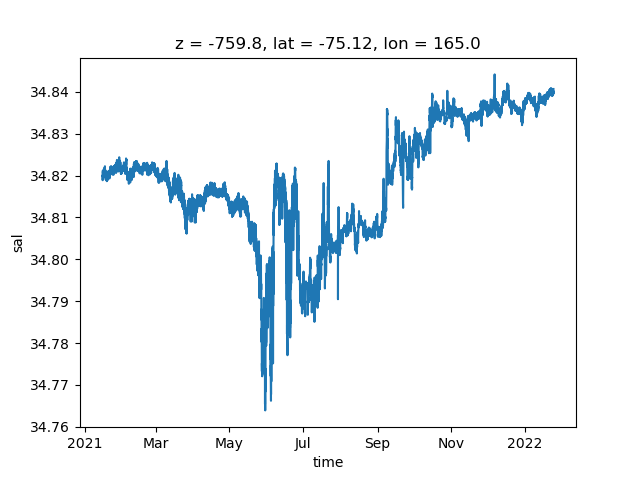

In [101]:
fig = plt.figure()
D_2021_ctd_mid1.sal.plot()

In [102]:
# fig = plt.figure()
# dt['D']['2021']['ctd']['mid1']['sal'].plot()

##### 2022

In [103]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2022_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2022')

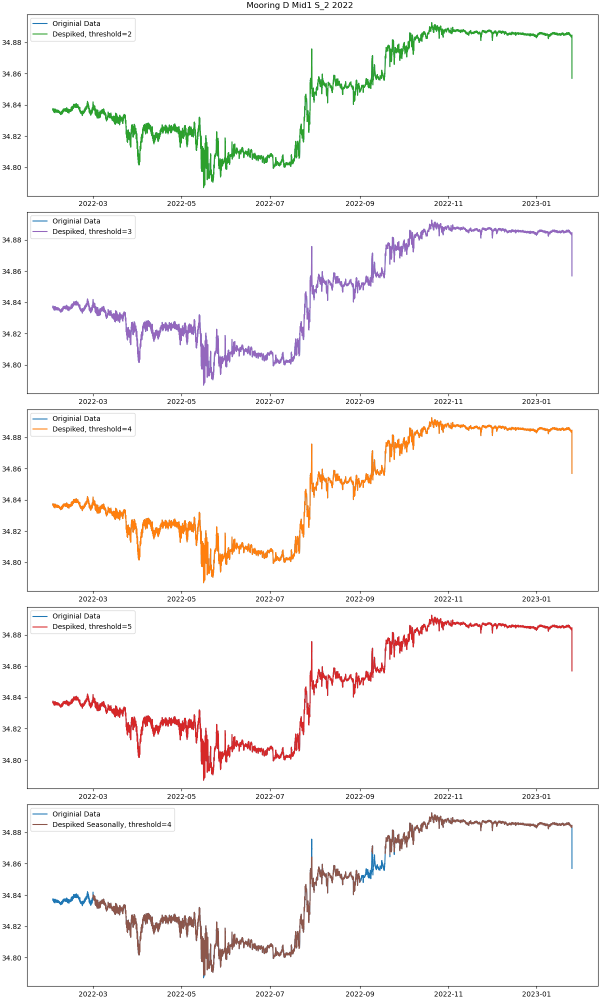

In [104]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2022')

In [106]:
D_2022_ctd_mid1 = D_2022_ctd_mid1.isel(time=slice(0,-1))

In [107]:
D_2022_ctd_mid1['sal'] = ('time',D_2022_ctd_mid1.S_2.data)

In [108]:
# # just want to remove last point 
# dt['D']['2022']['ctd']['mid1'] = dt['D']['2022']['ctd']['mid1'].copy().isel(time=slice(0,-1))
# dt['D']['2022']['ctd']['mid1']['sal'] = dt['D']['2022']['ctd']['mid1']['S_2']

##### 2023

In [109]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2023_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2023')

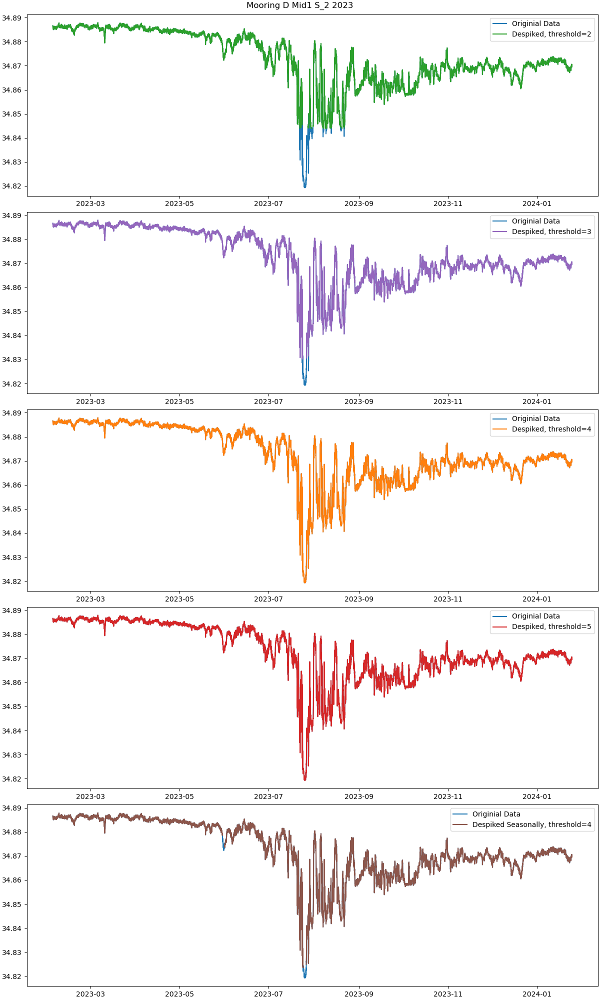

In [110]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2023')

In [111]:
D_2023_ctd_mid1['sal'] = ('time', D_2023_ctd_mid1.S_2.data)

In [112]:
# nothing to despike 
# dt['D']['2023']['ctd']['mid1']['sal'] = dt['D']['2023']['ctd']['mid1']['S_2'].copy()

##### 2024

In [113]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2024_ctd_mid1.S_2)

Text(0.5, 0.98, 'Mooring D Mid1 S_2 2024')

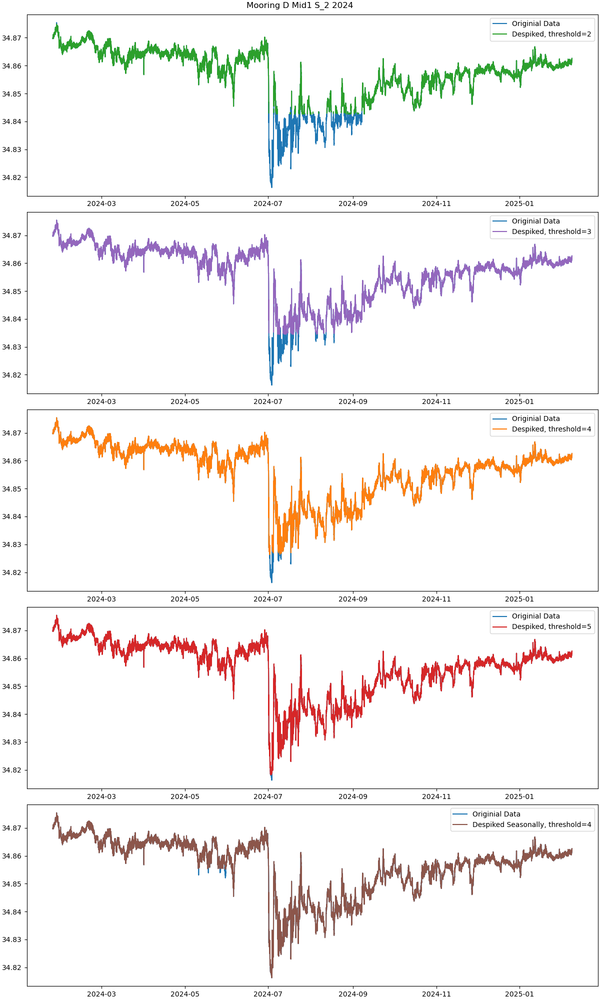

In [114]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid1 S_2 2024')

In [115]:
D_2024_ctd_mid1['sal'] = ('time', D_2024_ctd_mid1.S_2.data)

In [116]:
# nothing to despike 
# dt['D']['2024']['ctd']['mid1']['sal'] = dt['D']['2024']['ctd']['mid1']['S_2'].copy()

##### 2020

2020 had ctd sensor placed at mid2 location so adding it in to make time series continuous 

In [119]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2020_ctd_mid2.S_2)

Text(0.5, 0.98, 'Mooring D Mid2 S_2 2020')

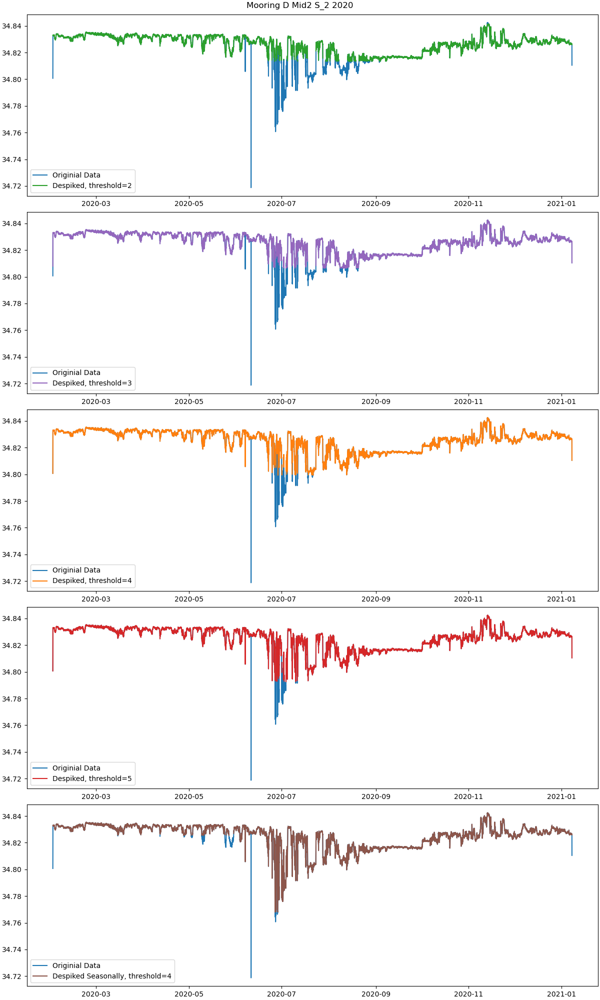

In [120]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Mid2 S_2 2020')

In [ ]:
# to remove 
# time0 = np.datetime64('2020-02-01T13:29:00.000000000')
time1 = np.datetime64('2021-01-07T21:29:00.000000000')
time2 = np.datetime64('2020-06-10T21:29:00.000000000')


In [128]:
D_2020_ctd_mid2['sal'] = ('time',D_2020_ctd_mid2.S_2.data)
D_2020_ctd_mid2 = D_2020_ctd_mid2.sel(time=slice('2020-02-01T14:45',None))

# D_2020_ctd_mid2['sal'].loc[dict(time=time0)] = np.nan
D_2020_ctd_mid2['sal'].loc[dict(time=time1)] = np.nan
D_2020_ctd_mid2['sal'].loc[dict(time=time2)] = np.nan

In [ ]:
# dt['D']['2020']['ctd']['mid2']['sal'] = dt['D']['2020']['ctd']['mid2']['S_2'].copy()

In [125]:
# da = dt['D']['2020']['ctd']['mid2']['sal']
# da.loc[dict(time=time0)] = np.nan
# da.loc[dict(time=time1)] = np.nan
# da.loc[dict(time=time2)] = np.nan

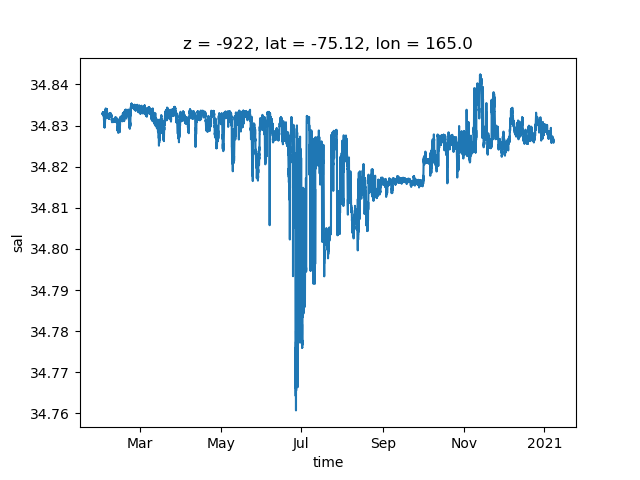

In [129]:
fig = plt.figure()
D_2020_ctd_mid2.sal.plot()

In [130]:
# # plot sal and S_2 to see despiked data vs. original 
# # make plot of S2 and sal (i.e before and after despiking)
# years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()
# fig = plt.figure(figsize=(12,4))
# # plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='top',color='tab:blue',label='S_0')
# # plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='top',color='tab:green',label='S_1')
# plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='mid1',color='tab:red',label='S_2')
# plot_timeseries(years=years,var='sal',mooring='D',instrument='ctd',position='mid1',color='tab:blue',label='sal')

# years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['year'].unique()
# plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='mid2',color='tab:red',label='S_2')
# plot_timeseries(years=years,var='sal',mooring='D',instrument='ctd',position='mid2',color='tab:blue',label='sal')

# # get handles and labels for legend 
# handles, labels = plt.gca().get_legend_handles_labels()
# # only picks unique labels / handles 
# unique = dict(zip(labels, handles))
# # makes legend with unique keys only 
# plt.legend(unique.values(), unique.keys())

# # set limits on plot 
# plt.ylim(34.2,34.95)
# plt.ylabel('Salinity')
# plt.suptitle('Salinity at Mooring D Mid1 Sensor')

#### Despike Mooring D Salinity Bottom Sensor 

In [132]:
df.query("mooring == 'D' & position == 'bot' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
48,D,2008,ctd,bot,-1062,"[T_0, S_0, Turb_0, Tpot_0, T_1, S_1, Turb_1, T...",2008-01-31 02:50:54,2010-02-03 10:20:54,0 days 00:30:00,35248.0
51,D,2010,ctd,bot,-1036,"[T_0, S_0, S_1, T_1, S_2]",2010-02-06 02:34:00,2012-01-23 15:04:00,0 days 00:30:00,34394.0
58,D,2012,ctd,bot,-1069,"[S_0, T_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 14:30:00,0 days 00:30:00,34065.0
65,D,2014,ctd,bot,-1069,"[T_0, S_0, S_1, S_2, T_2]",2014-01-22 13:30:00,2016-02-01 17:00:00,0 days 00:30:00,35528.0
72,D,2016,ctd,bot,-1060,"[Theta_0, S_0, Conductivity]",2016-02-06 22:02:00,2016-05-28 07:47:00,0 days 00:05:00,32086.0
79,D,2017,ctd,bot,-1086,"[T_0, S_0, Conductivity, Theta_0, Oxygen, Dept...",2017-02-11 07:35:00,2017-09-17 03:05:00,0 days 00:30:00,10456.0
86,D,2019,ctd,bot,-1130,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 16:00:00,2020-01-30 01:00:00,0 days 00:30:00,16531.0
98,D,2021,ctd,bot,-1073.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 21:59:00,2022-01-24 21:29:00,0 days 00:30:00,17952.0
110,D,2023,ctd,bot,-1200.5,"[T_0, S_0, S_2, T_2]",2023-02-03 08:45:00,2024-01-24 22:45:00,0 days 00:30:00,17069.0
115,D,2024,ctd,bot,-1176,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 10:07:56,2025-02-08 05:07:56,0 days 00:30:00,18231.0


##### 2014

In [133]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2014_ctd_bot.S_2)

Text(0.5, 0.98, 'Mooring D Bot S_2 2014')

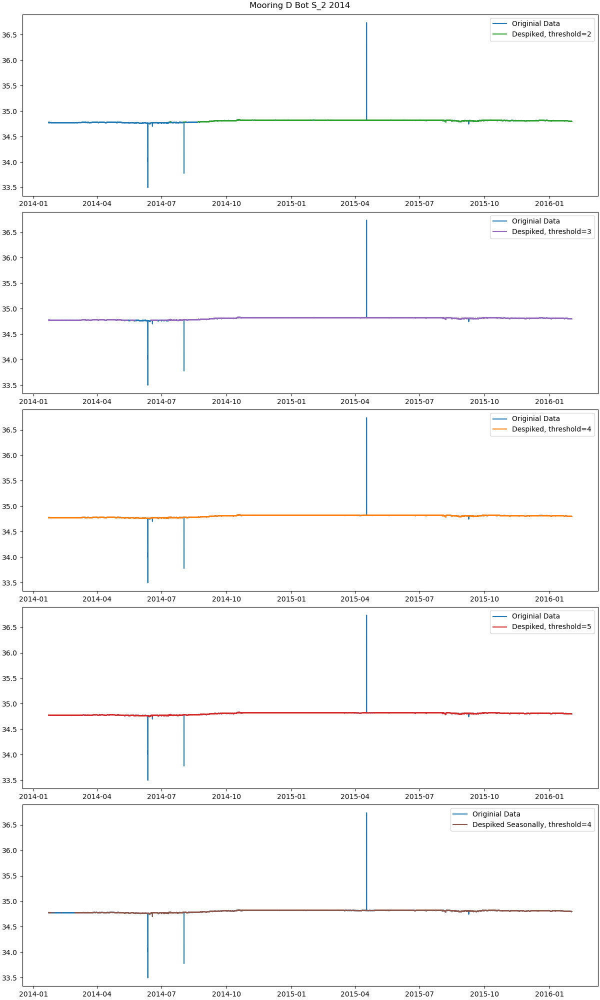

In [134]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_2 2014')

In [135]:
D_2014_ctd_bot['sal'] = ('time',data_despiked_5.data)

In [136]:
# despiking via threshold of 5 
# dt['D']['2014']['ctd']['bot']['sal'] = data_despiked_5

Note that 2016 and 2017 bottom sensor does not have level 2 data!! Need to ask why and if level 0 data is good to use. Much less discrepency between level 0 and 2 at bottom sensor compared to top. 

#### 2016

In [156]:
D_2016_ctd_bot

<xarray.Dataset> Size: 1MB
Dimensions:       (time: 32086)
Coordinates:
  * time          (time) datetime64[ns] 257kB 2016-02-06T22:02:00 ... 2016-05...
    z             <U5 20B '-1060'
    lat           float64 8B -75.14
    lon           float64 8B 164.6
Data variables:
    Theta_0       (time) float64 257kB ...
    S_0           (time) float64 257kB ...
    Conductivity  (time) float64 257kB ...
Attributes: (12/14)
    cruise_deployment:               PNRA - XXXI Expedition - 2015/16  
    cruise_recovery:                 PNRA - XXXII Expedition - 2016/17
    water_depth_meters:              -1144
    instr_depth_meters:              -1060
    instr_type:                      SBE 37
    instr_sn:                        12516
    ...                              ...
    samp_int_seconds:                300
    start_time:                      06/02/2016 22:02:00
    stop_time:                       28/05/2016 07:47:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

In [157]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2016_ctd_bot.S_0)

C:\Users\mblan\AppData\Local\Temp\ipykernel_19364\34212724.py:27: RuntimeWarning: All-NaN slice encountered
  median = np.nanmedian(subset)
C:\Users\mblan\AppData\Local\Temp\ipykernel_19364\34212724.py:27: RuntimeWarning: All-NaN slice encountered
  median = np.nanmedian(subset)


Text(0.5, 0.98, 'Mooring D Bot S_0 2016')

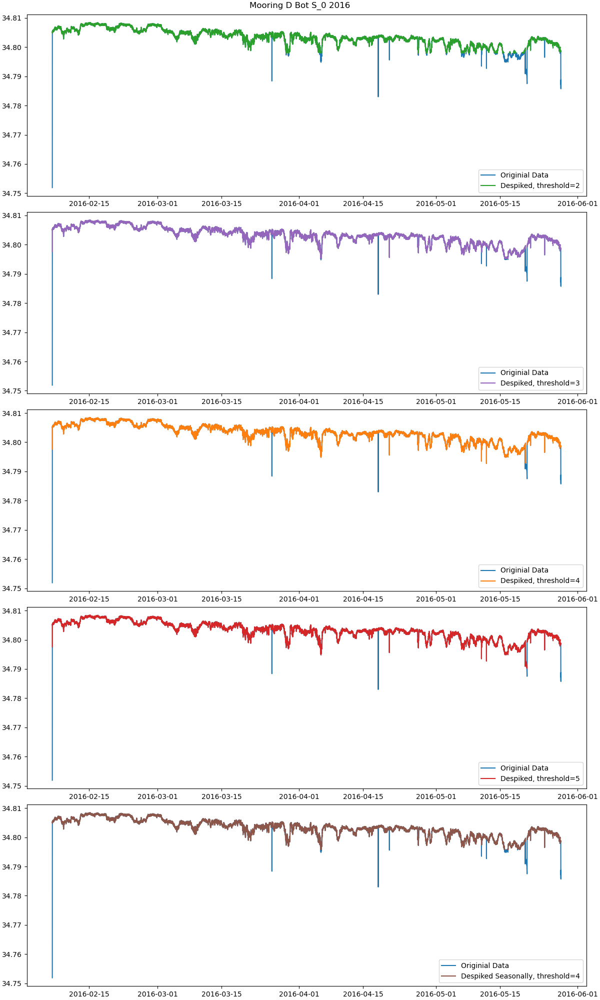

In [158]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_0 2016')

In [159]:
outliers_2 = get_outliers(data=data,threshold=2)
outliers_3 = get_outliers(data=data,threshold=3)
outliers_4 = get_outliers(data=data,threshold=4)
outliers_5 = get_outliers(data=data,threshold=5)

flagged_times_2 = outliers_2.outlier_values.dropna(dim="time").time.values
flagged_times_3 = outliers_3.outlier_values.dropna(dim="time").time.values
flagged_times_4 = outliers_4.outlier_values.dropna(dim="time").time.values
flagged_times_5 = outliers_5.outlier_values.dropna(dim="time").time.values

In [163]:
# need to crop start and end 
D_2016_ctd_bot = D_2016_ctd_bot.sel(time = slice('2016-02-06T22:20','2016-05-28T06:00'))



In [166]:
time0 = np.datetime64('2016-03-26T00:32:00.000000000')
time1 = np.datetime64('2016-04-18T07:27:00.000000000')
time2 = np.datetime64('2016-05-20T11:57:00.000000000')
time3 = np.datetime64('2016-04-20T18:02:00.000000000')
time4 = np.datetime64('2016-05-10T22:07:00.000000000')
time5 = np.datetime64('2016-05-12T00:22:00.000000000')

In [167]:
D_2016_ctd_bot['sal'] = ('time',D_2016_ctd_bot.S_0.data)

In [168]:
D_2016_ctd_bot['sal'].loc[dict(time=time0)] = np.nan
D_2016_ctd_bot['sal'].loc[dict(time=time1)] = np.nan
D_2016_ctd_bot['sal'].loc[dict(time=time2)] = np.nan
D_2016_ctd_bot['sal'].loc[dict(time=time3)] = np.nan
D_2016_ctd_bot['sal'].loc[dict(time=time4)] = np.nan
D_2016_ctd_bot['sal'].loc[dict(time=time5)] = np.nan



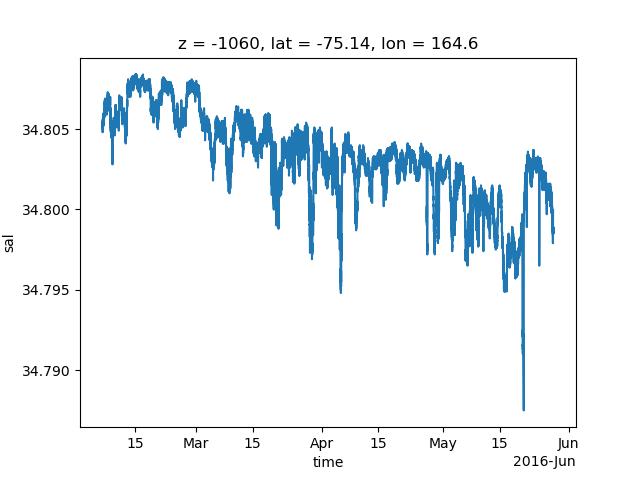

In [169]:
fig = plt.figure()
D_2016_ctd_bot.sal.plot()

#### 2017 

In [172]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2017_ctd_bot.S_0)

Text(0.5, 0.98, 'Mooring D Bot S_0 2017')

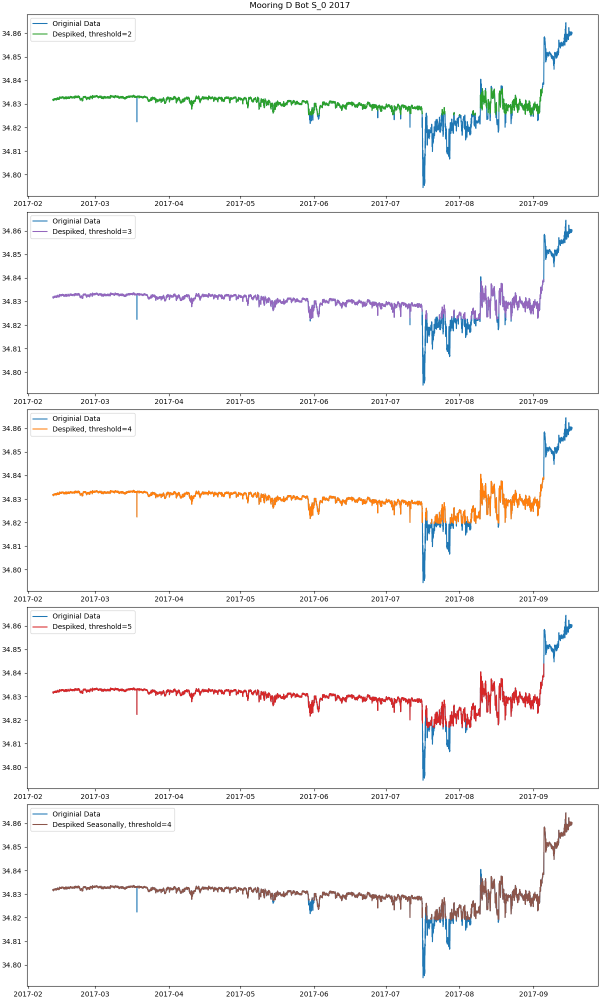

In [174]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_0 2017')

In [176]:
time0 = np.datetime64('2017-03-18T14:35:00.000000000')

In [177]:
D_2017_ctd_bot['sal'] = ('time', D_2017_ctd_bot.S_0.data)

In [178]:
D_2017_ctd_bot['sal'].loc[dict(time=time0)] = np.nan

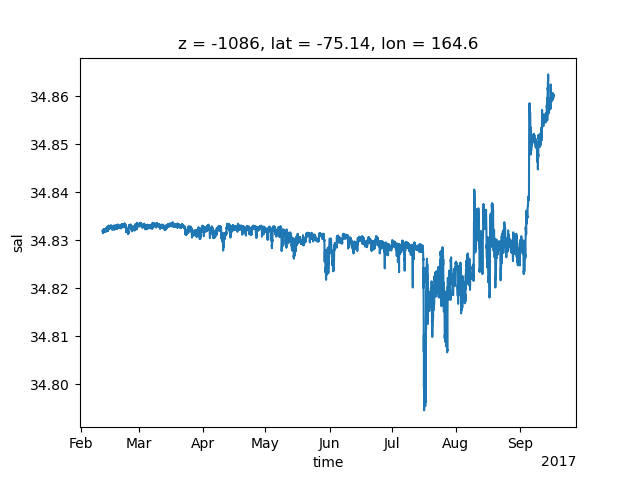

In [179]:
fig = plt.figure()
D_2017_ctd_bot.sal.plot()

##### 2019

In [180]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2019_ctd_bot.S_2)

Text(0.5, 0.98, 'Mooring D Bot S_2 2019')

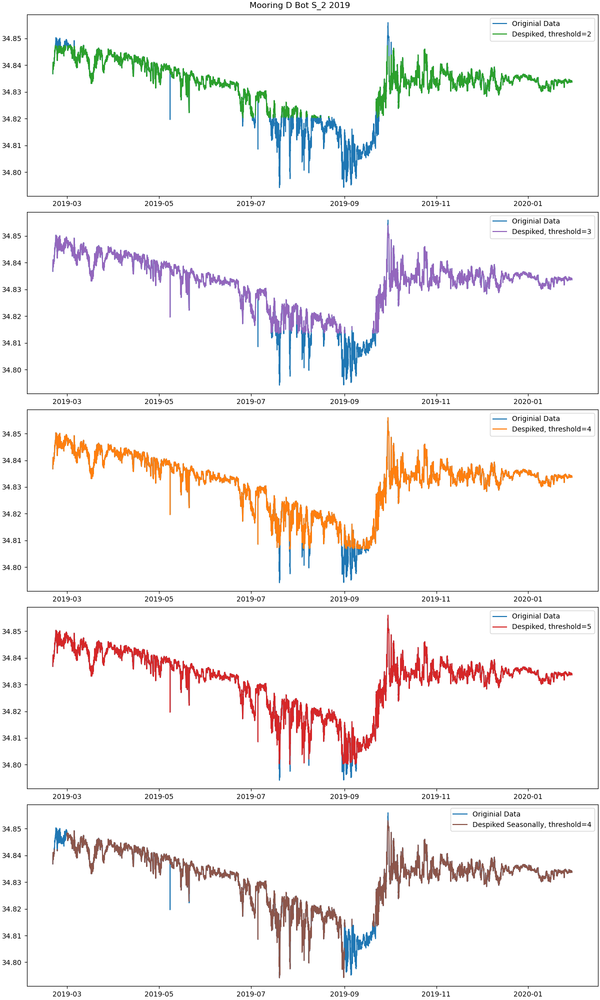

In [181]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_2 2019')

In [184]:
time0 = np.datetime64('2019-07-05T17:30')

In [191]:
time1 = np.datetime64('2019-05-08T10:00:00.000000000')

In [185]:
D_2019_ctd_bot['sal'] = ('time', D_2019_ctd_bot.S_2.data)

In [193]:
D_2019_ctd_bot['sal'].loc[dict(time=time0)] = np.nan
D_2019_ctd_bot['sal'].loc[dict(time=time1)] = np.nan

In [194]:
# no despiking necessary for 2019 
# dt['D']['2019']['ctd']['bot']['sal'] = dt['D']['2019']['ctd']['bot']['S_2'].copy()

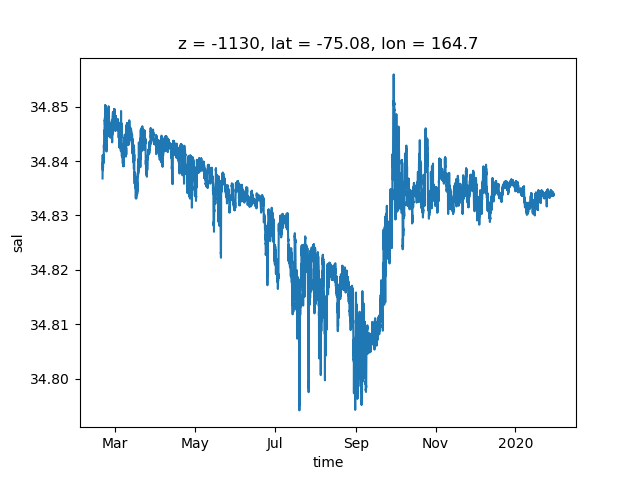

In [195]:
fig = plt.figure()
D_2019_ctd_bot.sal.plot()

##### 2021

In [196]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2021_ctd_bot.S_2)

Text(0.5, 0.98, 'Mooring D Bot S_2 2021')

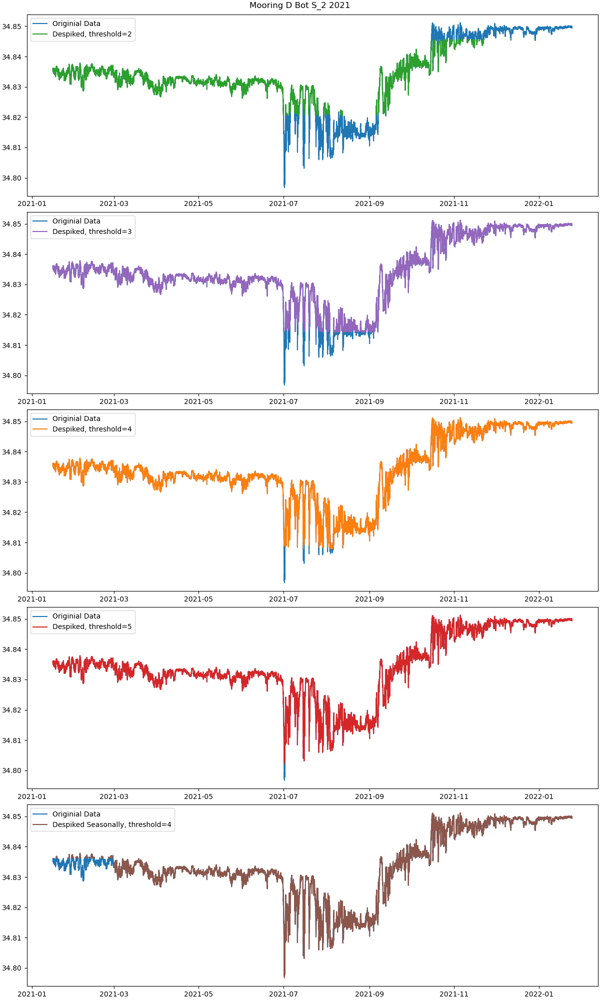

In [197]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_2 2021')

In [198]:
D_2021_ctd_bot['sal'] = ('time', D_2021_ctd_bot.S_2.data)

In [199]:
# no despiking necesary 
# dt['D']['2021']['ctd']['bot']['sal'] = dt['D']['2021']['ctd']['bot']['S_2'].copy()

##### 2023

In [200]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2023_ctd_bot.S_2)

Text(0.5, 0.98, 'Mooring D Bot S_2 2023')

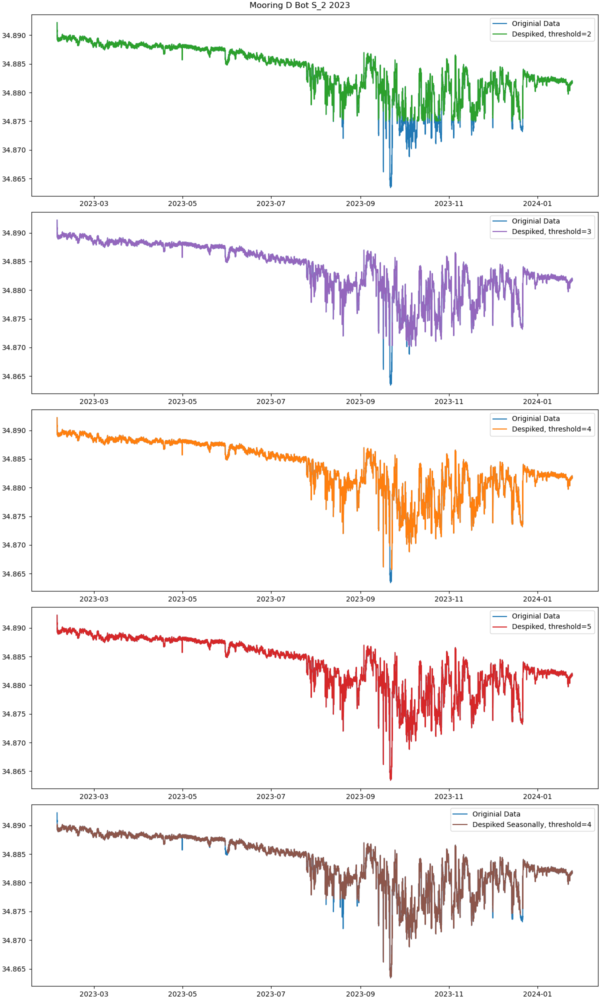

In [201]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_2 2023')

In [204]:
time0 = np.datetime64('2023-04-30T18:15:00.000000000')

In [207]:
D_2023_ctd_bot['sal'] = ('time', D_2023_ctd_bot.S_2.data)

In [208]:
D_2023_ctd_bot['sal'].loc[dict(time=time0)] = np.nan

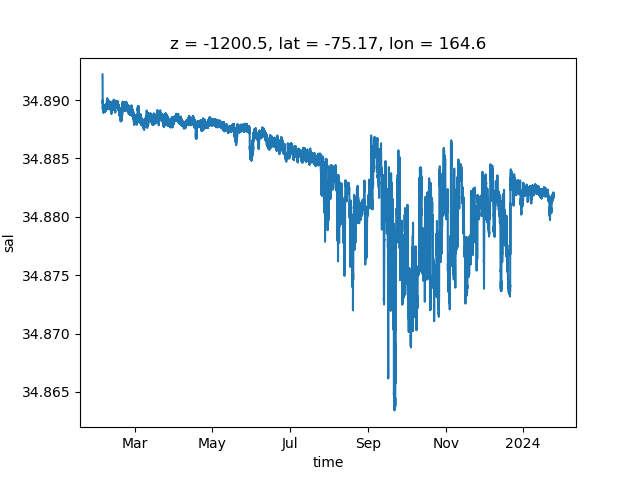

In [211]:
fig = plt.figure()
D_2023_ctd_bot.sal.plot()

In [ ]:
# crop first few points - first few points look like it could be real data 

In [212]:
# not despiking 2023 - first spike may be an outlier but will keep for now 
# dt['D']['2023']['ctd']['bot']['sal'] = dt['D']['2023']['ctd']['bot']['S_2'].copy()

##### 2024

In [213]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2024_ctd_bot.S_2)

Text(0.5, 0.98, 'Mooring D Bot S_2 2024')

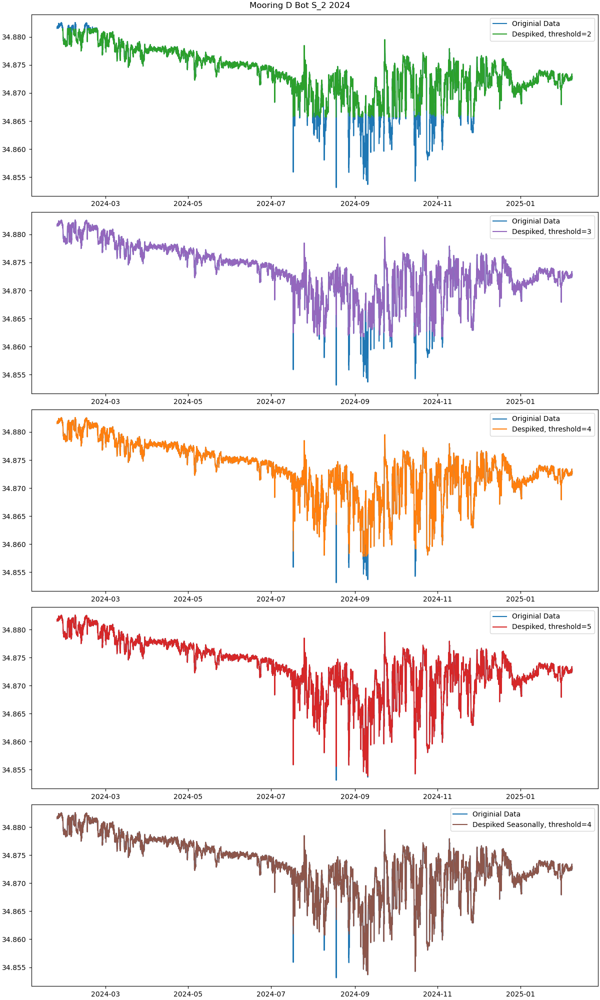

In [214]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Bot S_2 2024')

In [215]:
D_2024_ctd_bot['sal'] = ('time', D_2024_ctd_bot.S_2.data)

In [216]:
# not despiking 
# dt['D']['2024']['ctd']['bot']['sal'] = dt['D']['2024']['ctd']['bot']['S_2'].copy()

In [217]:
# years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['year'].unique()
# fig = plt.figure(figsize=(12,4))
# # plot_timeseries(years=years,var='S_0',mooring='D',instrument='ctd',position='bot',color='tab:blue',label='S_0')
# # plot_timeseries(years=years,var='S_1',mooring='D',instrument='ctd',position='bot',color='tab:green',label='S_1')
# plot_timeseries(years=years,var='S_2',mooring='D',instrument='ctd',position='bot',color='tab:red',label='S_2')
# plot_timeseries(years=years,var='sal',mooring='D',instrument='ctd',position='bot',color='tab:blue',label='sal')

# # get handles and labels for legend 
# handles, labels = plt.gca().get_legend_handles_labels()
# # only picks unique labels / handles 
# unique = dict(zip(labels, handles))
# # makes legend with unique keys only 
# plt.legend(unique.values(), unique.keys())

# # set limits on plot 
# plt.ylim(34.6,34.95)
# plt.ylabel('Salinity')
# plt.suptitle('Salinity at Mooring D Bot Sensor')

Notes on salinity preprocessing: 

For mooring D, level S_2 data was used when availble. S_2 data was unavailabe for bottom sensor for the years 2016 and 2017, and top sensor for 2016. For these years, only level 0 salinity data is available. The top sensor showed more of a difference between level 2 and 0 data, while the bottom sensor did not show much of a difference. Perhaps it is ok to use level 0 salinity data for the bottom sensor, but not the top due to the larger discrepency. None of the level 2 data or level 0 data was despiked. I applied the modified zscore at various thresholds (2-5) for each time series, computed over the entire time series and seasonally, and viewed the effects of outlier detection on each time series to decide on which threshold to implement. This varied between timeseries likely due to the inherent variability. Only spikes that appeared as true spikes were removed, any data that could perhaps be a real signal (based on neighboring points, etc..) was kept. For each dataset in the datatree, a new variable named 'sal' was added, which is despiked level 2 data. This is the variable to use going forward for salinity. Note that mid1 sensor does not have salinity data until 2017 and in 2020 salinity data was sampled at mid2 position, not mid1, but depths are close enough in range and can likely be included together to represent mid depth 

#### Despike Temperature 

In [218]:
data, data_despiked_2, data_despiked_3, data_despiked_4, data_despiked_5, data_despiked_seasonal, flagged_times_seasonal = get_despiked_data(data = D_2014_ctd_top.T_2)

Text(0.5, 0.98, 'Mooring D Top T_2 2014')

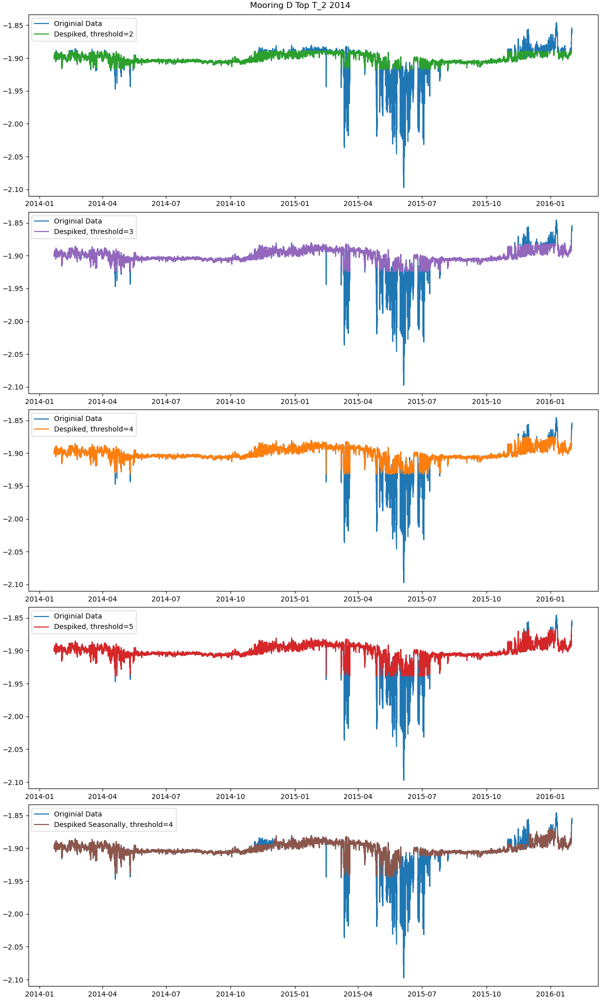

In [219]:
ax0, ax1, ax2, ax3, ax4 = plot_despiked_data()
# ax0.set_ylim(34.4,34.6)
# ax1.set_ylim(34.4,34.6)
# ax2.set_ylim(34.4,34.6)
# ax3.set_ylim(34.4,34.6)
# ax4.set_ylim(33.8,34.6)
plt.suptitle('Mooring D Top T_2 2014')

In the above plot, we can see that the modified zscore method of outlier detection does not work well on the temperature data. Too much real data is removed. Based on the preliminary plots in the beginning of the notebook, there are not a lot of concerning spikes in the level S_2 data. I will use the level S_2 data as is, and will rename to 'temp' in each dataset. Theta_0 variable has some concerning spikes in it. Level 2 temp data is not available for top sensor in 2016, and bottom sensor in 2016 and 2017. 

In [89]:
# data table 
df.query("mooring == 'D' & position == 'top' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
1,D,2014,ctd,top,-509,"[S_0, T_0, S_2, S_1, T_2]",2014-01-22 00:00:00,2016-01-31 10:00:00,0 days 00:30:00,35493.0
8,D,2016,ctd,top,-523,"[Theta_0, S_0, Conductivity]",2016-02-06 22:05:00,2016-09-14 21:45:00,0 days 00:05:00,63645.0
16,D,2017,ctd,top,-556,"[T_0, S_0, Conductivity, S_2, T_2]",2017-02-11 07:00:00,2019-02-18 23:00:00,0 days 00:30:00,35409.0
23,D,2019,ctd,top,-574,"[T_0, S_0, Theta_0, Turbidity, S_2, T_2]",2019-02-19 17:45:00,2020-01-30 01:45:00,0 days 00:30:00,16529.0
29,D,2020,ctd,top,-612.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 14:22:00,2021-01-07 22:22:00,0 days 00:30:00,16385.0
35,D,2021,ctd,top,-543.6,"[T_0, S_0, Turbidity, S_2, T_2]",2021-01-15 22:06:00,2022-01-24 21:36:00,0 days 00:30:00,17952.0
41,D,2022,ctd,top,-526.1,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2022-02-01 04:40:00,2023-01-25 07:10:00,0 days 00:30:00,17190.0


In [220]:
# add temp variable to top ctd datasets 

D_2014_ctd_top['temp'] = ('time', D_2014_ctd_top.T_2.data)
D_2017_ctd_top['temp'] = ('time', D_2017_ctd_top.T_2.data)
D_2019_ctd_top['temp'] = ('time', D_2019_ctd_top.T_2.data)
D_2020_ctd_top['temp'] = ('time', D_2020_ctd_top.T_2.data)
D_2021_ctd_top['temp'] = ('time', D_2021_ctd_top.T_2.data)
D_2022_ctd_top['temp'] = ('time', D_2022_ctd_top.T_2.data)

In [221]:
# years = df.query("mooring == 'D' & position == 'top' & instrument == 'ctd'")['year'].unique()

In [222]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['ctd']['top']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

In [223]:
# years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")['year'].unique()
# fig = plt.figure(figsize=(12,4))
# # plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='top',color='tab:blue',label='T_0')
# # plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='top',color='tab:orange',label='Theta_0')
# plot_timeseries(years=years,var='temp',mooring='D',instrument='ctd',position='top',color='tab:green',label='temp')
# plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='top',color='tab:red',label='T_2')

# # get handles and labels for legend 
# handles, labels = plt.gca().get_legend_handles_labels()
# # only picks unique labels / handles 
# unique = dict(zip(labels, handles))
# # makes legend with unique keys only 
# plt.legend(unique.values(), unique.keys())

# # set limits on plot 
# plt.ylim(-2.15,-1.8)
# plt.ylabel('Temp')
# plt.suptitle('Temp at Mooring D Top Sensor')

In [94]:
df.query("mooring == 'D' & position == 'mid1' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
15,D,2017,ctd,mid1,-772,"[T_0, S_0, Conductivity, Theta_0, Density, S_2...",2017-02-11 07:25:00,2019-02-18 23:25:00,0 days 00:30:00,35409.0
22,D,2019,ctd,mid1,-790,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 18:00:00,2020-01-30 03:00:00,0 days 00:30:00,16531.0
34,D,2021,ctd,mid1,-759.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 22:40:00,2022-01-24 22:10:00,0 days 00:30:00,17952.0
40,D,2022,ctd,mid1,-745.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2022-02-01 04:50:00,2023-01-25 07:20:00,0 days 00:30:00,17190.0
46,D,2023,ctd,mid1,-926.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, Densi...",2023-02-03 05:41:00,2024-01-24 19:11:00,0 days 00:30:00,17068.0
51,D,2024,ctd,mid1,-898,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 09:39:27,2025-02-08 05:09:27,0 days 00:30:00,18232.0


In [224]:
# add temp variable to mid1 datasets 
D_2017_ctd_mid1['temp'] = ('time',D_2017_ctd_mid1.T_2.data)
D_2019_ctd_mid1['temp'] = ('time',D_2019_ctd_mid1.T_2.data)
D_2021_ctd_mid1['temp'] = ('time',D_2021_ctd_mid1.T_2.data)
D_2022_ctd_mid1['temp'] = ('time',D_2022_ctd_mid1.T_2.data)
D_2023_ctd_mid1['temp'] = ('time',D_2023_ctd_mid1.T_2.data)
D_2024_ctd_mid1['temp'] = ('time',D_2024_ctd_mid1.T_2.data)

In [225]:
# years = df.query("mooring == 'D' & position == 'mid1' & instrument == 'ctd'")['year'].unique()

In [226]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['ctd']['mid1']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

In [98]:
df.query("mooring == 'D' & position == 'mid1' & instrument == 'temp'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
2,D,2014,temp,mid1,-739,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
9,D,2016,temp,mid1,-749,"[T_0, T_2]",2016-02-06 22:06:00,2017-01-08 21:16:00,0 days 00:10:00,48524.0
30,D,2020,temp,mid1,-837.5,"[T_0, T_2]",2020-02-01 14:05:27,2021-01-07 21:35:27,0 days 00:30:00,16384.0


In [228]:
# add temp to temp datasets above 
D_2014_temp_mid1['temp'] = ('time', D_2014_temp_mid1.T_2.data)
D_2016_temp_mid1['temp'] = ('time', D_2016_temp_mid1.T_2.data)
D_2020_temp_mid1['temp'] = ('time', D_2020_temp_mid1.T_2.data)

In [229]:
# years = df.query("mooring == 'D' & position == 'mid1' & instrument == 'temp'")['year'].unique()

In [230]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['temp']['mid1']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

Text(0.5, 0.98, 'Temp at Mooring D mid1 Sensor')

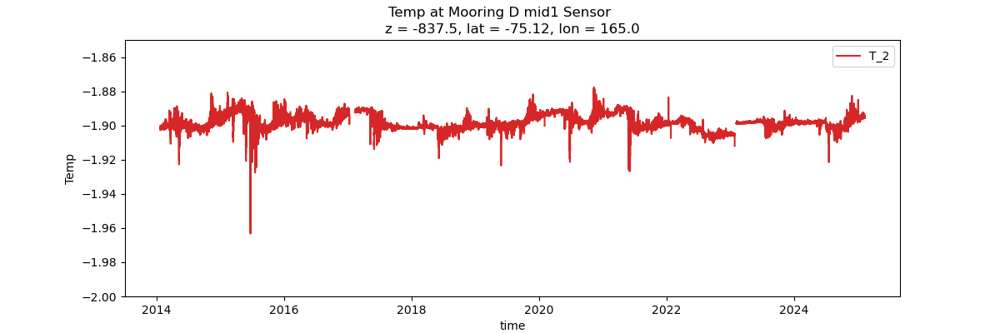

In [231]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()
fig = plt.figure(figsize=(12,4))
# plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='mid1',color='tab:blue',label='T_0')
# plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='mid1',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='temp',mooring='D',instrument='ctd',position='mid1',color='tab:green',label='temp')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='mid1',color='tab:red',label='T_2')

# account for temp collected by thermistors, not ctds 
years = df.query("mooring == 'D' & instrument == 'temp' & position == 'mid1'")['year'].unique()
# plot_timeseries(years=years,var='T_0',mooring='D',instrument='temp',position='mid1',color='tab:blue',label='T_0')
# plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='temp',position='mid1',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='temp',mooring='D',instrument='temp',position='mid1',color='tab:green',label='temp')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='temp',position='mid1',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D mid1 Sensor')

In [232]:
df.query("mooring == 'D' & position == 'mid2' & instrument == 'temp'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
68,D,2014,temp,mid2,-966,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
75,D,2016,temp,mid2,-888,"[T_0, T_2]",2016-02-06 22:10:00,2017-01-08 21:10:00,0 days 00:10:00,48523.0
82,D,2017,temp,mid2,-996,"[T_0, T_2]",2017-02-11 07:15:20,2019-02-18 23:15:20,0 days 00:30:00,35409.0
89,D,2019,temp,mid2,-1014,"[T_0, T_2]",2019-02-19 19:00:00,2020-01-30 02:30:00,0 days 00:30:00,16528.0
101,D,2021,temp,mid2,-984.5,"[T_0, T_2]",2021-01-15 22:24:00,2022-01-24 21:54:00,0 days 00:30:00,17952.0
107,D,2022,temp,mid2,-971.5,"[T_0, T_2]",2022-02-01 04:40:00,2023-01-25 07:10:00,0 days 00:30:00,17190.0
112,D,2023,temp,mid2,-1163.5,"[T_0, T_2]",2023-02-03 05:30:00,2024-01-24 19:30:00,0 days 00:30:00,17069.0
117,D,2024,temp,mid2,1162,"[T_0, T_2]",2024-01-25 09:52:16,2025-02-08 04:52:16,0 days 00:30:00,18231.0


In [233]:
# add temp data to mid2 temp datasets 
D_2014_temp_mid2['temp'] = ('time', D_2014_temp_mid2.T_2.data)
D_2016_temp_mid2['temp'] = ('time', D_2016_temp_mid2.T_2.data)
D_2017_temp_mid2['temp'] = ('time', D_2017_temp_mid2.T_2.data)
D_2019_temp_mid2['temp'] = ('time', D_2019_temp_mid2.T_2.data)
D_2021_temp_mid2['temp'] = ('time', D_2021_temp_mid2.T_2.data)
D_2022_temp_mid2['temp'] = ('time', D_2022_temp_mid2.T_2.data)
D_2023_temp_mid2['temp'] = ('time', D_2023_temp_mid2.T_2.data)
D_2024_temp_mid2['temp'] = ('time', D_2024_temp_mid2.T_2.data)


In [234]:
# years = df.query("mooring == 'D' & position == 'mid2' & instrument == 'temp'")['year'].unique()

In [235]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['temp']['mid2']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

In [236]:
df.query("mooring == 'D' & position == 'mid2' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
53,D,2010,ctd,mid2,-950,[T_0],2010-02-06 02:23:00,2012-01-23 15:18:00,0 days 00:05:00,206364.0
60,D,2012,ctd,mid2,-966,[T_0],2012-02-01 22:30:00,2014-01-11 15:00:00,0 days 00:10:00,102196.0
93,D,2020,ctd,mid2,-922,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 13:29:00,2021-01-07 21:29:00,0 days 00:30:00,16385.0


In [237]:
# add temp to mid2 ctd dataset 
D_2020_ctd_mid2['temp'] = ('time', D_2020_ctd_mid2.T_2.data)

In [238]:
# years = df.query("mooring == 'D' & position == 'mid2' & instrument == 'ctd'")['year'].unique()

In [239]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['ctd']['mid2']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

Text(0.5, 0.98, 'Temp at Mooring D mid2 Sensor')

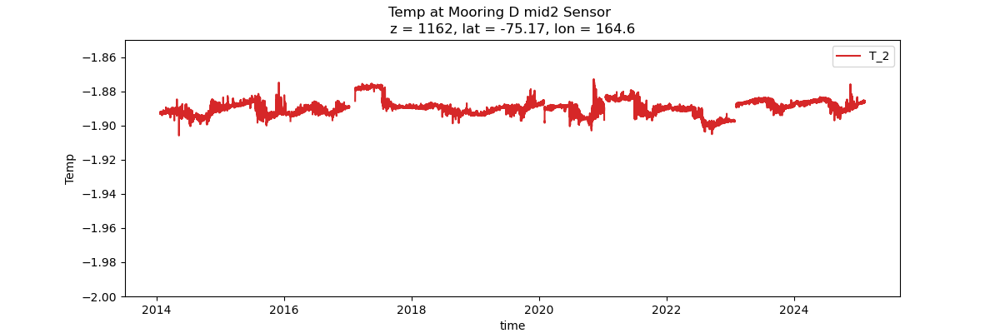

In [240]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")['year'].unique()
fig = plt.figure(figsize=(12,4))
# plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='mid2',color='tab:blue',label='T_0')
# plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='mid2',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='temp',mooring='D',instrument='ctd',position='mid2',color='tab:green',label='temp')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='mid2',color='tab:red',label='T_2')

# account for temp collected by thermistors, not ctds 
years = df.query("mooring == 'D' & instrument == 'temp' & position == 'mid2'")['year'].unique()
# plot_timeseries(years=years,var='T_0',mooring='D',instrument='temp',position='mid2',color='tab:blue',label='T_0')
# plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='temp',position='mid2',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='temp',mooring='D',instrument='temp',position='mid2',color='tab:green',label='temp')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='temp',position='mid2',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D mid2 Sensor')

In [241]:
df.query("mooring == 'D' & position == 'bot' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
48,D,2008,ctd,bot,-1062,"[T_0, S_0, Turb_0, Tpot_0, T_1, S_1, Turb_1, T...",2008-01-31 02:50:54,2010-02-03 10:20:54,0 days 00:30:00,35248.0
51,D,2010,ctd,bot,-1036,"[T_0, S_0, S_1, T_1, S_2]",2010-02-06 02:34:00,2012-01-23 15:04:00,0 days 00:30:00,34394.0
58,D,2012,ctd,bot,-1069,"[S_0, T_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 14:30:00,0 days 00:30:00,34065.0
65,D,2014,ctd,bot,-1069,"[T_0, S_0, S_1, S_2, T_2]",2014-01-22 13:30:00,2016-02-01 17:00:00,0 days 00:30:00,35528.0
72,D,2016,ctd,bot,-1060,"[Theta_0, S_0, Conductivity]",2016-02-06 22:02:00,2016-05-28 07:47:00,0 days 00:05:00,32086.0
79,D,2017,ctd,bot,-1086,"[T_0, S_0, Conductivity, Theta_0, Oxygen, Dept...",2017-02-11 07:35:00,2017-09-17 03:05:00,0 days 00:30:00,10456.0
86,D,2019,ctd,bot,-1130,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 16:00:00,2020-01-30 01:00:00,0 days 00:30:00,16531.0
98,D,2021,ctd,bot,-1073.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 21:59:00,2022-01-24 21:29:00,0 days 00:30:00,17952.0
110,D,2023,ctd,bot,-1200.5,"[T_0, S_0, S_2, T_2]",2023-02-03 08:45:00,2024-01-24 22:45:00,0 days 00:30:00,17069.0
115,D,2024,ctd,bot,-1176,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 10:07:56,2025-02-08 05:07:56,0 days 00:30:00,18231.0


In [242]:
# add temp variable to bottom ctd datasets 
# note 2017 and 2016 do not have T_2 data - will use T_0 data for 2017, theta_0 for 2016 looks too off to use 
D_2014_ctd_bot['temp'] = ('time',D_2014_ctd_bot.T_2.data)
D_2017_ctd_bot['temp'] = ('time',D_2017_ctd_bot.T_0.data)
D_2019_ctd_bot['temp'] = ('time',D_2019_ctd_bot.T_2.data)
D_2021_ctd_bot['temp'] = ('time',D_2021_ctd_bot.T_2.data)
D_2023_ctd_bot['temp'] = ('time',D_2023_ctd_bot.T_2.data)
D_2024_ctd_bot['temp'] = ('time',D_2024_ctd_bot.T_2.data)


In [243]:
# years = df.query("mooring == 'D' & position == 'bot' & instrument == 'ctd'")['year'].unique()

In [244]:
# for i in range(len(years)):
#     var = 'T_2'
#     ds = dt['D'][years[i]]['ctd']['bot']
#     if var in ds.data_vars:
#         ds['temp'] = ds['T_2']
#     else:
#         print('no')

Text(0.5, 0.98, 'Temp at Mooring D bot Sensor')

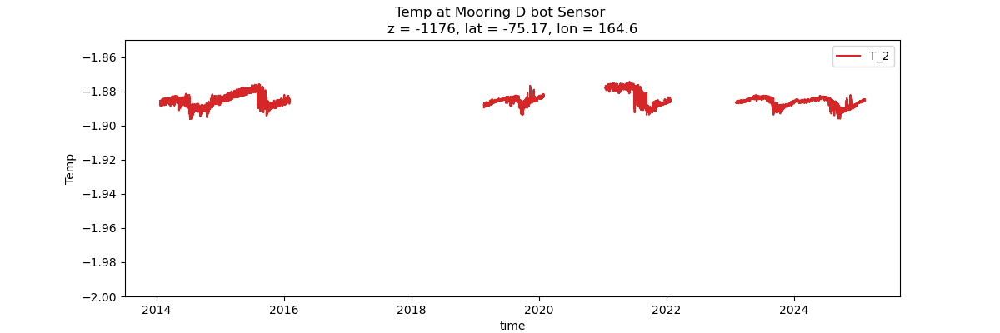

In [245]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")['year'].unique()
fig = plt.figure(figsize=(12,4))
# plot_timeseries(years=years,var='T_0',mooring='D',instrument='ctd',position='bot',color='tab:blue',label='T_0')
# plot_timeseries(years=years,var='Theta_0',mooring='D',instrument='ctd',position='bot',color='tab:orange',label='Theta_0')
plot_timeseries(years=years,var='temp',mooring='D',instrument='ctd',position='bot',color='tab:green',label='temp')
plot_timeseries(years=years,var='T_2',mooring='D',instrument='ctd',position='bot',color='tab:red',label='T_2')

# get handles and labels for legend 
handles, labels = plt.gca().get_legend_handles_labels()
# only picks unique labels / handles 
unique = dict(zip(labels, handles))
# makes legend with unique keys only 
plt.legend(unique.values(), unique.keys())

# set limits on plot 
plt.ylim(-2,-1.85)
plt.ylabel('Temp')
plt.suptitle('Temp at Mooring D bot Sensor')

### Rename Variables in CTD and temp datasets 

In [260]:
dataset_names

['D_2014_vel_top',
 'D_2014_vel_mid',
 'D_2014_vel_bot',
 'D_2014_ctd_top',
 'D_2014_temp_mid1',
 'D_2014_temp_mid2',
 'D_2014_ctd_bot',
 'D_2016_vel_top',
 'D_2016_vel_mid',
 'D_2016_vel_bot',
 'D_2016_ctd_top',
 'D_2016_temp_mid1',
 'D_2016_temp_mid2',
 'D_2016_ctd_bot',
 'D_2017_vel_top',
 'D_2017_vel_mid',
 'D_2017_vel_bot',
 'D_2017_ctd_top',
 'D_2017_ctd_mid1',
 'D_2017_temp_mid2',
 'D_2017_ctd_bot',
 'D_2019_vel_top',
 'D_2019_vel_mid',
 'D_2019_vel_bot',
 'D_2019_ctd_top',
 'D_2019_ctd_mid1',
 'D_2019_temp_mid2',
 'D_2019_ctd_bot',
 'D_2020_vel_top',
 'D_2020_vel_mid',
 'D_2020_ctd_top',
 'D_2020_temp_mid1',
 'D_2020_ctd_mid2',
 'D_2021_vel_top',
 'D_2021_vel_mid',
 'D_2021_vel_bot',
 'D_2021_ctd_top',
 'D_2021_ctd_mid1',
 'D_2021_temp_mid2',
 'D_2021_ctd_bot',
 'D_2022_vel_top',
 'D_2022_vel_mid',
 'D_2022_ctd_top',
 'D_2022_ctd_mid1',
 'D_2022_temp_mid2',
 'D_2023_vel_mid',
 'D_2023_vel_bot',
 'D_2023_ctd_mid1',
 'D_2023_temp_mid2',
 'D_2023_ctd_bot',
 'D_2024_vel_mid',
 'D_2

In [266]:
import numpy as np
import xarray as xr

def make_depth_positive(ds, depth_name="z"):
    """
    Ensure depth coordinate is numeric and positive.

    - Converts string depth to float
    - Handles invalid values safely
    - Preserves attributes
    - Sets CF-compliant metadata

    Parameters
    ----------
    ds : xr.Dataset
    depth_name : str

    Returns
    -------
    xr.Dataset
    """

    if depth_name not in ds.coords:
        return ds

    z = ds[depth_name]

    # Convert to numeric (strings → float, invalid → NaN)
    z_numeric = xr.apply_ufunc(
        lambda x: np.asarray(x, dtype="float64"),
        z,
        dask="allowed",
        vectorize=True,
    )

    # Make positive
    z_pos = np.abs(z_numeric)

    # Preserve attributes
    z_pos.attrs = z.attrs.copy()
    z_pos.attrs.update({
        "standard_name": "depth",
        "long_name": "Depth (positive downward)",
        "positive": "down",
        "units": "m"
    })

    return ds.assign_coords({depth_name: z_pos})


In [267]:
D_datasets = [make_depth_positive(ds) for ds in D_datasets]

In [268]:
D_2014_ctd_bot

<xarray.Dataset> Size: 2MB
Dimensions:  (time: 35528)
Coordinates:
  * time     (time) datetime64[ns] 284kB 2014-01-22T13:30:00 ... 2016-02-01T1...
    z        int64 8B -1069
    lat      float64 8B -75.14
    lon      float64 8B 164.6
Data variables:
    T_0      (time) float64 284kB ...
    S_0      (time) float64 284kB ...
    S_1      (time) float64 284kB ...
    S_2      (time) float64 284kB 34.78 34.78 34.78 34.78 ... 34.8 34.8 34.8
    T_2      (time) float64 284kB -1.886 -1.886 -1.887 ... -1.885 -1.886 -1.886
    sal      (time) float64 284kB 34.78 34.78 34.78 34.78 ... 34.8 34.8 34.8
    temp     (time) float64 284kB -1.886 -1.886 -1.887 ... -1.885 -1.886 -1.886
Attributes: (12/14)
    cruise_deployment:               PNRA - XXVII Expedition - 2013/14
    cruise_recovery:                 PNRA - XXVII Expedition - 2015/16
    water_depth_meters:              -1117
    instr_depth_meters:              -1069
    instr_type:                      SEACAT SBE16 
    instr_sn:                        1437
    ...                              ...
    samp_int_minutes:                30
    start_time:                      22/01/2014  13:30:00
    stop_time:                       01/02/2016  17:00:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

In [276]:
# add in attributes 
# define matadata for coorindates and variables - this will be the same for top and bottom sensor 
META_DATA = {
    "pres": {
        "long_name": "Pressure",
        "units": "dbar",
    },
    "abs_sal": {
        "long_name": "Absolute Salinity",
        "units": "g/kg",
    },
    "cons_temp": {
        "long_name": "Conservative Temperature",
        "units": "degree_Celsius",
    },
    "cons_temp_freezing": {
        "long_name": "Conservative Temperature Freezing",
        "units": "degree_Celsius",
    },
    "sigma0": {
        "long_name": "Potential Density Anomaly",
        "units": "kg/m3",
    },
    "theta": {
        "long_name": "Potential Temperature",
        "units": "degree_Celsius",
    },
    "sal": {
        "long_name": "Practical salinity",
        "units": "PSU",
    },
    "temp_freezing": {
        "long_name": "Temperature Freezing [ITS-90 deg C]",
        "units": "degree_Celsius",
    },
    "temp": {
        "long_name": "Temperature [ITS-90 deg C]",
        "units": "degree_Celsius",
    },
    "con": {
        "long_name": "Conductivity",
        "units": "S/m",
    },
    "z": {
        "long_name": "Depth",
        "units": "m",
        "description": "Depth is positive downward"
    },
    "lat": {
        "long_name": "Latitude",
        "units": "degrees_north",
    },
    "lon": {
        "long_name": "Longitude",
        "units": "degrees_east",
    },
    "u":{
        "long_name": "Eastward Velocity",
        "units": "cm/s",
    },
    "v":{
        "long_name": "Northward Velocity",
        "units": "cm/s",
    },
    "w": {
        "long_name": "Vertical Velocity",
        "units": "m/s",
    },
    "speed": {
        "long_name": "speed",
        "units": "cm/s",
    },
    "dir": {
        "long_name": "direction",
        "units": "degrees",
    },
    "mag_declination": {
        "long_name": "Magnetic Declination",
        "units": "degrees East",
        "description": "Angle between magnetic North and true North"
    },
    
    
}

In [277]:
for v, attrs in META_DATA.items():
    for i in range(len(D_datasets)):
        if v in D_datasets[i]:
            D_datasets[i][v].attrs.update(attrs)

In [278]:
for i in range(len(D_datasets)):
    D_datasets[i].to_netcdf(path='//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/working/'+dataset_names[i]+'.nc')

In [ ]:
## function for dropping variables - not doing this for now but may want to in the future 

# def drop_vars_if_exist(ds, vars_to_drop):
#     """
#     Drop variables from an xarray Dataset only if they exist.

#     Parameters
#     ----------
#     ds : xr.Dataset
#         Input dataset
#     vars_to_drop : list or iterable
#         Variable names to drop

#     Returns
#     -------
#     xr.Dataset
#         Dataset with variables dropped where applicable
#     """
#     existing = [v for v in vars_to_drop if v in ds.data_vars]
#     return ds.drop_vars(existing)


# vars_to_drop = [
#     'T_0',
#     'S_0',
#     'S_1',
#     'S_2',
#     'T_2',
#     'Theta_0'

# ]


### Preprocess Velocity Data

In [ ]:
def monthly_quiver(ds,title,xlabel,u,v):
    """ 
    """

    import matplotlib.dates as mdates
    fig, ax = plt.subplots(figsize=(12,4))
    q = plt.quiver(
        ds.time.resample(time='1M').mean().values,np.zeros_like(ds.time.resample(time='1M').mean().values, dtype=float),
        ds[u].resample(time='1M').mean(),
        ds[v].resample(time='1M').mean()
    )
    plt.quiverkey(q, X=0.90, Y=0.1, U=5, label='5 cm/s', labelpos='E')

    plt.ylabel('Velocity (m/s)')
    plt.ylim(-5,5)
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))

    # Show year once at the left
    ax.set_xlabel(xlabel)
    ax.set_title(title)

#### 2014

Text(0.5, 0.98, 'D 2014 Top')

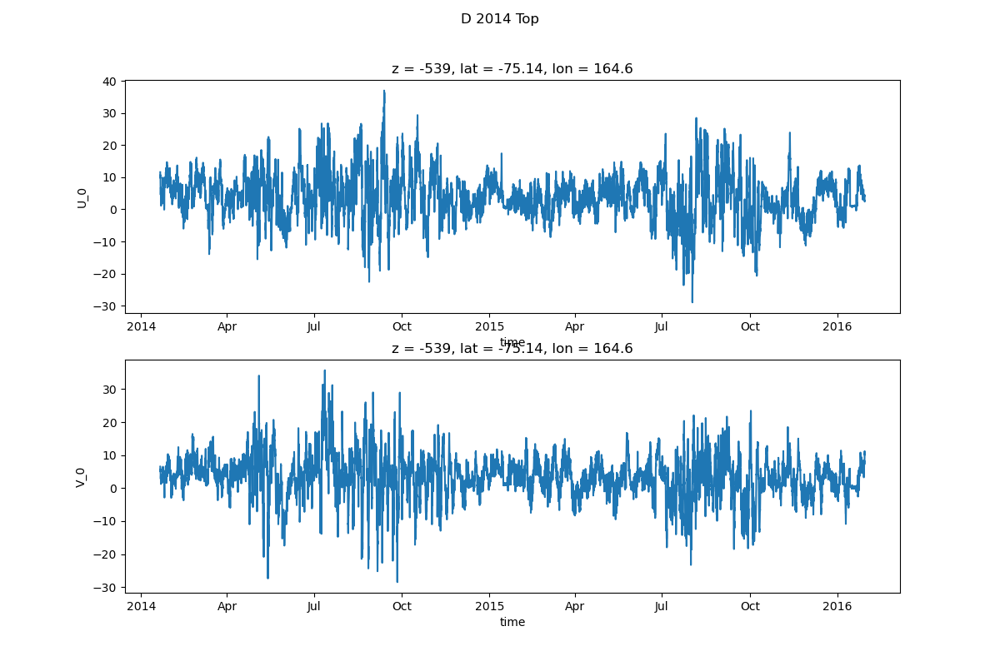

In [312]:
# nothing to remove here 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2014_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2014_vel_top.V_0.plot()

plt.suptitle('D 2014 Top')

Text(0.5, 0.98, 'D 2014 mid')

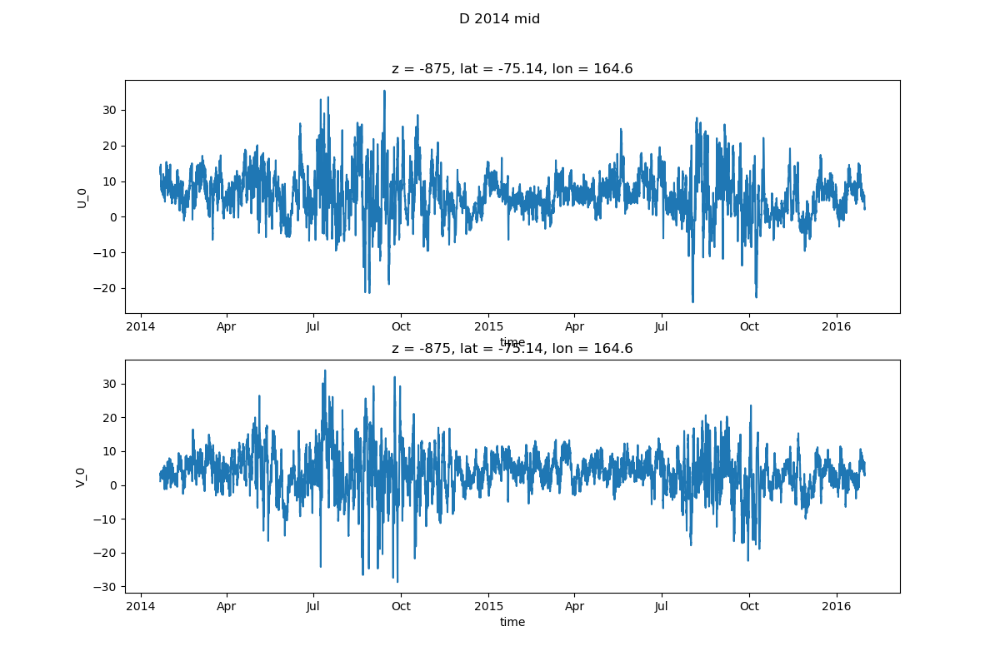

In [311]:
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2014_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2014_vel_mid.V_0.plot()

plt.suptitle('D 2014 mid')

In [310]:
# remove spike at beginning by cropping dataset 
D_2014_vel_mid = D_2014_vel_mid.sel(time=slice('2014-01-21T10:00',None))

Text(0.5, 0.98, 'D 2014 bot')

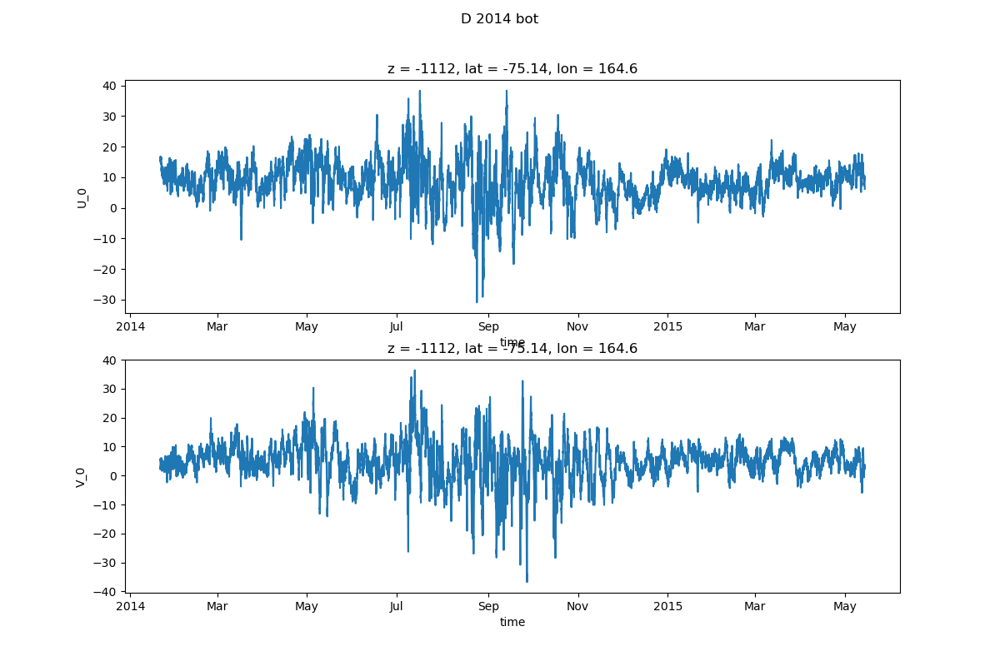

In [308]:
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2014_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2014_vel_bot.V_0.plot()

plt.suptitle('D 2014 bot')

In [307]:
# crop bottom sensor at beginning to remove large spike D
D_2014_vel_bot = D_2014_vel_bot.sel(time=slice('2014-01-21T09:00',None))

c:\Users\mblan\miniforge3\envs\TNB\Lib\site-packages\xarray\groupers.py:530: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  self.index_grouper = pd.Grouper(
c:\Users\mblan\miniforge3\envs\TNB\Lib\site-packages\xarray\groupers.py:530: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  self.index_grouper = pd.Grouper(
c:\Users\mblan\miniforge3\envs\TNB\Lib\site-packages\xarray\groupers.py:530: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  self.index_grouper = pd.Grouper(
c:\Users\mblan\miniforge3\envs\TNB\Lib\site-packages\xarray\groupers.py:530: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  self.index_grouper = pd.Grouper(


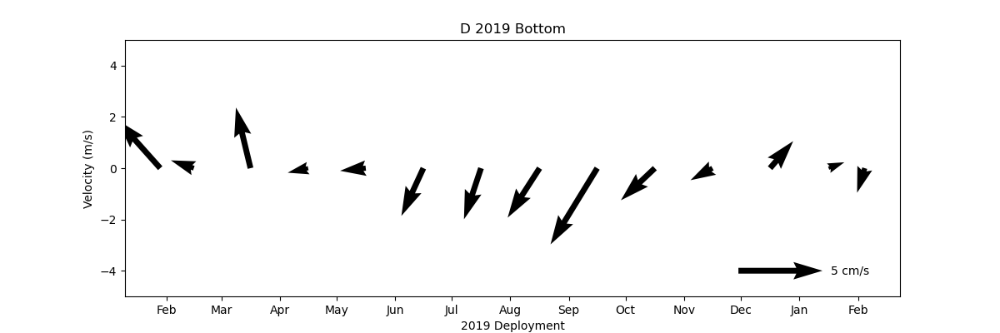

In [299]:
monthly_quiver(ds=D_2024_vel_bot, title='D 2019 Bottom', xlabel='2019 Deployment', u='U_0', v='V_0')

#### 2016

Text(0.5, 0.98, 'D 2016 top')

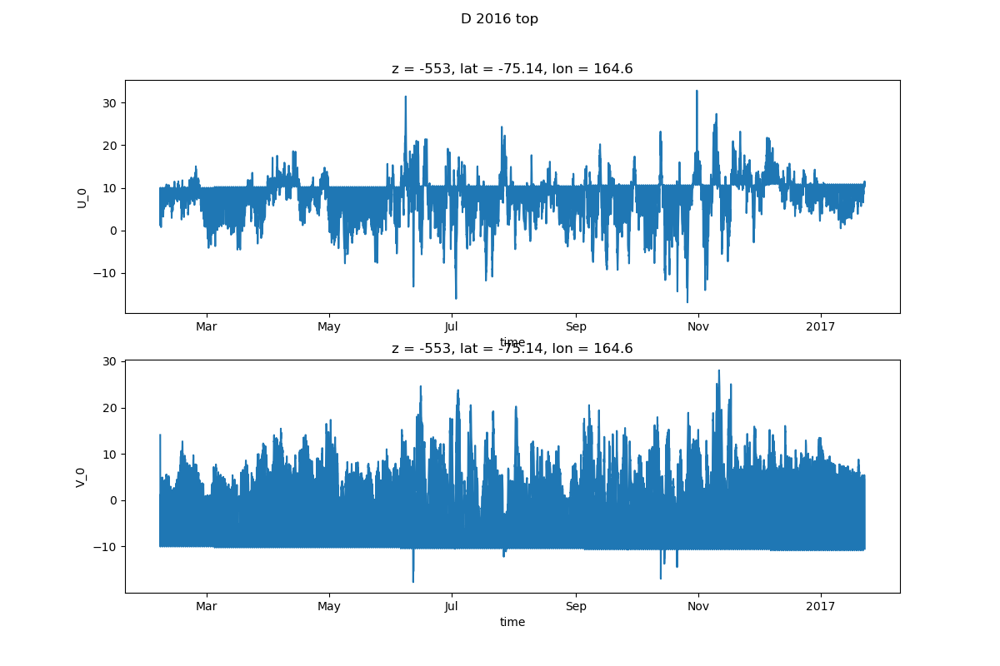

In [ ]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2016_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2016_vel_top.V_0.plot()

plt.suptitle('D 2016 top')

Text(0.5, 0.98, 'D 2016 mid')

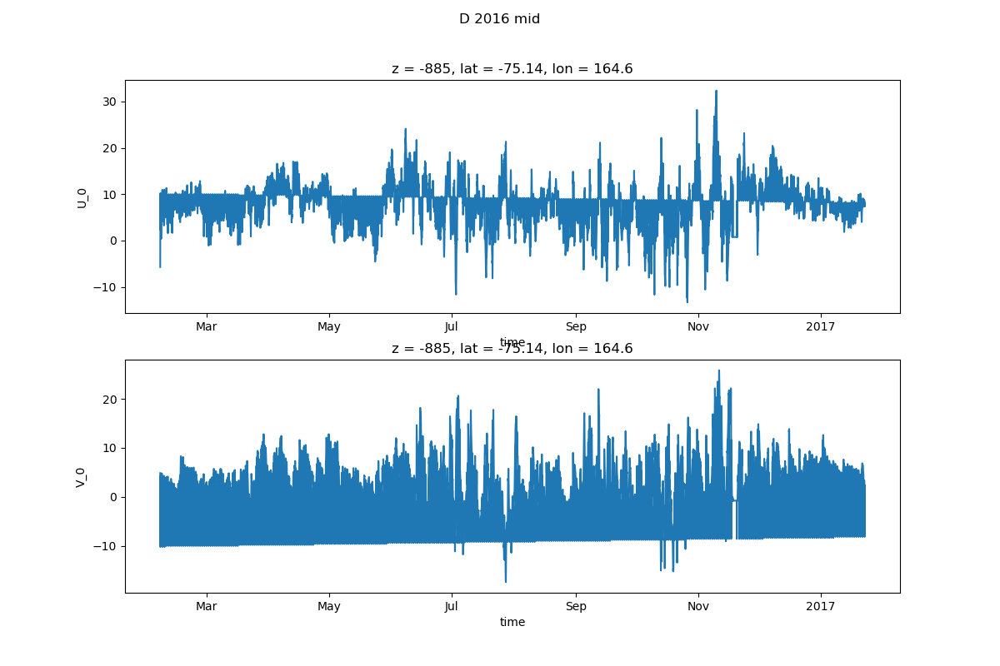

In [ ]:
# what the fuck is this? !!!! 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2016_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2016_vel_mid.V_0.plot()

plt.suptitle('D 2016 mid')

Text(0.5, 0.98, 'D 2016_bot')

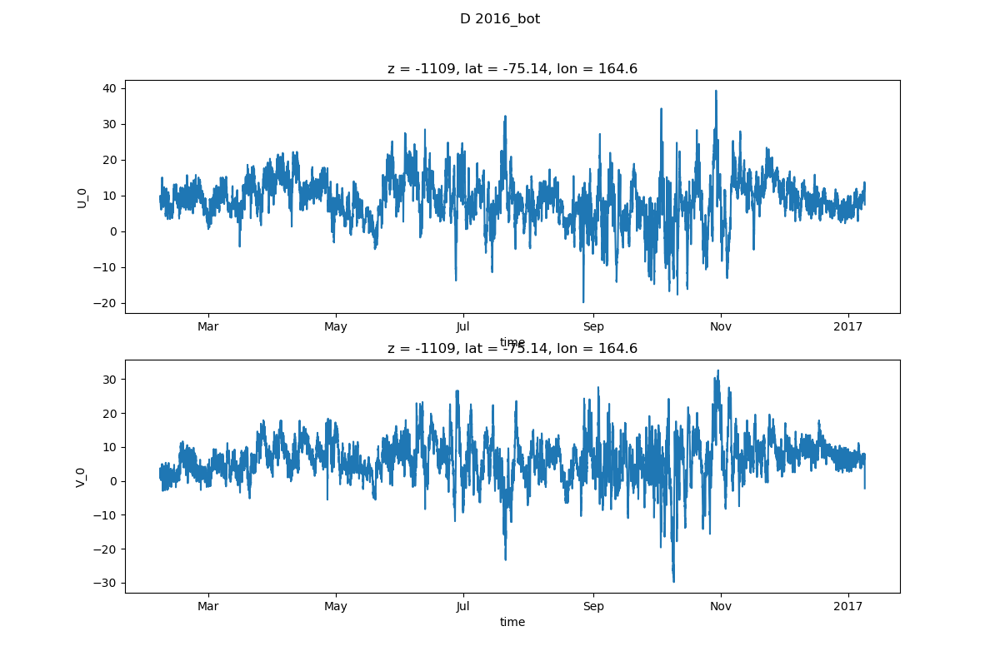

In [317]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2016_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2016_vel_bot.V_0.plot()

plt.suptitle('D 2016_bot')

In [316]:
# crop to remove first spike 
D_2016_vel_bot = D_2016_vel_bot.sel(time=slice('2016-02-06T23:00', None))

I will not use 2016 top and mid velocity data for now due to the many erroneous spikes. Need to find out if this is worth fixing. 

#### 2017

Text(0.5, 0.98, 'D 2017 Top')

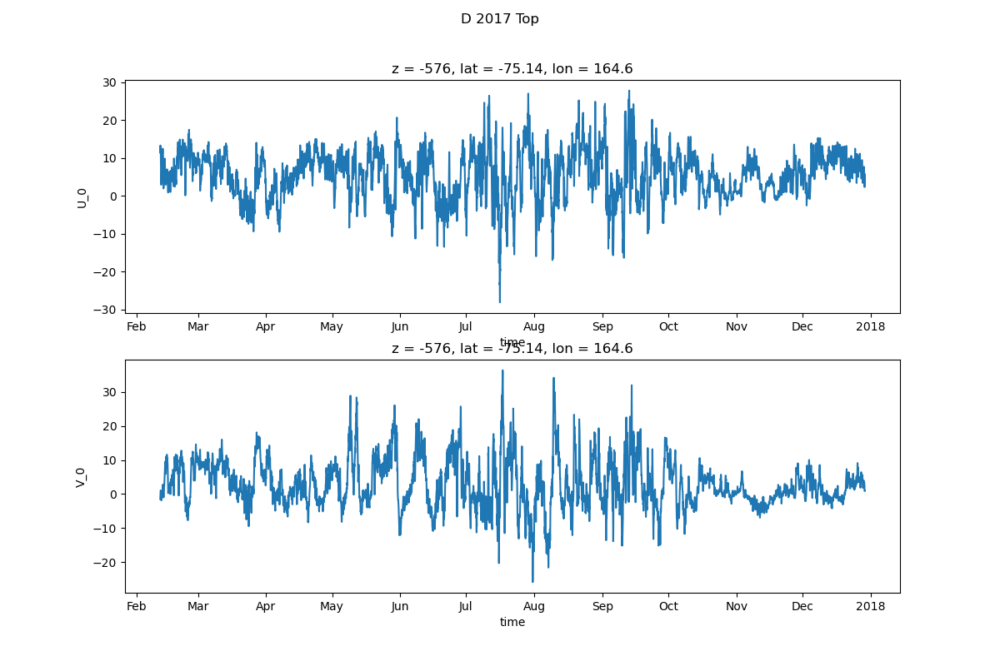

In [320]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2017_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2017_vel_top.V_0.plot()

plt.suptitle('D 2017 Top')

In [319]:
# crop to remove first spike 
D_2017_vel_top = D_2017_vel_top.sel(time=slice('2017-02-11T20:00',None))

Text(0.5, 0.98, 'D 2017 mid')

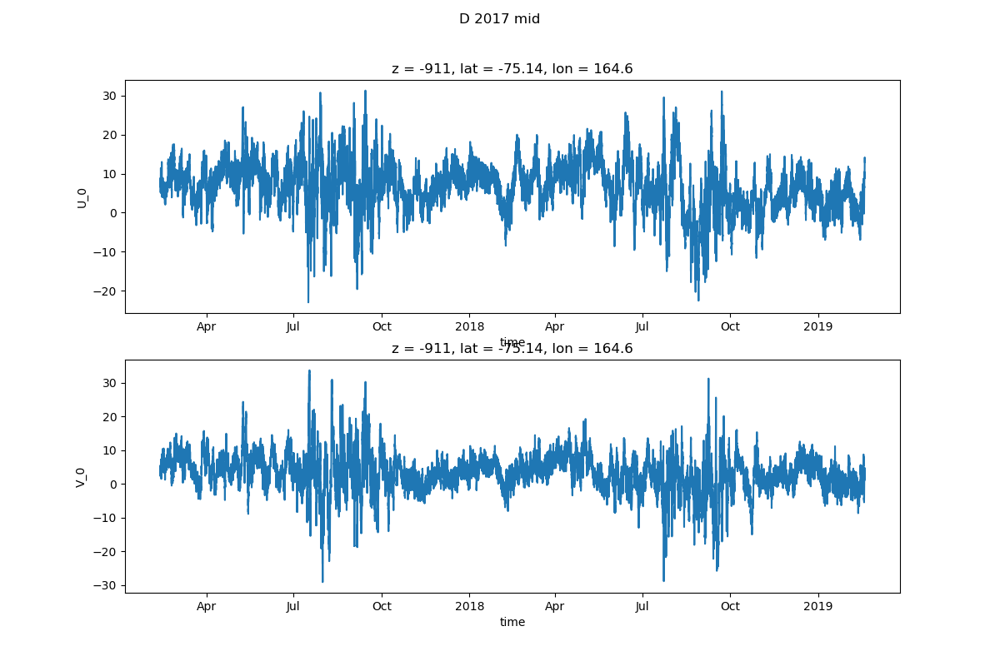

In [321]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2017_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2017_vel_mid.V_0.plot()

plt.suptitle('D 2017 mid')

Text(0.5, 0.98, 'D 2017 bot')

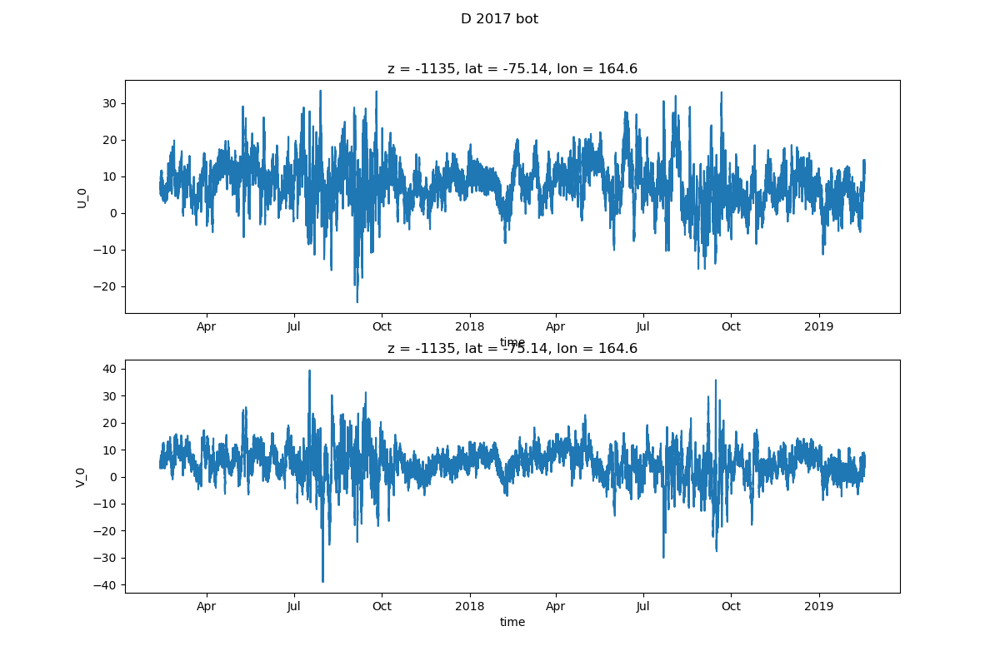

In [322]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2017_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2017_vel_bot.V_0.plot()

plt.suptitle('D 2017 bot')

#### 2019

Text(0.5, 0.98, 'D 2019 Top')

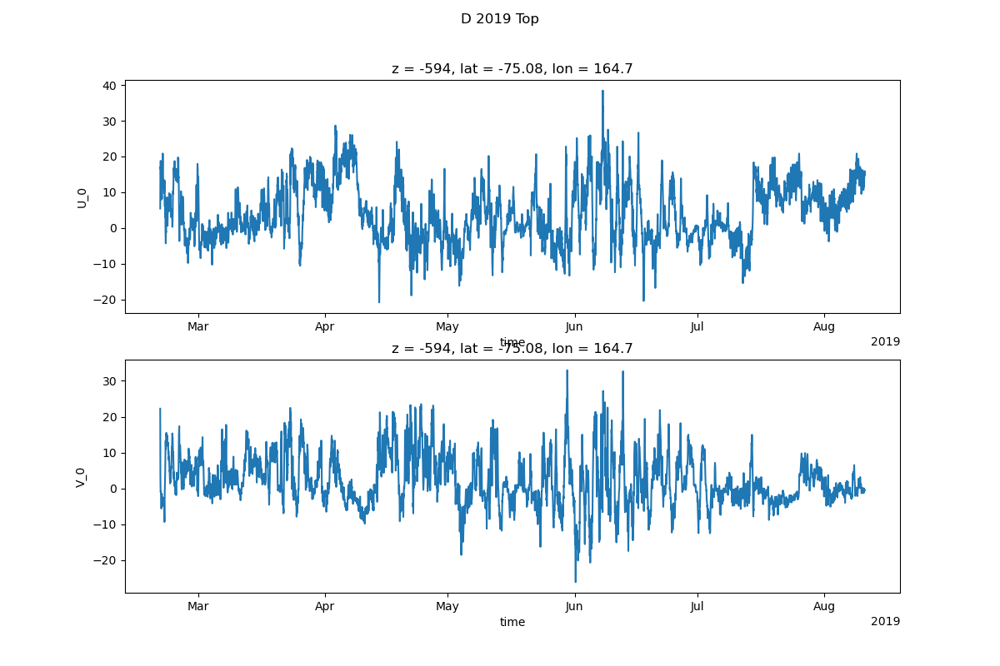

In [323]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2019_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2019_vel_top.V_0.plot()

plt.suptitle('D 2019 Top')

Text(0.5, 0.98, 'D 2019 mid')

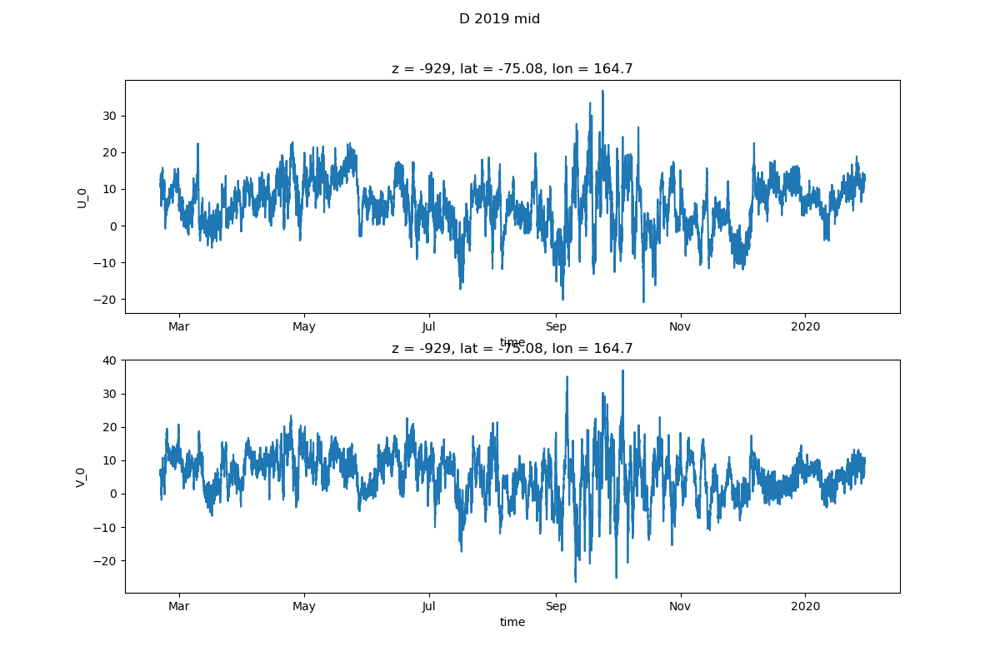

In [324]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2019_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2019_vel_mid.V_0.plot()

plt.suptitle('D 2019 mid')

Text(0.5, 0.98, 'D 2019 bot')

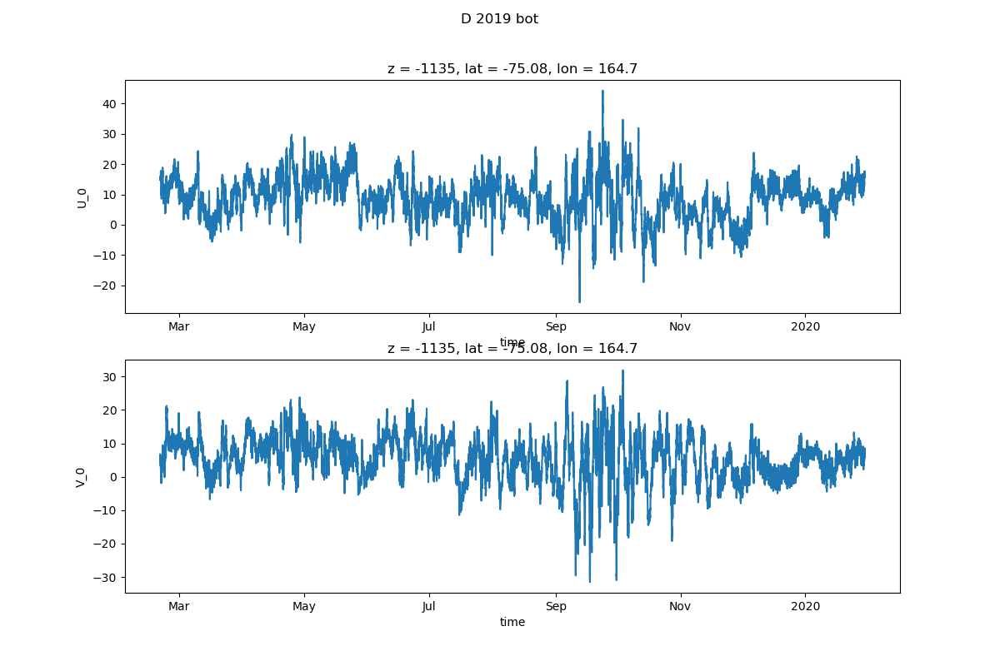

In [325]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2019_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2019_vel_bot.V_0.plot()

plt.suptitle('D 2019 bot')

#### 2021 

Text(0.5, 0.98, 'D 2021 Top')

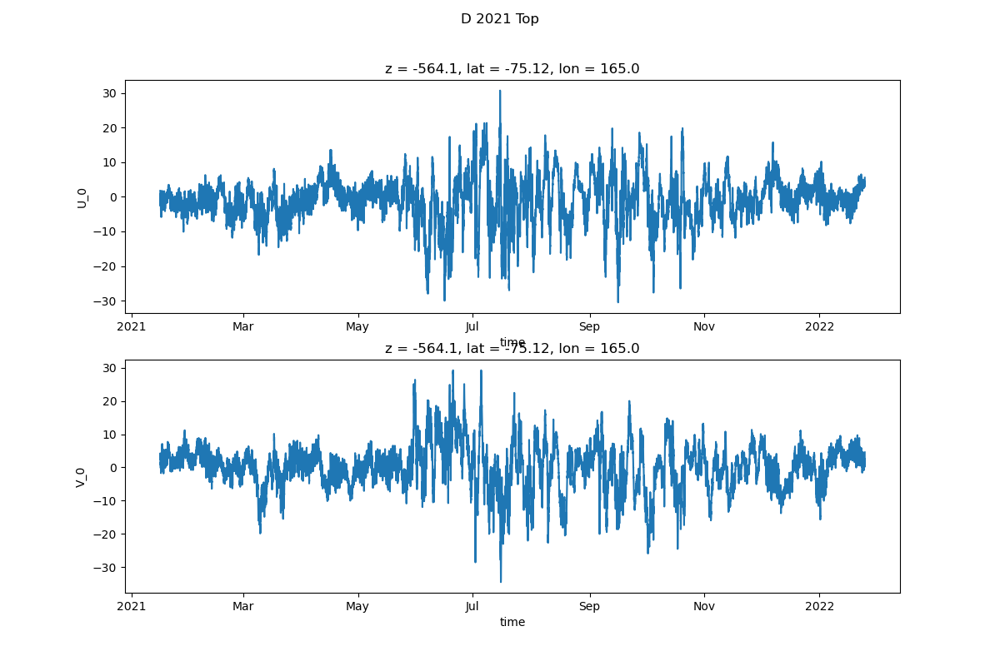

In [326]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2021_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2021_vel_top.V_0.plot()

plt.suptitle('D 2021 Top')

Text(0.5, 0.98, 'D 2021 mid')

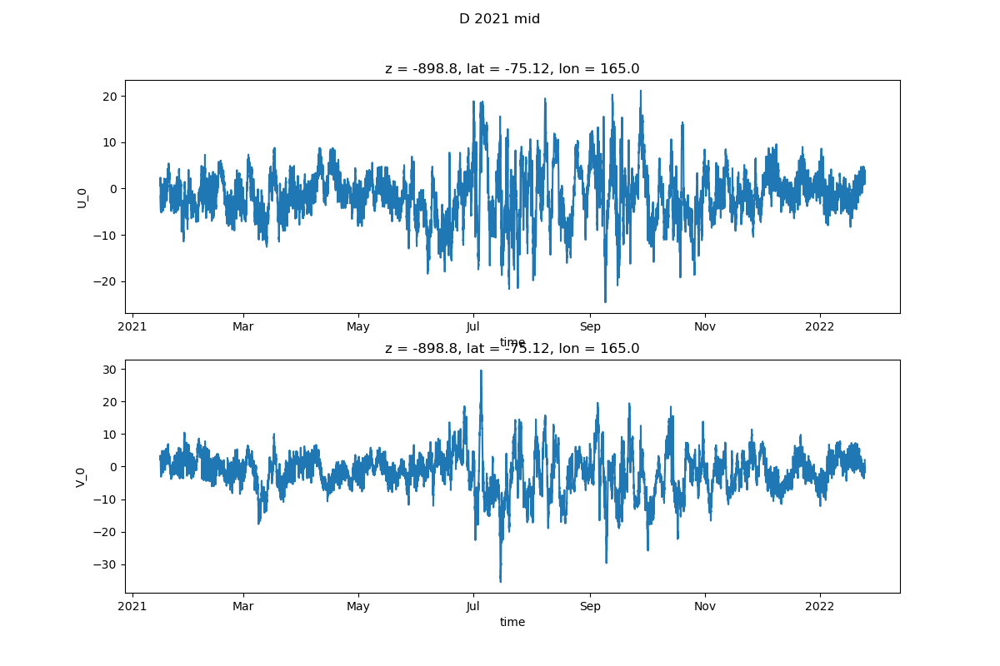

In [327]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2021_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2021_vel_mid.V_0.plot()

plt.suptitle('D 2021 mid')

Text(0.5, 0.98, 'D 2021 bot')

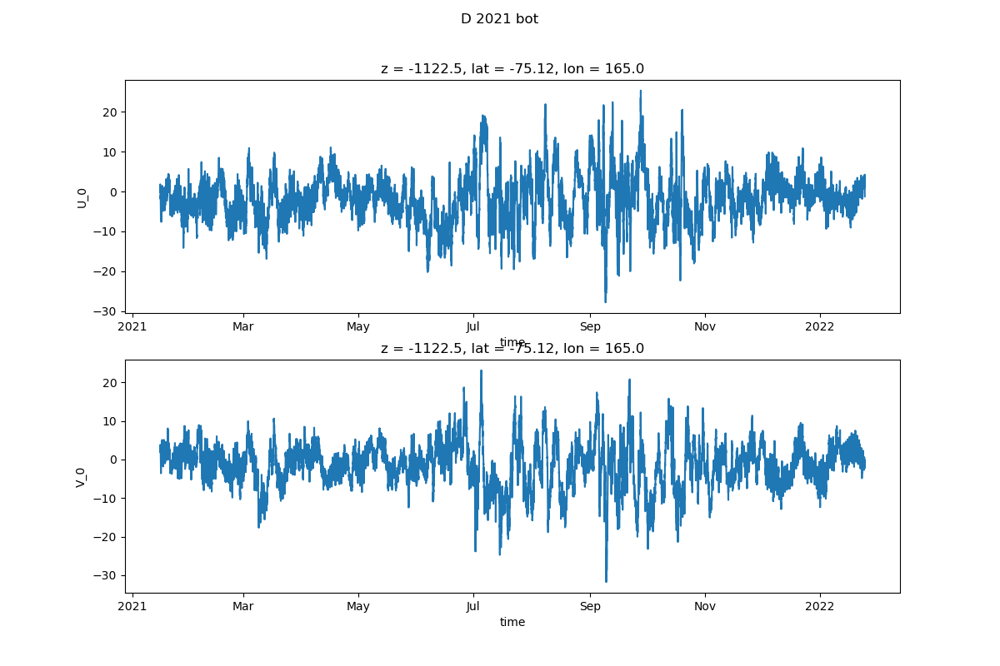

In [328]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2021_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2021_vel_bot.V_0.plot()

plt.suptitle('D 2021 bot')

#### 2022

Text(0.5, 0.98, 'D 2022 Top')

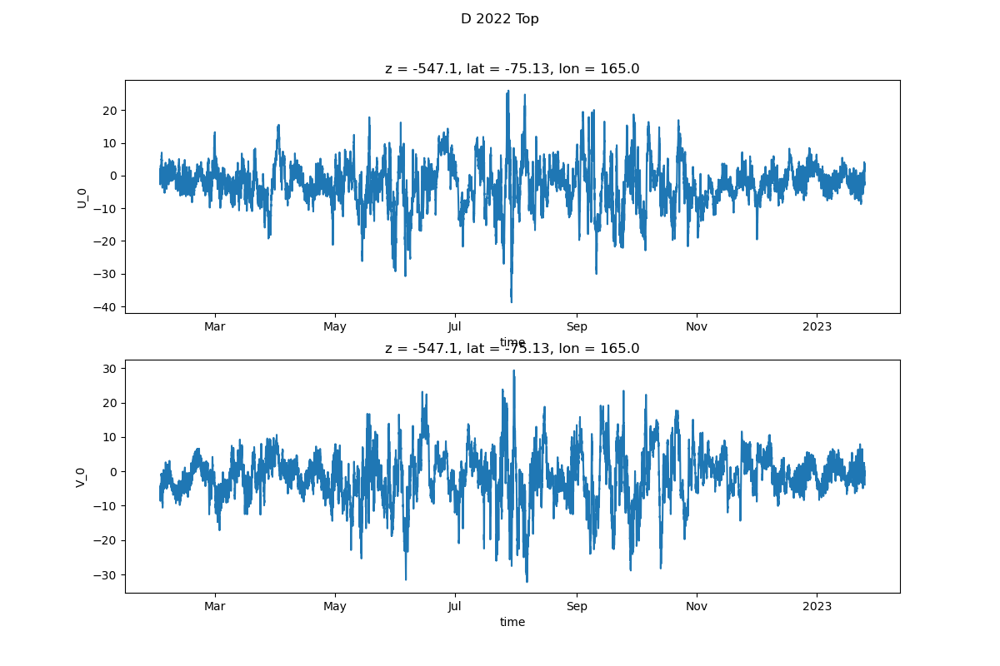

In [329]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2022_vel_top.U_0.plot()

plt.subplot(2,1,2)
D_2022_vel_top.V_0.plot()

plt.suptitle('D 2022 Top')

Text(0.5, 0.98, 'D 2022 mid')

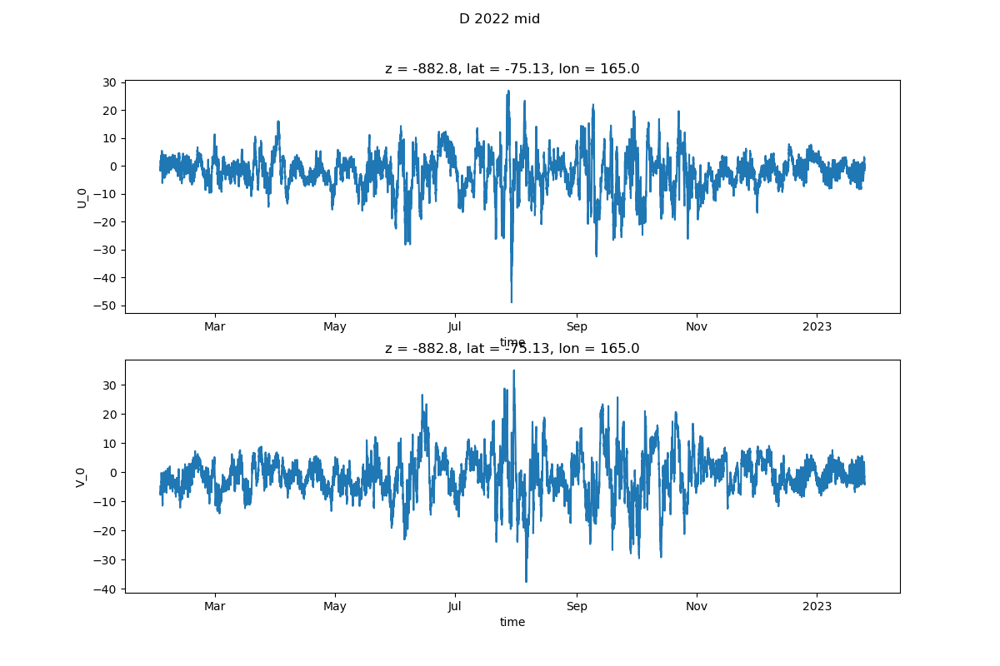

In [330]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2022_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2022_vel_mid.V_0.plot()

plt.suptitle('D 2022 mid')

No bottom velocity in 2022

#### 2023 

Text(0.5, 0.98, 'D 2023 Mid')

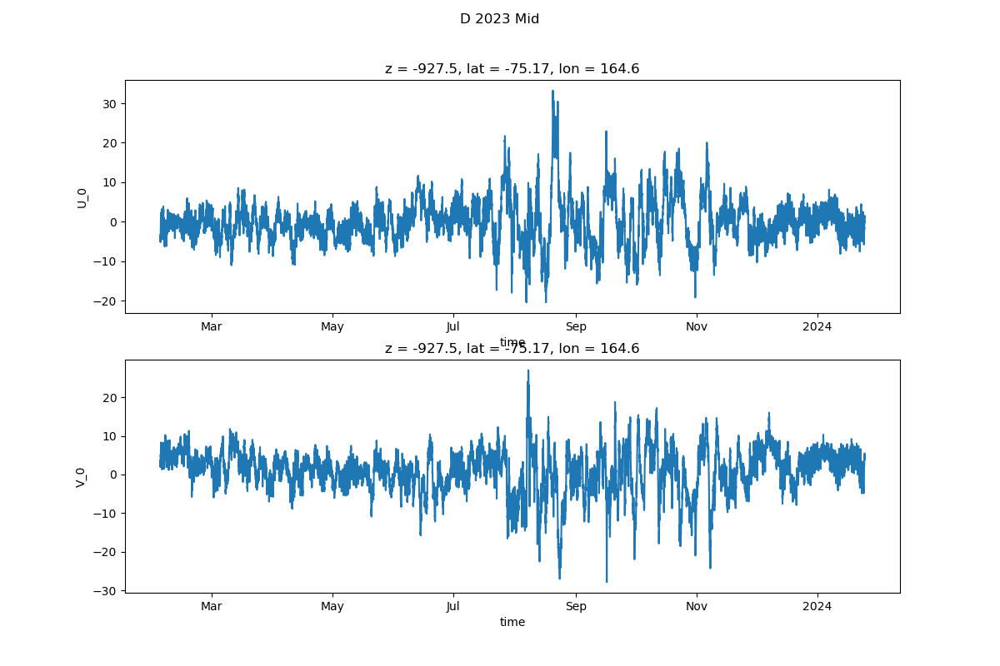

In [333]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2023_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2023_vel_mid.V_0.plot()

plt.suptitle('D 2023 Mid')

Text(0.5, 0.98, 'D 2023 bot')

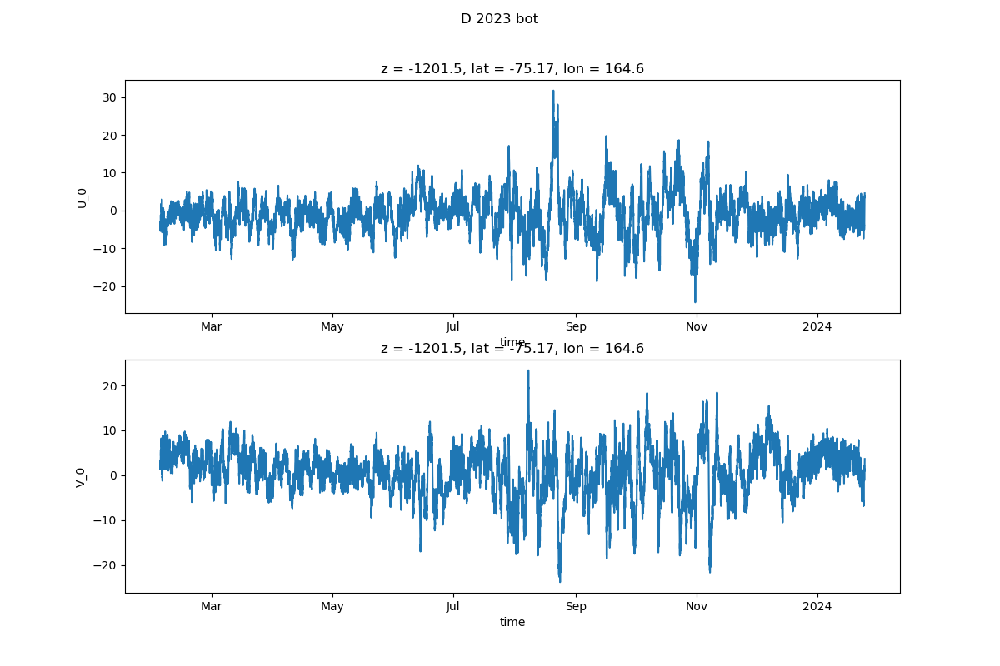

In [334]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2023_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2023_vel_bot.V_0.plot()

plt.suptitle('D 2023 bot')

#### 2024 

Text(0.5, 0.98, 'D 2024 Mid')

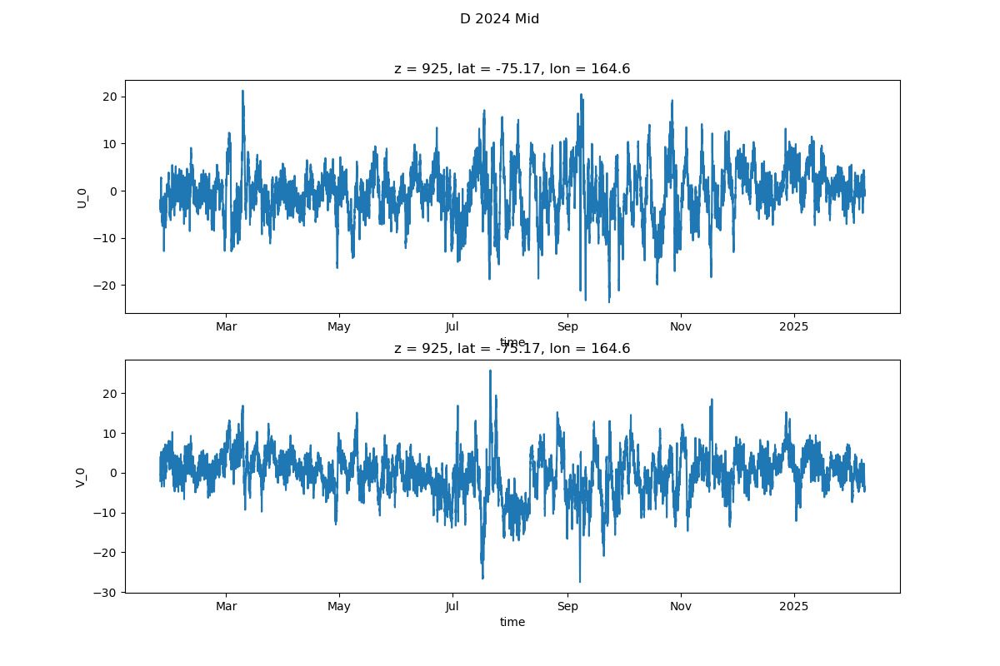

In [335]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2024_vel_mid.U_0.plot()

plt.subplot(2,1,2)
D_2024_vel_mid.V_0.plot()

plt.suptitle('D 2024 Mid')

Text(0.5, 0.98, 'D 2024 bot')

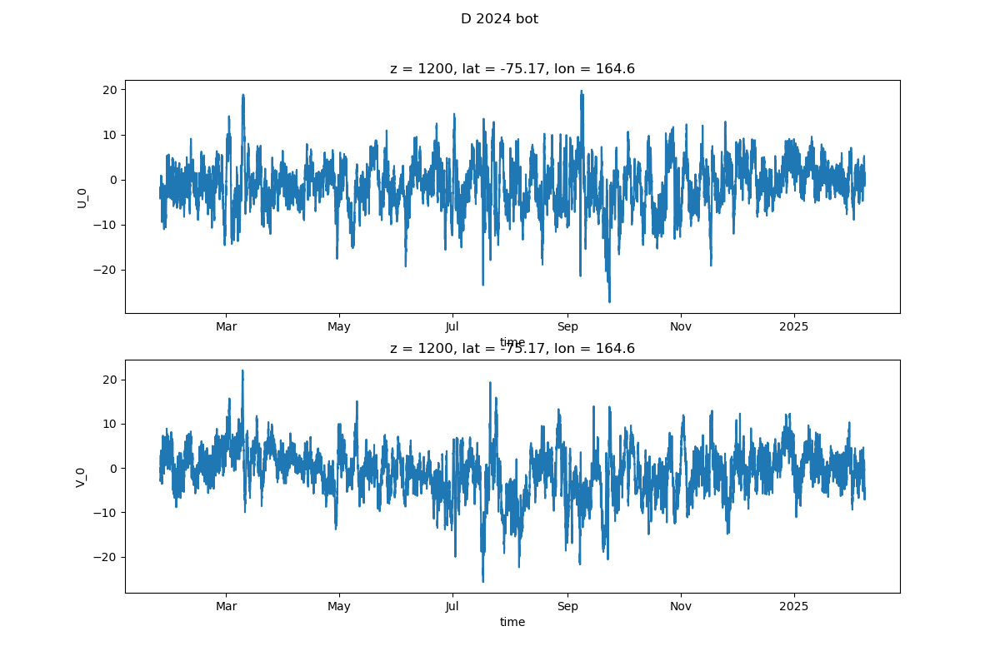

In [336]:
# what the fuck is this? 
fig = plt.figure(figsize=(12,8))

plt.subplot(2,1,1)
D_2024_vel_bot.U_0.plot()

plt.subplot(2,1,2)
D_2024_vel_bot.V_0.plot()

plt.suptitle('D 2024 bot')

In [337]:
D_vel_datasets = [
    D_2014_vel_top,
    D_2014_vel_mid,
    D_2014_vel_bot,
    D_2016_vel_bot,
    D_2017_vel_top,
    D_2017_vel_mid,
    D_2017_vel_bot,
    D_2019_vel_top,
    D_2019_vel_mid,
    D_2019_vel_bot,
    D_2021_vel_top,
    D_2021_vel_mid,
    D_2021_vel_bot,
    D_2022_vel_top,
    D_2022_vel_mid,
    D_2023_vel_mid,
    D_2023_vel_bot,
    D_2024_vel_mid,
    D_2024_vel_bot
]

D_vel_datasets_names = [
    'D_2014_vel_top',
    'D_2014_vel_mid',
    'D_2014_vel_bot',
    'D_2016_vel_bot',
    'D_2017_vel_top',
    'D_2017_vel_mid',
    'D_2017_vel_bot',
    'D_2019_vel_top',
    'D_2019_vel_mid',
    'D_2019_vel_bot',
    'D_2021_vel_top',
    'D_2021_vel_mid',
    'D_2021_vel_bot',
    'D_2022_vel_top',
    'D_2022_vel_mid',
    'D_2023_vel_mid',
    'D_2023_vel_bot',
    'D_2024_vel_mid',
    'D_2024_vel_bot'
]

In [338]:
import numpy as np
import xarray as xr

def make_depth_positive(ds, depth_name="z"):
    """
    Ensure depth coordinate is numeric and positive.

    - Converts string depth to float
    - Handles invalid values safely
    - Preserves attributes
    - Sets CF-compliant metadata

    Parameters
    ----------
    ds : xr.Dataset
    depth_name : str

    Returns
    -------
    xr.Dataset
    """

    if depth_name not in ds.coords:
        return ds

    z = ds[depth_name]

    # Convert to numeric (strings → float, invalid → NaN)
    z_numeric = xr.apply_ufunc(
        lambda x: np.asarray(x, dtype="float64"),
        z,
        dask="allowed",
        vectorize=True,
    )

    # Make positive
    z_pos = np.abs(z_numeric)

    # Preserve attributes
    z_pos.attrs = z.attrs.copy()
    z_pos.attrs.update({
        "standard_name": "depth",
        "long_name": "Depth (positive downward)",
        "positive": "down",
        "units": "m"
    })

    return ds.assign_coords({depth_name: z_pos})


In [339]:
D_vel_datasets = [make_depth_positive(ds) for ds in D_vel_datasets]

In [ ]:
# reanme vars 

In [341]:
# Create function for renaming dimensions 

def rename_vars_if_exist(ds, rename_map):
    """
    Rename variables in an xarray Dataset only if they exist.

    Parameters
    ----------
    ds : xr.Dataset
        Input dataset
    rename_map : dict
        Mapping {old_name: new_name}

    Returns
    -------
    xr.Dataset
        Dataset with variables renamed where applicable
    """
    existing = {old: new for old, new in rename_map.items() if old in ds.data_vars}
    return ds.rename(existing)


In [342]:
D_2019_vel_bot

<xarray.Dataset> Size: 1MB
Dimensions:  (time: 16527)
Coordinates:
  * time     (time) datetime64[ns] 132kB 2019-02-19T18:00:00 ... 2020-01-30T0...
    z        <U5 20B '-1135'
    lat      float64 8B -75.08
    lon      float64 8B 164.7
Data variables:
    U_0      (time) float64 132kB ...
    V_0      (time) float64 132kB ...
    Mod_0    (time) float64 132kB ...
    Dir_0    (time) float64 132kB ...
    TiltX    (time) float64 132kB ...
    TiltY    (time) float64 132kB ...
    Heading  (time) float64 132kB ...
    AbsTilt  (time) float64 132kB ...
    MaxTilt  (time) float64 132kB ...
Attributes: (12/14)
    cruise_deployment:               PNRA - XXXIV Expedition - 2018/19   
    cruise_recovery:                 PNRA - XXXV Expedition - 2019/20
    water_depth_meters:              -1164
    instr_depth_meters:              -1135
    instr_type:                      Aanderaa Seaguard
    instr_sn:                        444
    ...                              ...
    samp_int_minutes:                30
    start_time:                      19/02/2019 18:00:00
    stop_time:                       30/01/2020 01:00:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

In [343]:
rename_map = {
    "U_0": "u",
    "V_0": "v",

    
}

In [340]:
# add in attributes 
# define matadata for coorindates and variables - this will be the same for top and bottom sensor 
META_DATA = {
    "pres": {
        "long_name": "Pressure",
        "units": "dbar",
    },
    "abs_sal": {
        "long_name": "Absolute Salinity",
        "units": "g/kg",
    },
    "cons_temp": {
        "long_name": "Conservative Temperature",
        "units": "degree_Celsius",
    },
    "cons_temp_freezing": {
        "long_name": "Conservative Temperature Freezing",
        "units": "degree_Celsius",
    },
    "sigma0": {
        "long_name": "Potential Density Anomaly",
        "units": "kg/m3",
    },
    "theta": {
        "long_name": "Potential Temperature",
        "units": "degree_Celsius",
    },
    "sal": {
        "long_name": "Practical salinity",
        "units": "PSU",
    },
    "temp_freezing": {
        "long_name": "Temperature Freezing [ITS-90 deg C]",
        "units": "degree_Celsius",
    },
    "temp": {
        "long_name": "Temperature [ITS-90 deg C]",
        "units": "degree_Celsius",
    },
    "con": {
        "long_name": "Conductivity",
        "units": "S/m",
    },
    "z": {
        "long_name": "Depth",
        "units": "m",
        "description": "Depth is positive downward"
    },
    "lat": {
        "long_name": "Latitude",
        "units": "degrees_north",
    },
    "lon": {
        "long_name": "Longitude",
        "units": "degrees_east",
    },
    "u":{
        "long_name": "Eastward Velocity",
        "units": "cm/s",
    },
    "v":{
        "long_name": "Northward Velocity",
        "units": "cm/s",
    },
    "w": {
        "long_name": "Vertical Velocity",
        "units": "m/s",
    },
    "speed": {
        "long_name": "speed",
        "units": "cm/s",
    },
    "dir": {
        "long_name": "direction",
        "units": "degrees",
    },
    "mag_declination": {
        "long_name": "Magnetic Declination",
        "units": "degrees East",
        "description": "Angle between magnetic North and true North"
    },
    
    
}

In [344]:
for i in range(len(D_vel_datasets)):
    D_vel_datasets[i] = rename_vars_if_exist(D_vel_datasets[i], rename_map)

In [345]:
for v, attrs in META_DATA.items():
    for i in range(len(D_vel_datasets)):
        if v in D_vel_datasets[i]:
            D_vel_datasets[i][v].attrs.update(attrs)

In [347]:
D_vel_datasets[9]

<xarray.Dataset> Size: 1MB
Dimensions:  (time: 16527)
Coordinates:
  * time     (time) datetime64[ns] 132kB 2019-02-19T18:00:00 ... 2020-01-30T0...
    z        float64 8B 1.135e+03
    lat      float64 8B -75.08
    lon      float64 8B 164.7
Data variables:
    u        (time) float64 132kB ...
    v        (time) float64 132kB ...
    Mod_0    (time) float64 132kB ...
    Dir_0    (time) float64 132kB ...
    TiltX    (time) float64 132kB ...
    TiltY    (time) float64 132kB ...
    Heading  (time) float64 132kB ...
    AbsTilt  (time) float64 132kB ...
    MaxTilt  (time) float64 132kB ...
Attributes: (12/14)
    cruise_deployment:               PNRA - XXXIV Expedition - 2018/19   
    cruise_recovery:                 PNRA - XXXV Expedition - 2019/20
    water_depth_meters:              -1164
    instr_depth_meters:              -1135
    instr_type:                      Aanderaa Seaguard
    instr_sn:                        444
    ...                              ...
    samp_int_minutes:                30
    start_time:                      19/02/2019 18:00:00
    stop_time:                       30/01/2020 01:00:00
    level_0:                         Raw data
    level_1:                         Despiking
    level_2:                         CTD quality check

In [ ]:
# save final datasets 
# for i in range(len(D_vel_datasets)):
#     D_vel_datasets[i].to_netcdf(path='//thepenguin/penguin2/Data/TNB/mooring/Mooring_D_MORSea/Mooring_D_2014_2025/working/'+D_vel_datasets_names[i]+'.nc')

In [ ]:
# rename vars 

### Create Merged Timeseries For Easy Analysis 

#### Salinity Top

In [117]:
# salinity top 
df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
1,D,2014,ctd,top,-509,"[S_0, T_0, S_2, S_1, T_2]",2014-01-22 00:00:00,2016-01-31 10:00:00,0 days 00:30:00,35493.0
8,D,2016,ctd,top,-523,"[Theta_0, S_0, Conductivity]",2016-02-06 22:05:00,2016-09-14 21:45:00,0 days 00:05:00,63645.0
16,D,2017,ctd,top,-556,"[T_0, S_0, Conductivity, S_2, T_2]",2017-02-11 07:00:00,2019-02-18 23:00:00,0 days 00:30:00,35409.0
23,D,2019,ctd,top,-574,"[T_0, S_0, Theta_0, Turbidity, S_2, T_2]",2019-02-19 17:45:00,2020-01-30 01:45:00,0 days 00:30:00,16529.0
29,D,2020,ctd,top,-612.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 14:22:00,2021-01-07 22:22:00,0 days 00:30:00,16385.0
35,D,2021,ctd,top,-543.6,"[T_0, S_0, Turbidity, S_2, T_2]",2021-01-15 22:06:00,2022-01-24 21:36:00,0 days 00:30:00,17952.0
41,D,2022,ctd,top,-526.1,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2022-02-01 04:40:00,2023-01-25 07:10:00,0 days 00:30:00,17190.0


In [118]:
# not including 2016 for now because no S_2 level 
years = ['2014','2017','2019','2020','2021','2022']
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['top']['sal'])

In [119]:
D_top_sal = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\2950794522.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_top_sal = xr.concat(ds_list,dim='time')


Text(0.5, 1.0, 'Mooring D Salinity Top Sensor')

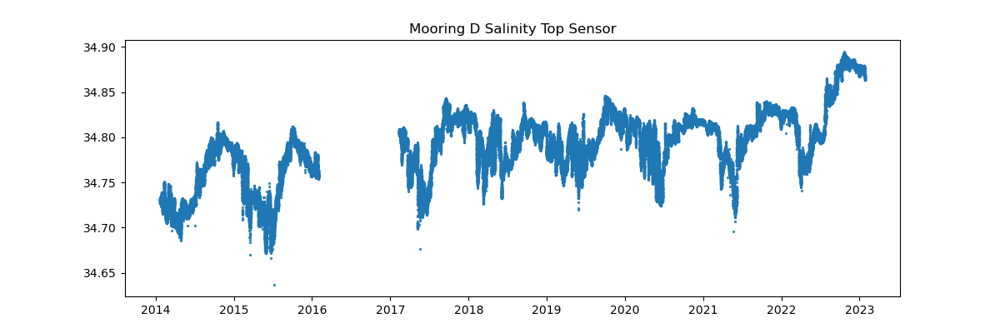

In [120]:
fig = plt.figure(figsize=(12,4))
plt.scatter(D_top_sal.time,D_top_sal,s=2,alpha=0.8)
plt.title('Mooring D Salinity Top Sensor')

#### Salinity Mid1 

In [121]:
# salinity mid1 
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
15,D,2017,ctd,mid1,-772,"[T_0, S_0, Conductivity, Theta_0, Density, S_2...",2017-02-11 07:25:00,2019-02-18 23:25:00,0 days 00:30:00,35409.0
22,D,2019,ctd,mid1,-790,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 18:00:00,2020-01-30 03:00:00,0 days 00:30:00,16531.0
34,D,2021,ctd,mid1,-759.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 22:40:00,2022-01-24 22:10:00,0 days 00:30:00,17952.0
40,D,2022,ctd,mid1,-745.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2022-02-01 04:50:00,2023-01-25 07:20:00,0 days 00:30:00,17190.0
46,D,2023,ctd,mid1,-926.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, Densi...",2023-02-03 05:41:00,2024-01-24 19:11:00,0 days 00:30:00,17068.0
51,D,2024,ctd,mid1,-898,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 09:39:27,2025-02-08 05:09:27,0 days 00:30:00,18232.0


In [122]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()

In [123]:
years

array(['2017', '2019', '2021', '2022', '2023', '2024'], dtype=object)

In [124]:
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['mid1']['sal'])

In [125]:
D_mid1_sal = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\928112815.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_mid1_sal = xr.concat(ds_list,dim='time')


In [126]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
28,D,2020,ctd,mid2,-922,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 13:29:00,2021-01-07 21:29:00,0 days 00:30:00,16385.0


In [127]:
D_mid2_sal = dt['D']['2020']['ctd']['mid2']['sal']

In [128]:
D_mid1_sal = xr.concat([D_mid1_sal,D_mid2_sal],dim='time').sortby('time')

#### Salinity Bottom

In [129]:
# salinity bot
df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
0,D,2014,ctd,bot,-1069,"[T_0, S_0, S_1, S_2, T_2]",2014-01-22 13:30:00,2016-02-01 17:00:00,0 days 00:30:00,35528.0
7,D,2016,ctd,bot,-1060,"[Theta_0, S_0, Conductivity]",2016-02-06 22:02:00,2016-05-28 07:47:00,0 days 00:05:00,32086.0
14,D,2017,ctd,bot,-1086,"[T_0, S_0, Conductivity, Theta_0, Oxygen, Dept...",2017-02-11 07:35:00,2017-09-17 03:05:00,0 days 00:30:00,10456.0
21,D,2019,ctd,bot,-1130,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 16:00:00,2020-01-30 01:00:00,0 days 00:30:00,16531.0
33,D,2021,ctd,bot,-1073.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 21:59:00,2022-01-24 21:29:00,0 days 00:30:00,17952.0
45,D,2023,ctd,bot,-1200.5,"[T_0, S_0, S_2, T_2]",2023-02-03 08:45:00,2024-01-24 22:45:00,0 days 00:30:00,17069.0
50,D,2024,ctd,bot,-1176,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 10:07:56,2025-02-08 05:07:56,0 days 00:30:00,18231.0


In [130]:
years = ['2014','2019','2021','2023','2024']

In [131]:
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['bot']['sal'])

In [132]:
D_bot_sal = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\56393258.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_bot_sal = xr.concat(ds_list,dim='time')


Text(0.5, 0, 'Time')

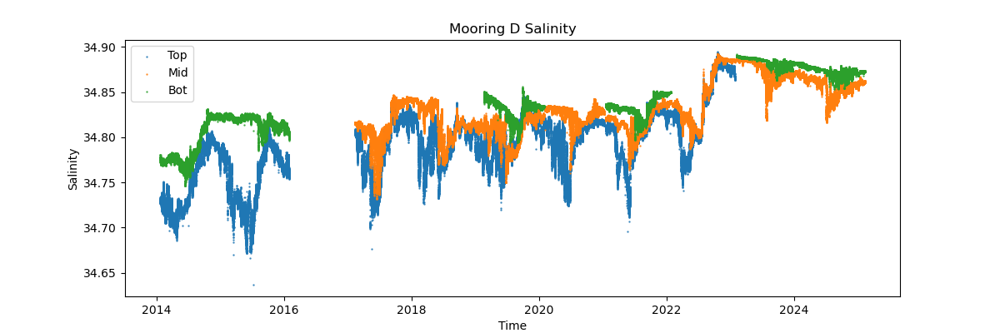

In [134]:
fig = plt.figure(figsize=(12,4))
plt.scatter(D_top_sal.time,D_top_sal,s=0.5,alpha=0.8,label='Top')
plt.scatter(D_mid1_sal.time,D_mid1_sal,s=0.5,alpha=0.8,label='Mid')
plt.scatter(D_bot_sal.time,D_bot_sal,s=0.5,alpha=0.8,label='Bot')
plt.title('Mooring D Salinity')
plt.legend()
plt.ylabel('Salinity')
plt.xlabel('Time')

#### Temp Top 

In [31]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'top'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
10,D,1998,ctd,top,-566,"[S_0, T_0, S_1]",1997-12-10 15:00:00,1999-01-14 12:30:00,0 days 00:30:00,19196.0
15,D,1999,ctd,top,-546,"[S_0, T_0, S_1]",1999-01-17 22:30:00,2000-01-16 14:30:00,0 days 00:30:00,17457.0
22,D,2000,ctd,top,-526,"[S_0, T_0, S_1, S_2]",2000-01-18 15:00:00,2001-01-16 20:30:00,0 days 00:30:00,17484.0
54,D,2010,ctd,top,-463,"[S_0, T_0, T_1, S_1, S_2]",2010-02-06 02:55:00,2012-01-23 14:25:00,0 days 00:30:00,34392.0
61,D,2012,ctd,top,-509,"[T_0, S_0, S_1, S_2]",2012-02-01 22:30:00,2014-01-11 15:00:00,0 days 00:30:00,34066.0
66,D,2014,ctd,top,-509,"[S_0, T_0, S_2, S_1, T_2]",2014-01-22 00:00:00,2016-01-31 10:00:00,0 days 00:30:00,35493.0
73,D,2016,ctd,top,-523,"[Theta_0, S_0, Conductivity]",2016-02-06 22:05:00,2016-09-14 21:45:00,0 days 00:05:00,63645.0
81,D,2017,ctd,top,-556,"[T_0, S_0, Conductivity, S_2, T_2]",2017-02-11 07:00:00,2019-02-18 23:00:00,0 days 00:30:00,35409.0
88,D,2019,ctd,top,-574,"[T_0, S_0, Theta_0, Turbidity, S_2, T_2]",2019-02-19 17:45:00,2020-01-30 01:45:00,0 days 00:30:00,16529.0
94,D,2020,ctd,top,-612.8,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 14:22:00,2021-01-07 22:22:00,0 days 00:30:00,16385.0


In [ ]:
# not including 2016 for now because no S_2 level 
years = ['2014','2017','2019','2020','2021','2022']
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['top']['temp'])

In [34]:
# FOR GLACIOLOGY FINAL PROJECT 
years = ['1998','1999','2000','2010','2012','2014','2017','2019','2020','2021','2022']
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['top']['T_0'])

In [35]:
D_top_temp = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_7892\3315157486.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_top_temp = xr.concat(ds_list,dim='time')


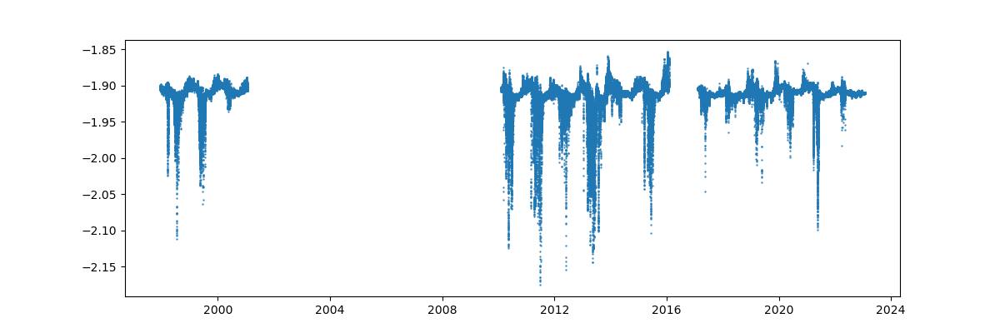

In [44]:
fig = plt.figure(figsize=(12,4))
plt.scatter(D_top_temp.time,D_top_temp,s=0.5,alpha=0.8)
# D_top_temp.plot.scatter(x='time',s=10,c='tab:blue')

In [49]:
    D_top_temp['z'] = (
        D_top_temp['z']
        .astype(str)        # everything becomes a string
        .str.strip()        # remove spaces
        .astype(float)      # convert '-612.8' → -612.8
        .astype(int)        # convert -612.8 → -612
    )

In [50]:
D_top_temp.to_netcdf('D_top_temp_1998_2024_GlaciologyFinal.nc')

#### Temp Mid1

In [87]:
# temp mid1 
df.query("mooring == 'D' & instrument == 'temp' & position == 'mid1'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
67,D,2014,temp,mid1,-739,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
74,D,2016,temp,mid1,-749,"[T_0, T_2]",2016-02-06 22:06:00,2017-01-08 21:16:00,0 days 00:10:00,48524.0
95,D,2020,temp,mid1,-837.5,"[T_0, T_2]",2020-02-01 14:05:27,2021-01-07 21:35:27,0 days 00:30:00,16384.0


In [80]:
years = df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid1'")['year'].unique()

In [81]:
years

array(['1995', '1996', '2000', '2001', '2003', '2004', '2005', '2006',
       '2010', '2012', '2017', '2019', '2021', '2022', '2023', '2024'],
      dtype=object)

In [82]:
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['mid1']['temp'])

KeyError: 'Could not find node at temp'

In [83]:
# FOR GLACIOLOGY PROJECT 
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['mid1']['T_0'])

In [84]:
D_mid1_temp = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_7892\1768165772.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_mid1_temp = xr.concat(ds_list,dim='time')


In [85]:
df.query("mooring == 'D' & instrument == 'temp' & position == 'mid1'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
67,D,2014,temp,mid1,-739,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
74,D,2016,temp,mid1,-749,"[T_0, T_2]",2016-02-06 22:06:00,2017-01-08 21:16:00,0 days 00:10:00,48524.0
95,D,2020,temp,mid1,-837.5,"[T_0, T_2]",2020-02-01 14:05:27,2021-01-07 21:35:27,0 days 00:30:00,16384.0


In [88]:
# FOR GLACIOLOGY PROJECT 
## need to resample thalf an hour too be cooonnsiistent with ooother data
D_mid1_temp_2014 = dt['D']['2014']['temp']['mid1'].to_dataset().resample(time='30min').mean()
D_mid1_temp_2016 = dt['D']['2016']['temp']['mid1'].to_dataset().resample(time='30min').mean()

In [152]:
## need to resample thalf an hour too be cooonnsiistent with ooother data
D_mid1_temp_2014 = dt['D']['2014']['temp']['mid1'].to_dataset().resample(time='30min').mean()
D_mid1_temp_2016 = dt['D']['2016']['temp']['mid1'].to_dataset().resample(time='30min').mean()

In [89]:
D_mid1_temp_2014_2016 = xr.concat([D_mid1_temp_2014,D_mid1_temp_2016],dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_7892\820251525.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_mid1_temp_2014_2016 = xr.concat([D_mid1_temp_2014,D_mid1_temp_2016],dim='time')


In [92]:
D_mid1_temp1 = xr.concat([D_mid1_temp_2014_2016.T_0,dt['D']['2020']['temp']['mid1']['T_0']],dim='time').sortby('time')

In [93]:
D_mid1_temp = xr.concat([D_mid1_temp,D_mid1_temp1],dim='time').sortby('time')

(-2.5, -1.8)

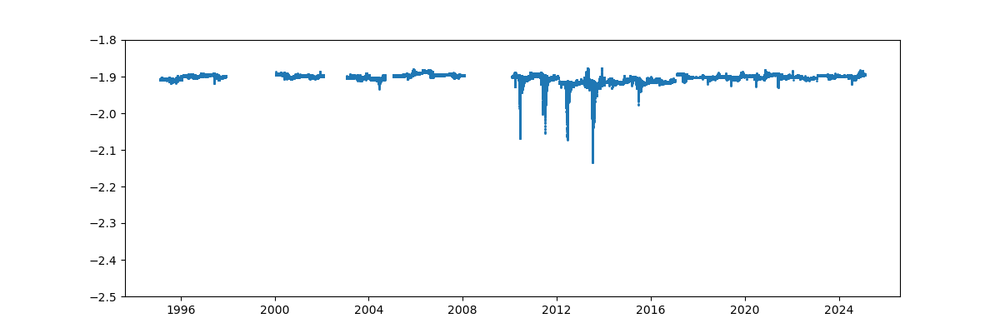

In [107]:
fig = plt.figure(figsize=(12,4))
plt.scatter(D_mid1_temp.time,D_mid1_temp,s=1)
plt.ylim(-2.5,-1.8)

#### Temp Mid2

In [156]:
df.query("mooring == 'D' & instrument == 'temp' & position == 'mid2'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
3,D,2014,temp,mid2,-966,"[T_0, T_2]",2014-01-22 00:00:00,2016-01-31 11:00:00,0 days 00:10:00,106483.0
10,D,2016,temp,mid2,-888,"[T_0, T_2]",2016-02-06 22:10:00,2017-01-08 21:10:00,0 days 00:10:00,48523.0
17,D,2017,temp,mid2,-996,"[T_0, T_2]",2017-02-11 07:15:20,2019-02-18 23:15:20,0 days 00:30:00,35409.0
24,D,2019,temp,mid2,-1014,"[T_0, T_2]",2019-02-19 19:00:00,2020-01-30 02:30:00,0 days 00:30:00,16528.0
36,D,2021,temp,mid2,-984.5,"[T_0, T_2]",2021-01-15 22:24:00,2022-01-24 21:54:00,0 days 00:30:00,17952.0
42,D,2022,temp,mid2,-971.5,"[T_0, T_2]",2022-02-01 04:40:00,2023-01-25 07:10:00,0 days 00:30:00,17190.0
47,D,2023,temp,mid2,-1163.5,"[T_0, T_2]",2023-02-03 05:30:00,2024-01-24 19:30:00,0 days 00:30:00,17069.0
52,D,2024,temp,mid2,1162,"[T_0, T_2]",2024-01-25 09:52:16,2025-02-08 04:52:16,0 days 00:30:00,18231.0


In [157]:
# resample 2014 and 2016 to 30 min 
D_mid2_temp_2014 = dt['D']['2014']['temp']['mid2'].to_dataset().resample(time='30min').mean()
D_mid2_temp_2016 = dt['D']['2016']['temp']['mid2'].to_dataset().resample(time='30min').mean()

In [158]:
D_mid2_temp_2014_2016 = xr.concat([D_mid2_temp_2014,D_mid2_temp_2016],dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\1036569075.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_mid2_temp_2014_2016 = xr.concat([D_mid2_temp_2014,D_mid2_temp_2016],dim='time')


In [159]:
# temp mid2
years = df.query("mooring == 'D' & instrument == 'temp' & position == 'mid2'")['year'].unique()

In [160]:
# exclude 2014 and 2016 
years = years[2:]

In [161]:
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['temp']['mid2']['temp'])

In [162]:
D_mid2_temp_2017_2024 = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\4164696536.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_mid2_temp_2017_2024 = xr.concat(ds_list,dim='time')


In [163]:
D_mid2_temp = xr.concat([D_mid2_temp_2014_2016.temp,D_mid2_temp_2017_2024],dim='time').sortby('time')

In [164]:
df.query("mooring == 'D' & instrument == 'ctd' & position == 'mid2'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
28,D,2020,ctd,mid2,-922,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2020-02-01 13:29:00,2021-01-07 21:29:00,0 days 00:30:00,16385.0


In [165]:
D_mid2_temp = xr.concat([D_mid2_temp,dt['D']['2020']['ctd']['mid2']['temp']],dim='time').sortby('time')

In [166]:
# BOTTOM 
df.query("mooring == 'D' & instrument == 'ctd' & position == 'bot'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
0,D,2014,ctd,bot,-1069,"[T_0, S_0, S_1, S_2, T_2]",2014-01-22 13:30:00,2016-02-01 17:00:00,0 days 00:30:00,35528.0
7,D,2016,ctd,bot,-1060,"[Theta_0, S_0, Conductivity]",2016-02-06 22:02:00,2016-05-28 07:47:00,0 days 00:05:00,32086.0
14,D,2017,ctd,bot,-1086,"[T_0, S_0, Conductivity, Theta_0, Oxygen, Dept...",2017-02-11 07:35:00,2017-09-17 03:05:00,0 days 00:30:00,10456.0
21,D,2019,ctd,bot,-1130,"[T_0, S_0, Theta_0, Depth, Pressure, S_2, T_2]",2019-02-19 16:00:00,2020-01-30 01:00:00,0 days 00:30:00,16531.0
33,D,2021,ctd,bot,-1073.5,"[T_0, S_0, Depth_0, Pressure_0, Theta_0, S_2, ...",2021-01-15 21:59:00,2022-01-24 21:29:00,0 days 00:30:00,17952.0
45,D,2023,ctd,bot,-1200.5,"[T_0, S_0, S_2, T_2]",2023-02-03 08:45:00,2024-01-24 22:45:00,0 days 00:30:00,17069.0
50,D,2024,ctd,bot,-1176,"[T_0, S_0, Depth, Pressure, Conductivity, S_2,...",2024-01-25 10:07:56,2025-02-08 05:07:56,0 days 00:30:00,18231.0


In [167]:
years = ['2014','2019','2021','2023','2024']
ds_list = []
for i in range(len(years)):
    ds_list.append(dt['D'][years[i]]['ctd']['bot']['temp'])

In [168]:
D_bot_temp = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\777249209.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  D_bot_temp = xr.concat(ds_list,dim='time')


Text(0.5, 0, 'Time')

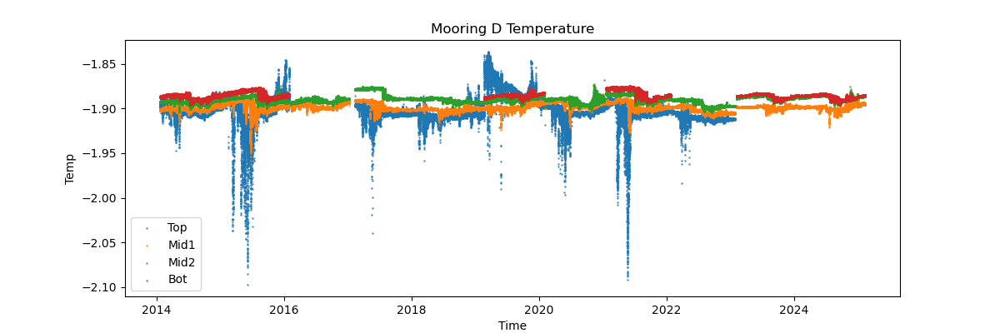

In [170]:
fig = plt.figure(figsize=(12,4))
plt.scatter(D_top_temp.time,D_top_temp,s=0.5,alpha=0.8,label='Top')
plt.scatter(D_mid1_temp.time,D_mid1_temp,s=0.5,alpha=0.8,label='Mid1')
plt.scatter(D_mid2_temp.time,D_mid2_temp,s=0.5,alpha=0.8,label='Mid2')
plt.scatter(D_bot_temp.time,D_bot_temp,s=0.5,alpha=0.8,label='Bot')
plt.title('Mooring D Temperature')
plt.legend()
plt.ylabel('Temp')
plt.xlabel('Time')

In [171]:
D_top_sal

<xarray.DataArray 'sal' (time: 138958)> Size: 1MB
array([34.73380023, 34.73060047, 34.7320007 , ..., 34.86320017,
       34.86440009, 34.8651    ], shape=(138958,))
Coordinates:
  * time     (time) datetime64[ns] 1MB 2014-01-22 ... 2023-01-25T07:10:00
    z        (time) object 1MB -509 -509 -509 ... '-526.1' '-526.1' '-526.1'
    lat      (time) float64 1MB -75.14 -75.14 -75.14 ... -75.13 -75.13 -75.13
    lon      (time) float64 1MB 164.6 164.6 164.6 164.6 ... 165.0 165.0 165.0

In [ ]:
# depthh innn somme  iinstances is string - issues when saving needd to fix here first 
datasets = [D_top_temp, D_mid1_temp, D_mid2_temp, D_bot_temp, D_top_sal, D_mid1_sal, D_bot_sal]
dataset_names = ['D_top_temp', 'D_mid1_temp', 'D_mid2_temp', 'D_bot_temp', 'D_top_sal', 'D_mid1_sal', 'D_bot_sal']
for i,j in zip(range(len(datasets)),range(len(dataset_names))):
    ds = datasets[i]
    ds['z'] = (
        ds['z']
        .astype(str)        # everything becomes a string
        .str.strip()        # remove spaces
        .astype(float)      # convert '-612.8' → -612.8
        .astype(int)        # convert -612.8 → -612
    )
    ds.to_netcdf(f"{dataset_names[j]}.nc")


C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\1000743237.py:12: UserWarning: Times can't be serialized faithfully to int64 with requested units 'minutes since 2017-02-11T07:25:00'. Serializing with units 'seconds since 2017-02-11T07:25:00' instead. Set encoding['dtype'] to floating point dtype to serialize with units 'minutes since 2017-02-11T07:25:00'. Set encoding['units'] to 'seconds since 2017-02-11T07:25:00' to silence this warning .
  ds.to_netcdf(f"{dataset_names[j]}.nc")
C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\1000743237.py:12: UserWarning: Times can't be serialized faithfully to int64 with requested units 'minutes since 2014-01-22T13:30:00'. Serializing with units 'seconds since 2014-01-22T13:30:00' instead. Set encoding['dtype'] to floating point dtype to serialize with units 'minutes since 2014-01-22T13:30:00'. Set encoding['units'] to 'seconds since 2014-01-22T13:30:00' to silence this warning .
  ds.to_netcdf(f"{dataset_names[j]}.nc")
C:\Users\mblan\AppData\L

### T/S Diagrams 

In [217]:
gsw.SA_from_SP?

Signature: gsw.SA_from_SP(SP, p, lon, lat)
Docstring:
Calculates Absolute Salinity from Practical Salinity.  Since SP is
non-negative by definition, this function changes any negative input
values of SP to be zero.

Parameters
----------
SP : array-like
    Practical Salinity (PSS-78), unitless
p : array-like
    Sea pressure (absolute pressure minus 10.1325 dbar), dbar
lon : array-like
    Longitude, -360 to 360 degrees
lat : array-like
    Latitude, -90 to 90 degrees

Returns
-------
SA : array-like, g/kg
    Absolute Salinity


References
----------
IOC, SCOR and IAPSO, 2010: The international thermodynamic equation of
seawater - 2010: Calculation and use of thermodynamic properties.
Intergovernmental Oceanographic Commission, Manuals and Guides No. 56,
UNESCO (English), 196 pp.  Available from https://www.teos-10.org/
See section 2.5 and appendices A.4 and A.5 of this TEOS-10 Manual.

McDougall, T.J., D.R. Jackett, F.J. Millero, R. Pawlowicz and
P.M. Barker, 2012: A global algorith

In [ ]:
# gsw.sigma0 requires conservative temperature and absolute salinity 
# gsw.CT_from_t requires absolute salinity, in-situ temperature, and sea pressure 
# gsw.pt_from_t requires absolute salinity, in-situ temperature, sea pressure, and reference pressure 
# gsw.SA_from_SP requires practical salinity, sea pressure, longitude, latitude 
# Does the CTD measure practical salinity? 


In [173]:
datasets = [D_top_temp, D_mid1_temp, D_mid2_temp, D_bot_temp, D_top_sal, D_mid1_sal, D_bot_sal]

<>:47: SyntaxWarning: invalid escape sequence '\c'
<>:47: SyntaxWarning: invalid escape sequence '\c'
C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\3935008626.py:47: SyntaxWarning: invalid escape sequence '\c'
  ax.set_ylabel('Potential Temperature [$^\circ$C]')
C:\Users\mblan\AppData\Local\Temp\ipykernel_40256\3935008626.py:34: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("jet", len(unique_years))


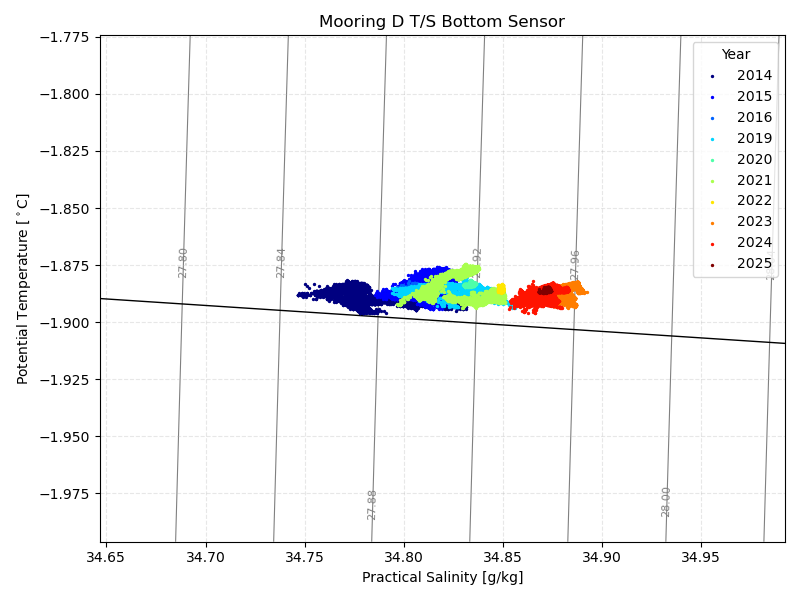

In [208]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import gsw

# Extract variables
temp = D_bot_temp
sal  = D_bot_sal
time = pd.to_datetime(D_bot_sal.time.values)
years = time.year
unique_years = np.unique(years)

# ----- Density Grid -----
mint = temp.min()
maxt = temp.max()
mins = sal.min()
maxs = sal.max()

tempL = np.linspace(mint.values - 0.1, maxt.values + 0.1, 200)
salL  = np.linspace(mins.values - 0.1, maxs.values + 0.1, 200)
Tg, Sg = np.meshgrid(tempL, salL)

sigma_theta = gsw.sigma0(Sg, Tg)

# ----- Make Figure -----
fig, ax = plt.subplots(figsize=(8,6))

# Density contours
cs = ax.contour(Sg, Tg, sigma_theta, colors='grey', zorder=1, linewidths=0.8)
cl = plt.clabel(cs, fontsize=8, inline=False)

# ----- Scatter by Year -----
# cmap = plt.cm.get_cmap("tab20", len(unique_years))
cmap = plt.cm.get_cmap("jet", len(unique_years))

for i, yr in enumerate(unique_years):
    idx = (years == yr)
    ax.scatter(sal[idx], temp[idx], s=2, color=cmap(i),
               label=str(yr), zorder=3)

# ----- Freezing Temperature Line -----
t_freezing = gsw.t_freezing(salL, p=0, saturation_fraction=0)
ax.plot(salL, t_freezing, color='black', linewidth=1, zorder=2)

# ----- Labels + Decorations -----
ax.set_xlabel('Practical Salinity [g/kg]')
ax.set_ylabel('Potential Temperature [$^\circ$C]')
ax.set_title('Mooring D T/S Bottom Sensor')

ax.legend(title="Year")
ax.grid(True, linestyle='--', alpha=0.3)
ax.tick_params(direction='out')

plt.tight_layout()
plt.show()


Need to redo T/S diagrams using using correct temp / salinitiy. Potential density contours are calculated using conservative temperature and absolute salinity. Need to calculate these quantities. 

### Correct for Magnetic Declination

In [37]:
mag_dec_2014 = 134 
mag_dec_2016 = 134 
mag_dec_2017 = 134 
mag_dec_2019 = 134.5 
mag_dec_2020 = 133 
mag_dec_2021 = 133.43 
mag_dec_2022 = 133.31 
mag_dec_2023 = 133.6 
mag_dec_2024 = 133.72 



In [60]:
true_dir = magnetic_declination.calculate_true_direction(D_2014_vel_top.Dir_0, mag_dec_2014)

In [ ]:
magnetic_declination_radians = np.deg2rad(mag_dec_2014)
u_prime, v_prime = magnetic_declination.rotate_velocity(D_2014_vel_top.U_0,D_2014_vel_top.V_0,-magnetic_declination_radians)

In [62]:
new_dir = magnetic_declination.calculate_direction(u_prime,v_prime)

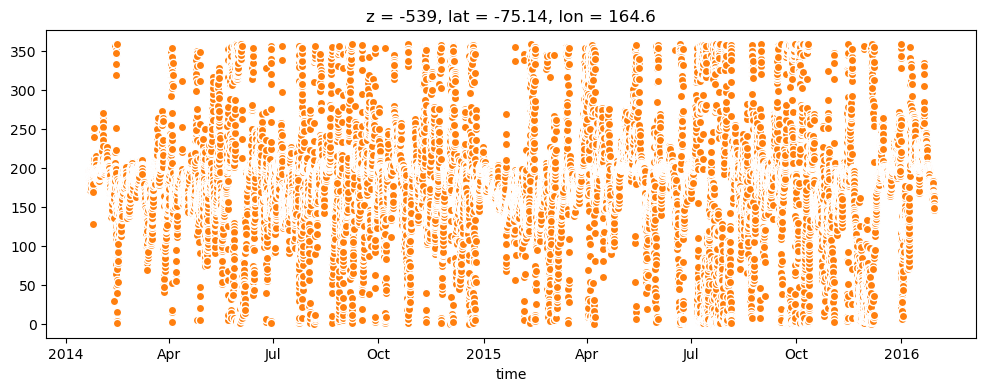

In [63]:
fig = plt.figure(figsize=(12,4))
true_dir.plot.scatter(x='time')
new_dir.plot.scatter(x='time')


In [ ]:
magnetic_declination_radians = np.deg2rad(mag_dec_2014)
u_prime, v_prime = magnetic_declination.rotate_velocity(D_2014_vel_top.U_0,D_2014_vel_top.V_0,-magnetic_declination_radians)
D_2014_vel_top['u'] = u_prime
D_2014_vel_top['v'] = v_prime
D_2014_vel_top['dir'] = new_dir 

### Get other data 

In [53]:
df.query("mooring == 'DITN' & position == 'mid' & instrument == 'ctd'")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
135,DITN,2014,ctd,mid,278,"[con, T, P, dep, S, sig_t]",2014-12-12 14:00:00,2015-12-10 07:20:00,0 days 00:10:00,52233.0
145,DITN,2015,ctd,mid,275,"[con, T, P, dep, S, sig_t]",2015-12-14 10:30:00,2017-02-08 17:10:00,0 days 00:10:00,60809.0
155,DITN,2017,ctd,mid,275,"[con, T, P, dep, S, sig_t]",2017-02-09 01:00:00,2018-03-06 12:02:00,0 days 00:02:00,281132.0
167,DITN,2018,ctd,mid,274,"[con, sig_t, dep, P, S, T]",2018-03-12 09:50:00,2019-01-04 01:10:00,0 days 00:05:00,85721.0
176,DITN,2019,ctd,mid,271,"[con, T, P, S]",2019-01-07 08:20:00,2020-03-17 05:50:00,0 days 00:02:00,309061.0
186,DITN,2020,ctd,mid,269,"[con, T, P, S]",2020-03-18 09:35:00,2022-03-15 13:55:00,0 days 00:05:00,209429.0


In [54]:
# lowest temporal frequency is 10 minutes so will resample to that 
years = ['2017','2018','2019','2020']

In [58]:
DITN_2017_ctd_mid = dt['DITN']['2017']['ctd']['mid'].to_dataset().resample(time='10min').mean()

In [61]:
ds_list = [dt['DITN']['2014']['ctd']['mid'].to_dataset(),dt['DITN']['2015']['ctd']['mid'].to_dataset(),DITN_2017_ctd_mid] 

In [63]:
DITN_glaciology_final = xr.concat(ds_list,dim='time')

C:\Users\mblan\AppData\Local\Temp\ipykernel_7892\2853760450.py:1: FutureWarning: In a future version of xarray the default value for coords will change from coords='different' to coords='minimal'. This is likely to lead to different results when multiple datasets have matching variables with overlapping values. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set coords explicitly.
  DITN_glaciology_final = xr.concat(ds_list,dim='time')


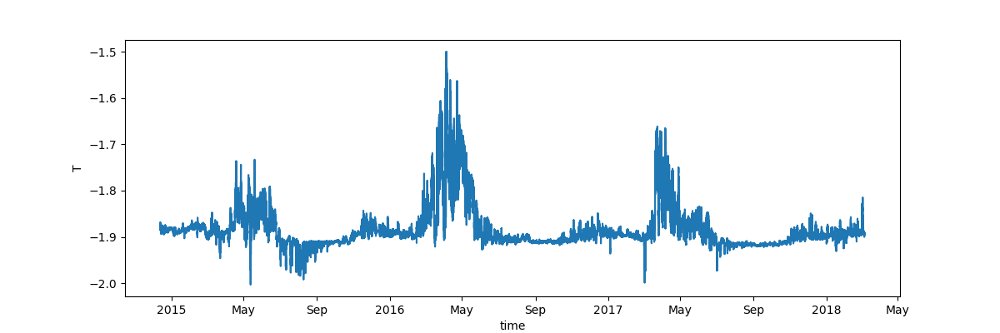

In [78]:
fig = plt.figure(figsize=(12,4))
DITN_glaciology_final.T.plot()

In [66]:
df.query("mooring == 'DITS' ")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
194,DITS,2017,ctd,bot,1088,"[con, T, P, dep, S, sig_t]",2017-02-12 12:00:00,2018-03-08 14:10:00,0 days 00:05:00,112059.0
195,DITS,2017,ctd,mid,383,"[con, T, P, dep, S, sig_t]",2017-02-12 12:00:00,2018-03-08 14:10:00,0 days 00:05:00,112059.0
196,DITS,2017,ctd,top,192,"[con, T, P, dep, S, sig_t]",2017-02-12 12:00:00,2018-03-08 14:10:00,0 days 00:05:00,112059.0
197,DITS,2017,speed,bot,1087,"[dirt, spe]",2017-02-12 13:00:00,2018-03-08 14:00:00,0 days 01:00:00,9338.0
198,DITS,2017,speed,mid,384,"[dirt, spe]",2017-02-12 13:00:00,2018-03-08 14:00:00,0 days 01:00:00,9338.0
199,DITS,2017,speed,top,191,"[dirt, spe]",2017-02-12 13:00:00,2018-03-08 14:00:00,0 days 01:00:00,9338.0
200,DITS,2017,temp,bot,353,[T],2017-02-12 12:00:00,2017-11-10 19:43:20,0 days 00:00:10,2344221.0
201,DITS,2017,temp,mid1,273,[T],2017-02-12 12:00:00,2017-11-10 19:43:20,0 days 00:00:10,2344221.0
202,DITS,2017,temp,mid2,313,[T],2017-02-12 12:00:00,2017-11-10 19:43:20,0 days 00:00:10,2344221.0
203,DITS,2017,temp,top,233,[T],2017-02-12 12:00:00,2017-11-10 19:43:20,0 days 00:00:10,2344221.0


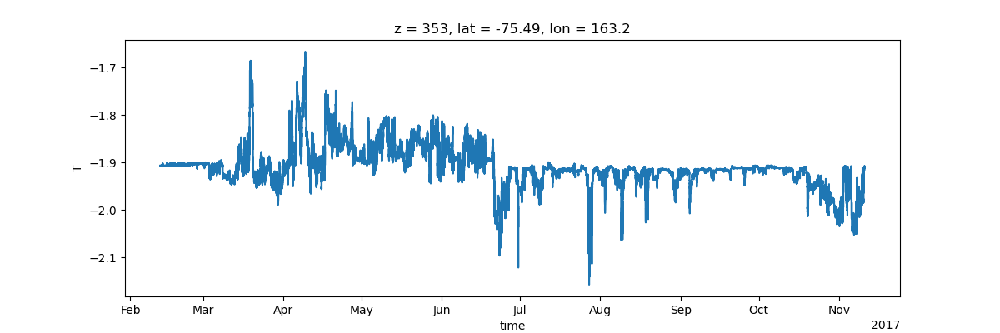

In [75]:
fig = plt.figure(figsize=(12,4))
dt['DITS']['2017']['temp']['bot'].to_dataset().T.plot()

In [76]:
df.query("mooring == 'LDEO' ")

,mooring,year,instrument,position,depth,variables,time_start,time_end,sampling_period,n_points
214,LDEO,2017,vel,bot,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 08:15:00,0 days 00:15:00,38094.0
215,LDEO,2017,vel,mid,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 08:15:00,0 days 00:15:00,38098.0
216,LDEO,2017,vel,top,NaN,"[east, north, up, pressure]",2017-02-01 12:00:00,2018-03-05 10:45:00,0 days 00:15:00,38108.0


In [77]:
DITN_glaciology_final.to_netcdf('DITN_glaciology_final.nc')